In [11]:
from utils import *
import numpy as np
import matplotlib.pyplot as plt
import tqdm
import load_data
from Project_Models import RNN_Model, LSTM_Model
import torch
import torch.nn as nn

print("current device:", torch.cuda.get_device_name(torch.cuda.current_device()))

def normalize(x):
    """ normalize data of each column """
    maxtensor = x.max(0, keepdim=True)[0]
    maxtensor[maxtensor==0] = 1e-4
    x_normed = x / maxtensor
    return x_normed, maxtensor

def standardize(x):
    mean = x.mean(0, keepdim=True)[0]
    mean[mean==0] = 1e-4
    std  = x.std(0, keepdim=True)[0]
    std[std==0] = 1e-4
    x_normed = (x - mean) / std
    return x_normed, mean, std

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
df = load_data.load_county_level('./data/covid19-severity-prediction/data').head(1620).sample(frac=1, random_state=1)

def to_numpy(x):
    """Convert a PyTorch tensor to NumPy."""
    return x.squeeze().detach().cpu().numpy()

def to_torch(x, device='cpu'):
    return torch.tensor(x).unsqueeze(-1).to(device).float()

FEATURES = [
    '#Hospitals', 
    '#ICU_beds', 
    'MedicareEnrollment,AgedTot2017', 
    'DiabetesPercentage', 
    'HeartDiseaseMortality',
    'StrokeMortality',
    'Smokers_Percentage',
    'RespMortalityRate2014',
    '#FTEHospitalTotal2017',
    "TotalM.D.'s,TotNon-FedandFed2017",
    '#HospParticipatinginNetwork2017']

current device: GeForce RTX 3080
loading county-level data...
loaded and merged COVID-19 cases/deaths data successfully


In [10]:
maxload = 1600 #

x = form_input_tensor(df, FEATURES,
    maxload=maxload).to(device)
for i in range(x.shape[1] - 1, 0, -1):
    x[:,i,-2] -= x[:,i-1,-2]
    x[:,i,-1] -= x[:,i-1,-1]

In [12]:
x, xmean, xstd = standardize(x)
# x[torch.isnan(x)] = 0
print(f"#x nan: {(torch.sum(torch.isnan(x)))}")
# print("x:", x)

# y = form_labels_tensor(df, maxload=maxload).to(device)

# for i in range(y.shape[1] - 1, 0, -1):
#     y[:,i,-2] -= y[:,i-1,-2]
#     y[:,i,-1] -= y[:,i-1,-1]

# y, ymean, ystd = standardize(y)
# print(f"#y nan: {torch.sum(torch.isnan(y))}")
# print("y:", y * ymaxtensor)

Xtrain = x[:-50]
# Ytrain = y[:-50]
Xtest  = x[90:]
# Ytest  = y[90:]

#x nan: 0


In [13]:
import torch
import torch.nn as nn

class Residual(nn.Module):
    def __init__(self, input_size):
        super().__init__()
        self.linear1 = nn.Linear(input_size, input_size)
        self.linear2 = nn.Linear(input_size, input_size)
        self.relu = nn.ReLU()

    def forward(self, x):
        out = self.relu(self.linear1(x))
        out = self.relu(self.linear2(out) + x)
        return out

class Encoder(nn.Module):
    def __init__(self, input_size, latent_size):
        super().__init__()
        self.linear1 = nn.Linear(input_size, 32)
        self.res1    = Residual(32)
        self.res2    = Residual(32)
        self.linear2 = nn.Linear(32, latent_size)
        self.activation = nn.ReLU()

    def forward(self, x):
        latent = self.activation(self.linear1(x))
        latent = self.res1(self.res2(latent))
        latent = self.activation(self.linear2(latent))
        return latent

class Decoder(nn.Module):
    def __init__(self, hidden_size):
        super().__init__()
        # case head
        self.caseRes1 = Residual(hidden_size)
        self.caseRes2 = Residual(hidden_size)
        # self.caseRes3 = Residual(hidden_size)
        # self.caseRes4 = Residual(hidden_size)
        self.caseout  = nn.Linear(hidden_size, 1)
        # death head
        self.deathRes1 = Residual(hidden_size)
        self.deathRes2 = Residual(hidden_size)
        # self.deathRes3 = Residual(hidden_size)
        # self.deathRes4 = Residual(hidden_size)
        self.deathout  = nn.Linear(hidden_size, 1)
    
    def forward(self, out):

        # case head
        case = self.caseRes1(out)
        case = self.caseRes2(case)
        # case = self.caseRes3(case)
        # case = self.caseRes4(case)
        case = self.caseout(case)

        # res block 1
        d  = self.deathRes1(out)
        d  = self.deathRes2(d)
        # d  = self.deathRes3(d)
        # d  = self.deathRes4(d)
        d = self.deathout(d)
        return torch.hstack((case, d))

class LSTM(nn.Module):

    def __init__(self, input_size, hidden_size, latent_size, num_layers):
        super().__init__()
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.num_layers = num_layers
        self.hidden_size = hidden_size

        self.lstm = nn.LSTM(2, hidden_size, num_layers, batch_first=True)
        self.encoder = Encoder(input_size - 2, latent_size)
        self.decoder = Decoder(hidden_size + latent_size)

    def forward(self, x):
        """ x.shape = (batchsize, days, features)"""
        feat = x[:,-1,:-2]
        ys   = x[:,:,-2:]
        # encoder
        latent = self.encoder(feat)
        # recurrent
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(self.device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(self.device)
        out, _ = self.lstm(ys, (h0, c0))
        out = out[:, -1, :]
        out = torch.cat((out, latent), dim=1)
        # decoder
        return self.decoder(out)

# class RNN(nn.Module):
#     def __init__(self, input_size, hidden_size, num_layers):
#         super().__init__()
#         self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
#         self.num_layers = num_layers
#         self.hidden_size = hidden_size
#         self.rnn = nn.RNN(input_size, hidden_size, num_layers, batch_first=True)
#         self.decoder = Decoder(hidden_size)
#     def forward(self, x):
#         h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(self.device)
#         out, _ = self.rnn(x, h0)
#         out = out[:, -1, :]
#         return self.decoder(out)

In [14]:
def trainModel(model, batchsize, lr, epochs):
    print("training data shape:", Xtrain.shape)
    # criterion = lambda y, yhat: torch.sqrt(nn.MSELoss()(y, yhat))
    criterion = nn.MSELoss()
    # criterion = nn.SmoothL1Loss()
    learning_rate = lr
    num_epoches = epochs
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    # scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=6, verbose=True)
    trange = tqdm.trange(num_epoches)
    for epoch in trange:
        for start in range(0, Xtrain.shape[0], batchsize):
            batch_start = start
            batch_end = min(start + batchsize, Xtrain.shape[0])
            for i in range(1, Xtrain.shape[1]):
                yhat = model(Xtrain[batch_start:batch_end,:i,:])
                loss = criterion(yhat, Xtrain[batch_start:batch_end,i,-2:])
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
                # scheduler.step(loss.item())
                trange.set_description(f'Epoch [{epoch + 1}/{num_epoches}], Batch [{int(start/batchsize)}/{int(Xtrain.shape[0]/batchsize)}] Loss: {loss.item():.4f}')
                trange.refresh()
    return model

def plotPrediction(model, countyname, statename, plot=True):
    orange = df[(df['StateName'] == statename) & (df['CountyName'] == countyname)]
    x = form_input_tensor(orange, FEATURES, maxload=maxload).to(device)
    truey = x[:, :, -2:]
    for i in range(x.shape[1] - 1, 0, -1):
        x[:,i,-2] -= x[:,i-1,-2]
        x[:,i,-1] -= x[:,i-1,-1]
    xnorm = (x - xmean) / xstd
    x[torch.isnan(x)]=0
    # check if there is nan in x
    # print(f"#x nan: {(torch.sum(torch.isnan(x)))}")

    # print(f"x.shape: {x.shape}")
    # print("x:", x * )
    # y = form_labels_tensor(df, maxload=maxload).to(device)
    # ynorm = (y - ymean) / ystd
    # print(f"#y nan: {torch.sum(torch.isnan(y))}")

    yhat = torch.zeros((x.shape[1], 2), dtype=torch.float32, device='cuda')
    for i in range(1, x.shape[1]):
        yhati = None
        with torch.no_grad():
            xi = xnorm[:,:i,:]
            # print(xi.shape)
            yhati = model(xi)
        # print(yhati.shape)
        # yhati = yhati
        # print(yhati.shape)
        yhat[i] = (yhati)
    # print(yhat)
    yhat = yhat*xstd[:,-2:]+xmean[:,-2:]
    yhat[yhat<0]=0

    truey = to_numpy(truey)
    yhat = to_numpy(yhat)
    if plot:
        plt.figure(figsize=(16,4))
        plt.title(f"{countyname}, {statename}")
        plt.xlabel("day")
        plt.ylabel("count")
        # plt.ylim((0, 70000))
        plt.plot(range(len(truey)),truey[:,0],'r-')
        plt.plot(range(len(truey)),yhat[:,0],'g-')
        # plt.plot(range(len(truey)), np.absolute(truey[:,0]-yhat[:,0]), 'b-')
        
        plt.show()
        plt.figure(figsize=(16,4))
        plt.title(f"{countyname}, {statename}")
        plt.xlabel("day")
        plt.ylabel("count")
        plt.plot(range(len(truey)),truey[:,1],'r-')
        plt.plot(range(len(truey)),yhat[:,1],'g-')
        # plt.plot(range(len(truey)), np.absolute(truey[:,1]-yhat[:,1]), 'b-')
        plt.show()
    msecases = (np.sum((truey[:,0] - yhat[:,0]) ** 2) / len(truey))
    msedeaths= (np.sum((truey[:,1] - yhat[:,1]) ** 2) / len(truey))
    return msecases, msedeaths

In [78]:
lstm = LSTM(13, 64, 128, 3).to('cuda')

In [79]:
trainModel(lstm, batchsize=200, lr=1e-3, epochs=40)

Epoch [40/40], Batch [7/7] Loss: 0.2336: 100%|██████████| 40/40 [58:43<00:00, 88.08s/it]


LSTM(
  (lstm): LSTM(2, 64, num_layers=3, batch_first=True)
  (encoder): Encoder(
    (linear1): Linear(in_features=11, out_features=32, bias=True)
    (res1): Residual(
      (linear1): Linear(in_features=32, out_features=32, bias=True)
      (linear2): Linear(in_features=32, out_features=32, bias=True)
      (relu): ReLU()
    )
    (res2): Residual(
      (linear1): Linear(in_features=32, out_features=32, bias=True)
      (linear2): Linear(in_features=32, out_features=32, bias=True)
      (relu): ReLU()
    )
    (linear2): Linear(in_features=32, out_features=128, bias=True)
    (activation): ReLU()
  )
  (decoder): Decoder(
    (caseRes1): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes2): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
     

In [33]:
trainModel(lstm, batchsize=200, lr=1e-4, epochs=50)

Epoch [50/50], Batch [7/7] Loss: 0.0884: 100%|██████████| 50/50 [1:12:56<00:00, 87.52s/it]


LSTM(
  (lstm): LSTM(2, 64, num_layers=3, batch_first=True)
  (encoder): Encoder(
    (linear1): Linear(in_features=11, out_features=32, bias=True)
    (linear2): Linear(in_features=32, out_features=128, bias=True)
    (activation): ReLU()
  )
  (decoder): Decoder(
    (caseRes1): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes2): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes3): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes4): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, 

In [34]:
trainModel(lstm, batchsize=200, lr=1e-5, epochs=50)

Epoch [50/50], Batch [7/7] Loss: 0.0872: 100%|██████████| 50/50 [1:12:44<00:00, 87.28s/it]


LSTM(
  (lstm): LSTM(2, 64, num_layers=3, batch_first=True)
  (encoder): Encoder(
    (linear1): Linear(in_features=11, out_features=32, bias=True)
    (linear2): Linear(in_features=32, out_features=128, bias=True)
    (activation): ReLU()
  )
  (decoder): Decoder(
    (caseRes1): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes2): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes3): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes4): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, 

In [64]:
torch.save(lstm, "encodecoder_lstm_earlystoped.model")

In [17]:
model = torch.load("encodecoder_lstm_earlystoped.model")
model

LSTM(
  (lstm): LSTM(2, 64, num_layers=3, batch_first=True)
  (encoder): Encoder(
    (linear1): Linear(in_features=11, out_features=32, bias=True)
    (res1): Residual(
      (linear1): Linear(in_features=32, out_features=32, bias=True)
      (linear2): Linear(in_features=32, out_features=32, bias=True)
      (relu): ReLU()
    )
    (res2): Residual(
      (linear1): Linear(in_features=32, out_features=32, bias=True)
      (linear2): Linear(in_features=32, out_features=32, bias=True)
      (relu): ReLU()
    )
    (linear2): Linear(in_features=32, out_features=128, bias=True)
    (activation): ReLU()
  )
  (decoder): Decoder(
    (caseRes1): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes2): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
     

In [20]:
torch.load("encodecoder_lstm.model")

LSTM(
  (lstm): LSTM(2, 64, num_layers=3, batch_first=True)
  (encoder): Encoder(
    (linear1): Linear(in_features=11, out_features=32, bias=True)
    (linear2): Linear(in_features=32, out_features=128, bias=True)
    (activation): ReLU()
  )
  (decoder): Decoder(
    (caseRes1): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes2): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes3): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, bias=True)
      (relu): ReLU()
    )
    (caseRes4): Residual(
      (linear1): Linear(in_features=192, out_features=192, bias=True)
      (linear2): Linear(in_features=192, out_features=192, 

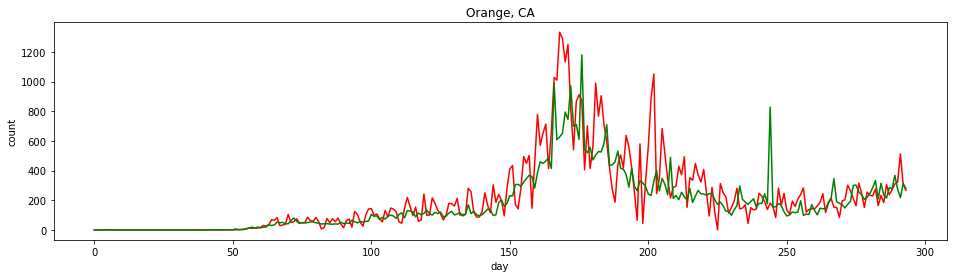

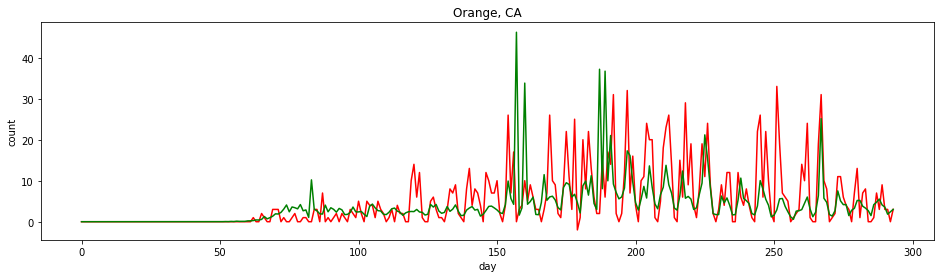

(20609.062925170067, 48.72315117453231)

In [16]:
plotPrediction(model, 'Orange', 'CA')

  0%|          | 0/60 [00:00<?, ?it/s]

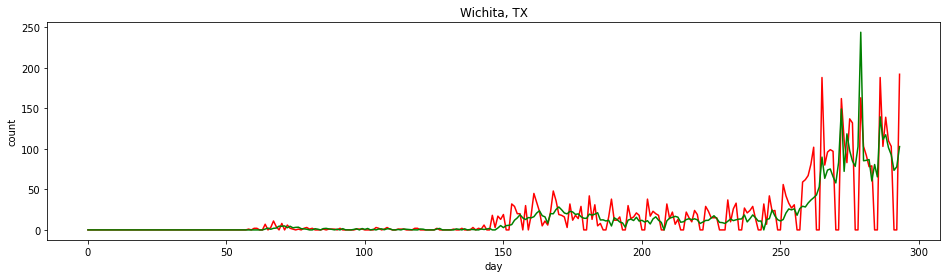

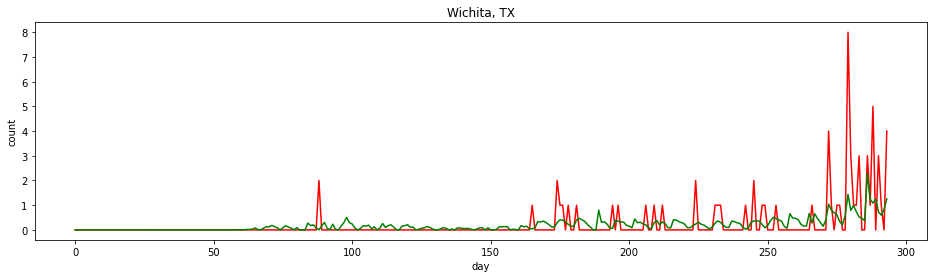

  2%|▏         | 1/60 [00:02<01:59,  2.03s/it]

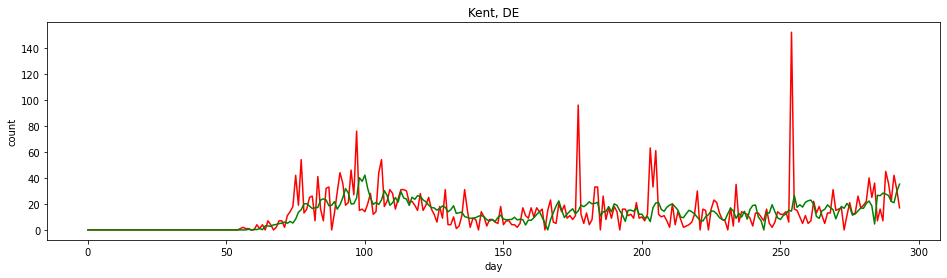

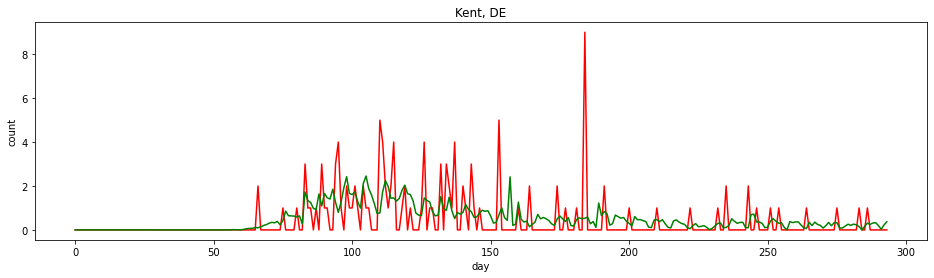

  3%|▎         | 2/60 [00:04<01:58,  2.04s/it]

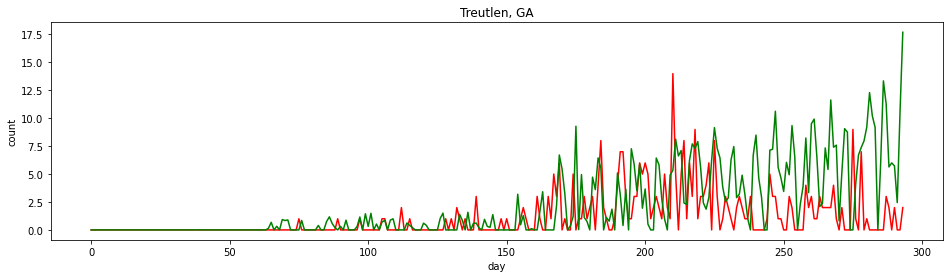

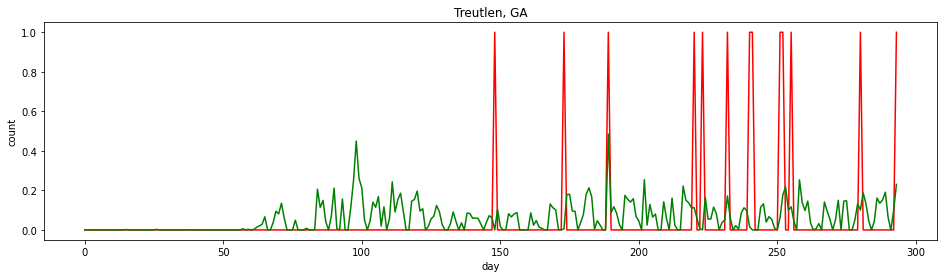

  5%|▌         | 3/60 [00:06<01:55,  2.02s/it]

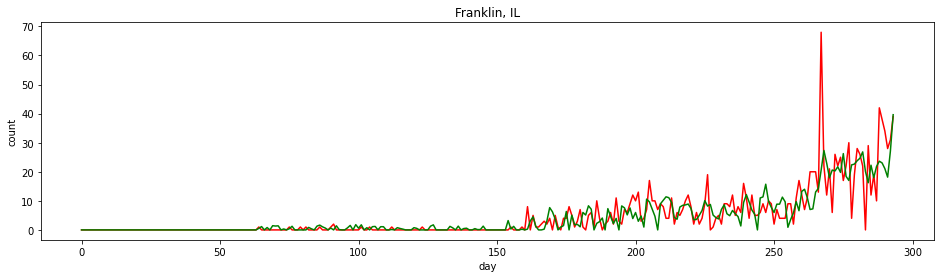

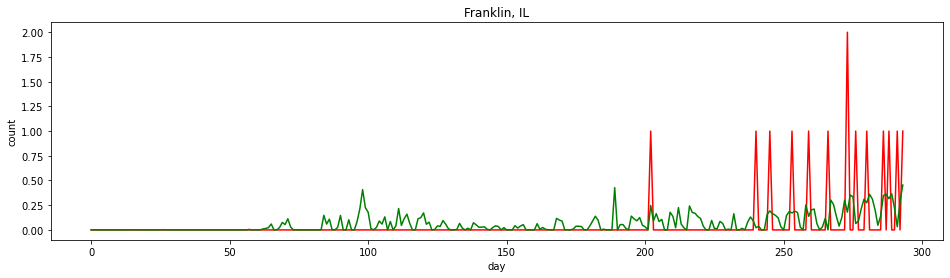

  7%|▋         | 4/60 [00:07<01:50,  1.98s/it]

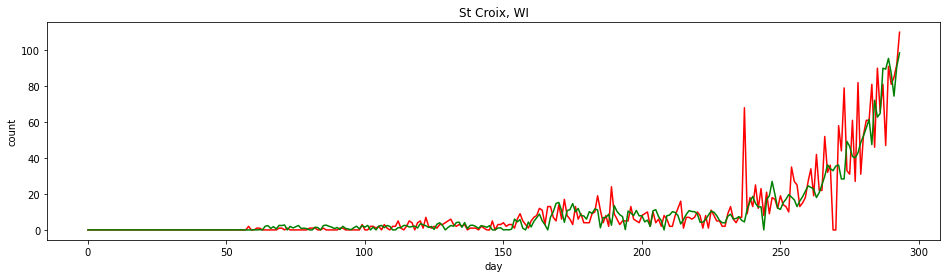

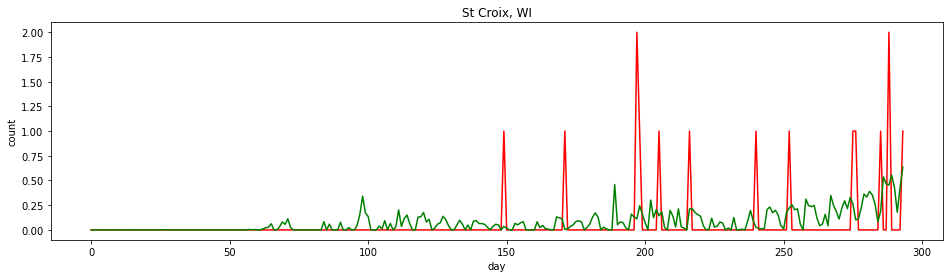

  8%|▊         | 5/60 [00:09<01:47,  1.96s/it]

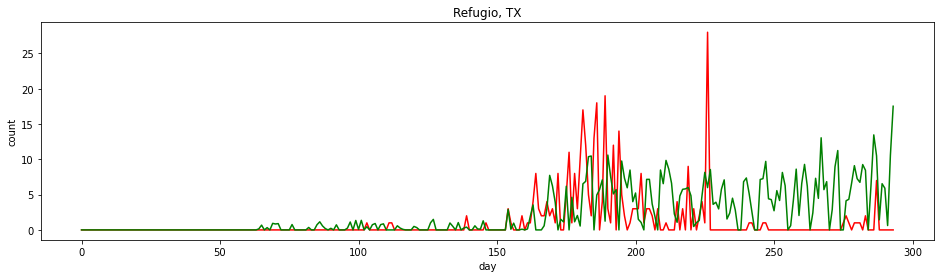

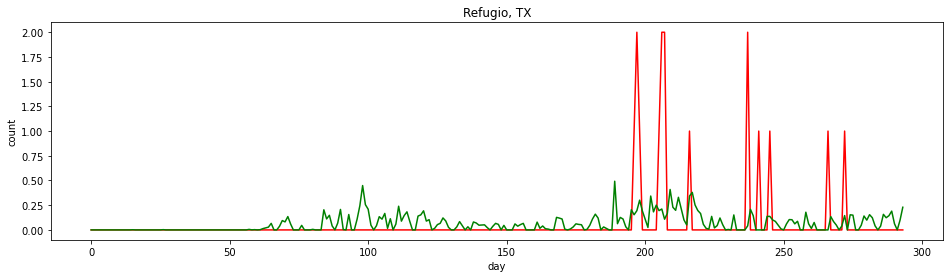

 10%|█         | 6/60 [00:11<01:43,  1.92s/it]

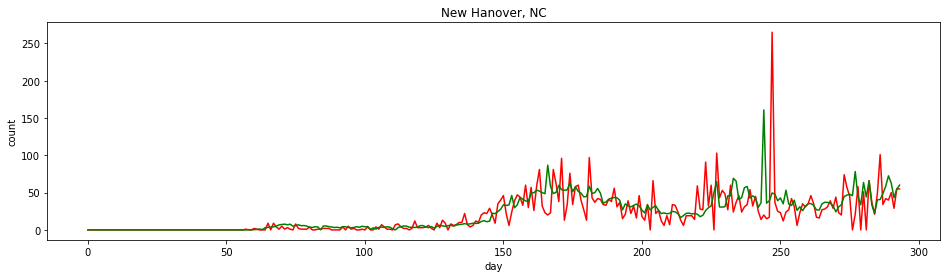

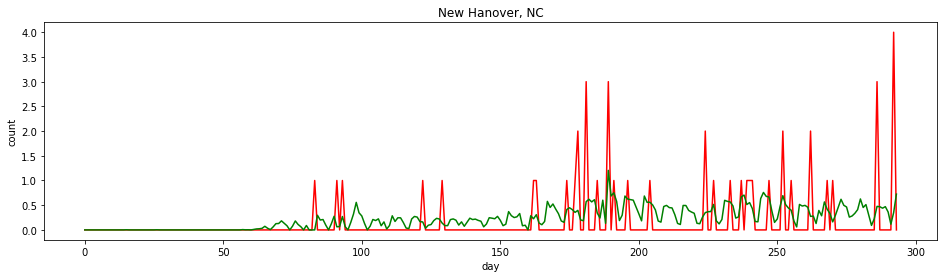

 12%|█▏        | 7/60 [00:13<01:41,  1.92s/it]

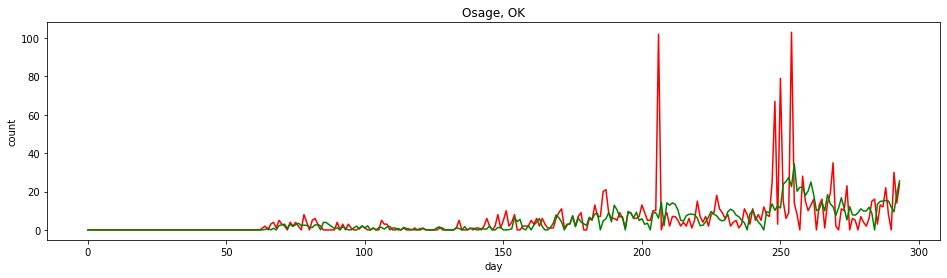

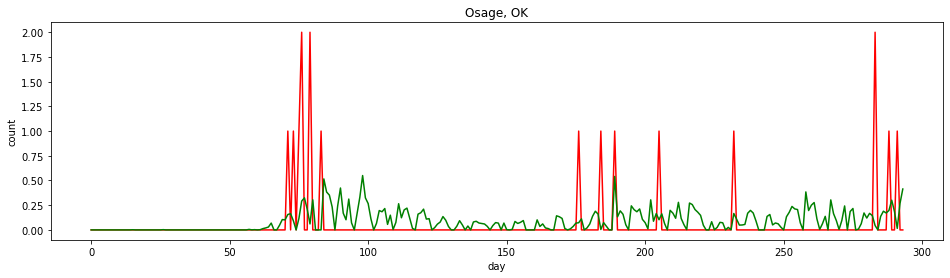

 13%|█▎        | 8/60 [00:15<01:39,  1.92s/it]

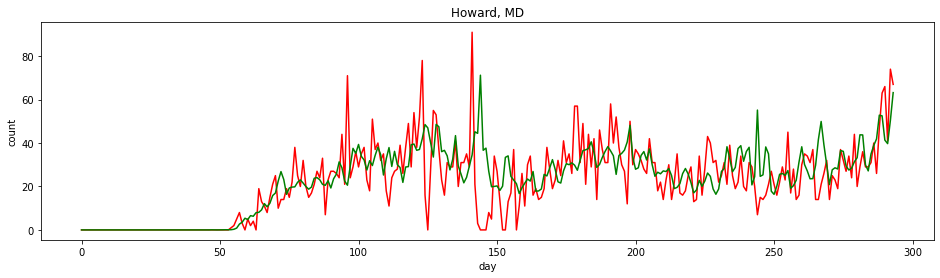

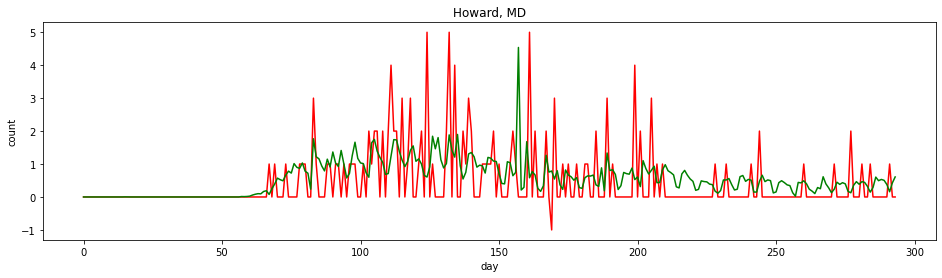

 15%|█▌        | 9/60 [00:17<01:35,  1.88s/it]

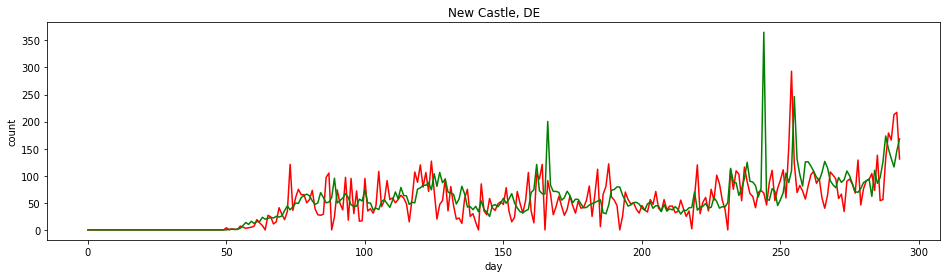

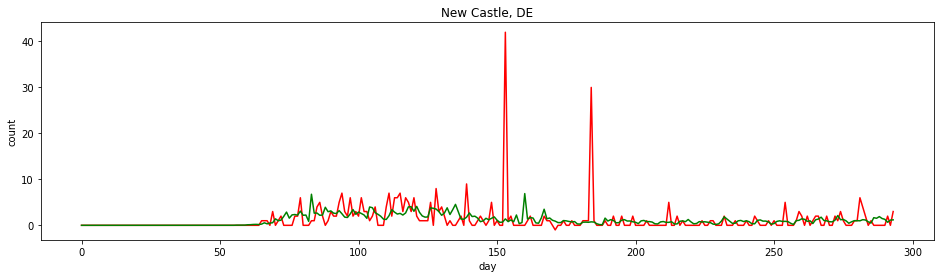

 17%|█▋        | 10/60 [00:19<01:33,  1.86s/it]

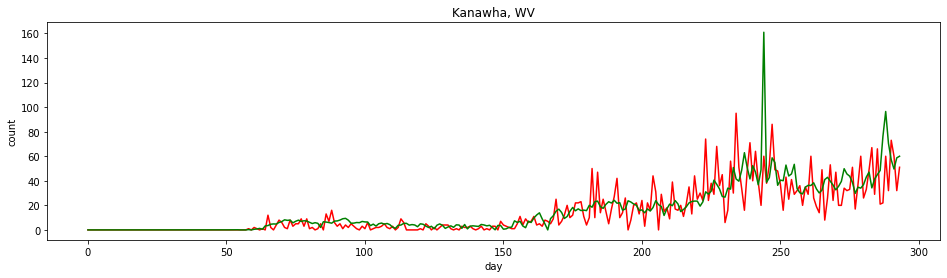

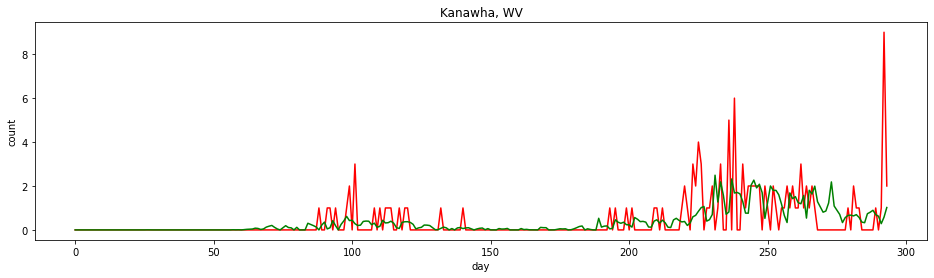

 18%|█▊        | 11/60 [00:21<01:34,  1.92s/it]

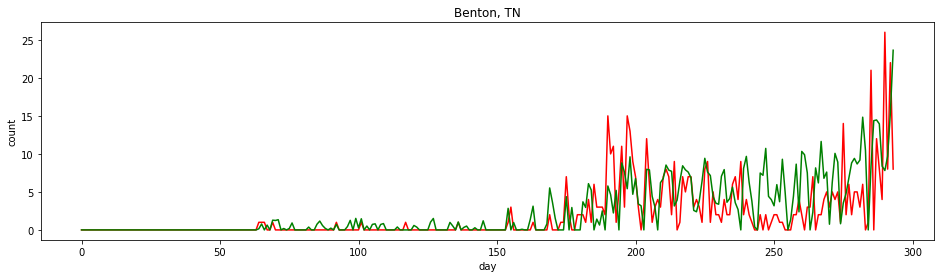

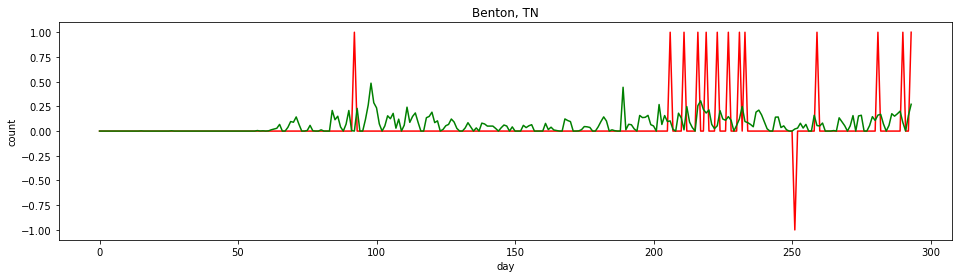

 20%|██        | 12/60 [00:23<01:36,  2.01s/it]

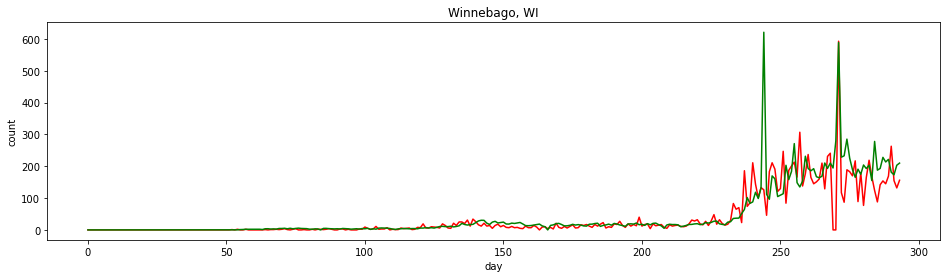

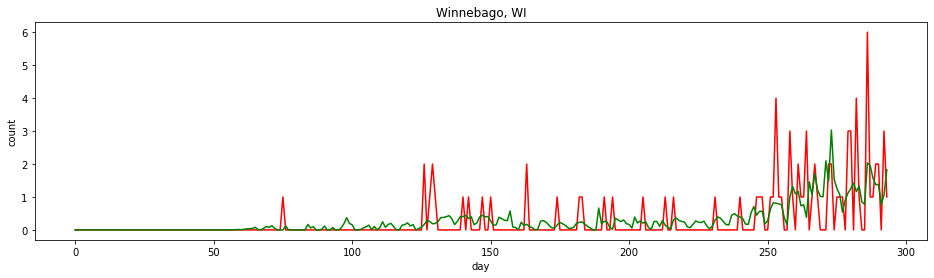

 22%|██▏       | 13/60 [00:25<01:34,  2.01s/it]

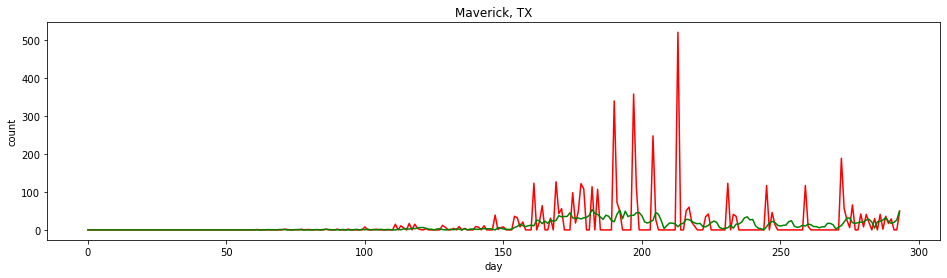

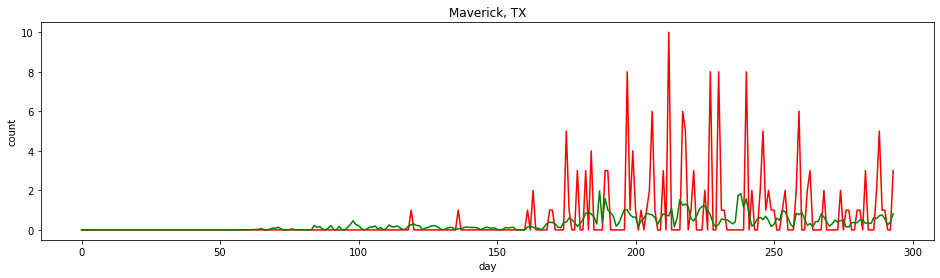

 23%|██▎       | 14/60 [00:27<01:31,  1.99s/it]

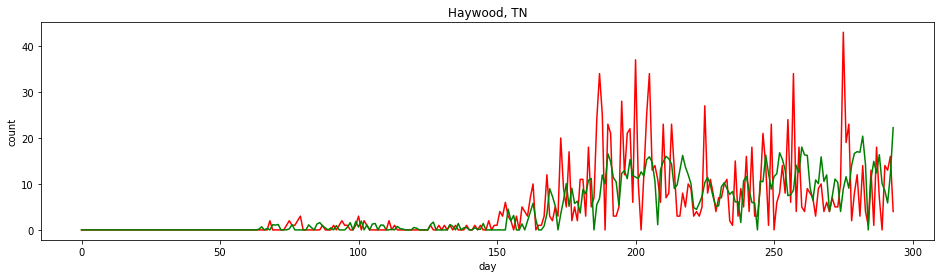

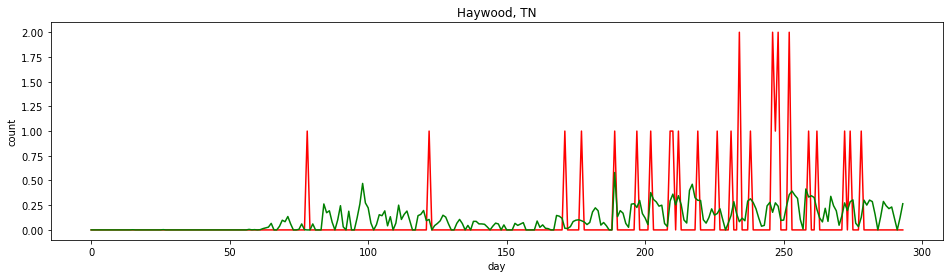

 25%|██▌       | 15/60 [00:29<01:27,  1.95s/it]

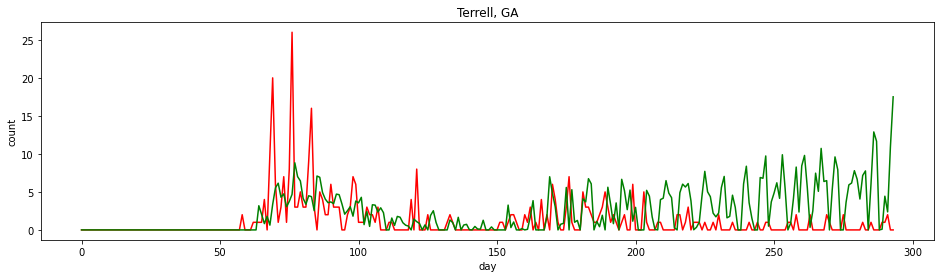

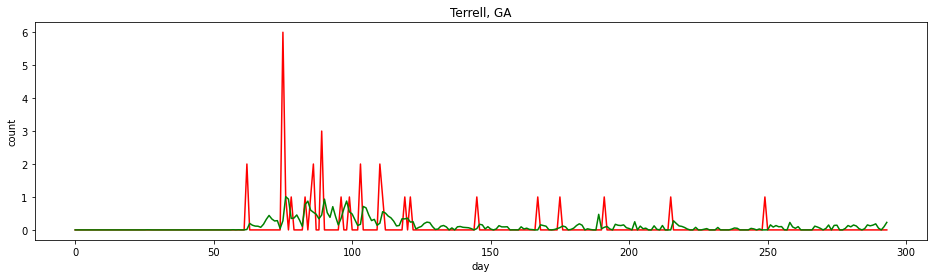

 27%|██▋       | 16/60 [00:31<01:24,  1.93s/it]

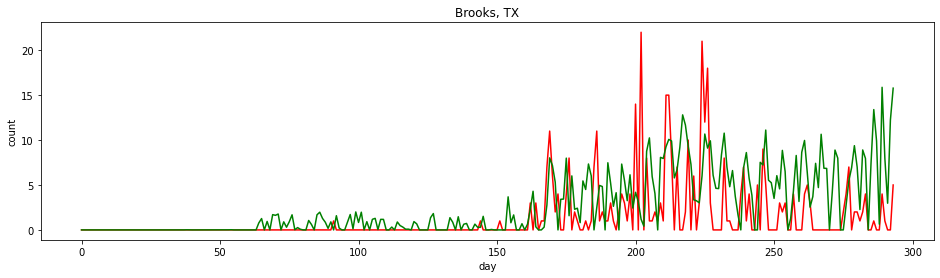

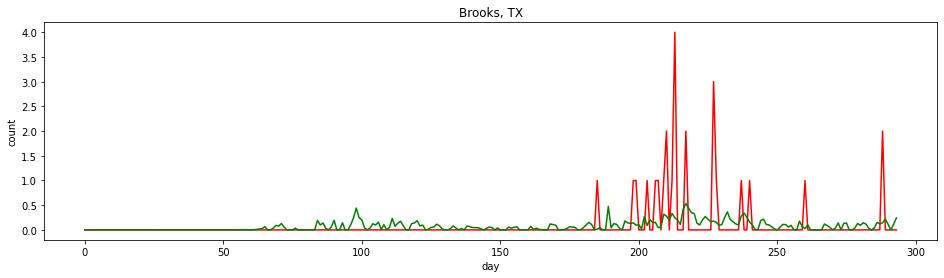

 28%|██▊       | 17/60 [00:32<01:21,  1.90s/it]

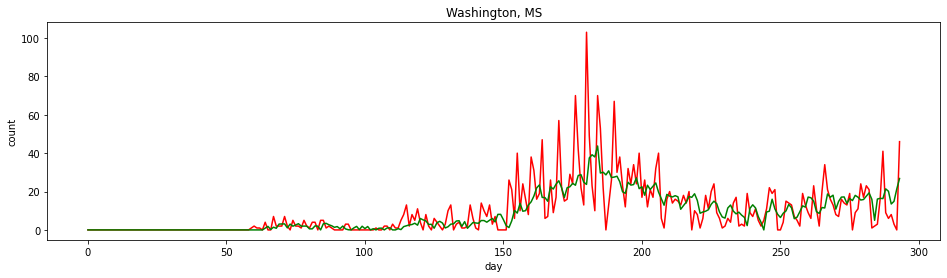

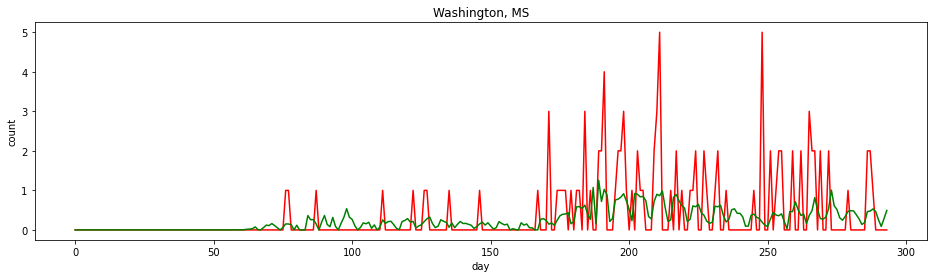

 30%|███       | 18/60 [00:34<01:21,  1.93s/it]

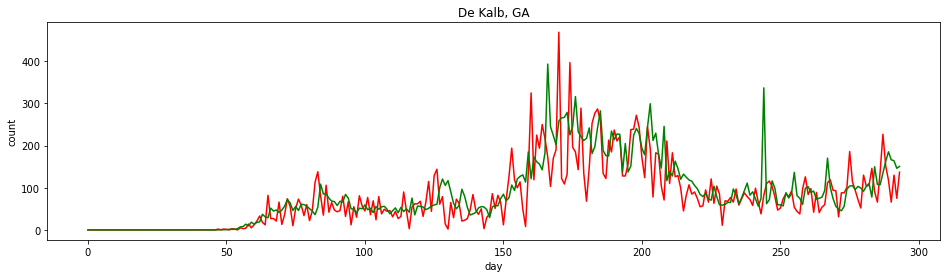

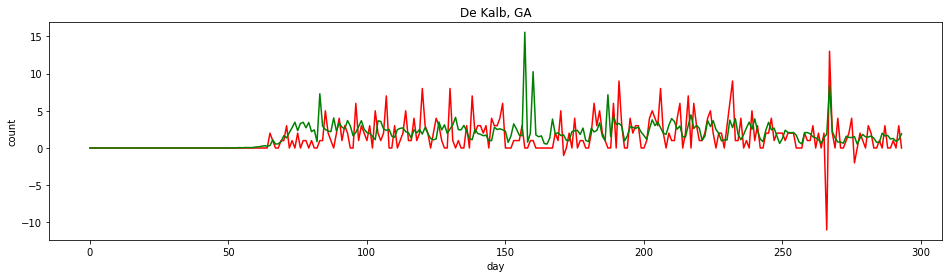

 32%|███▏      | 19/60 [00:36<01:18,  1.91s/it]

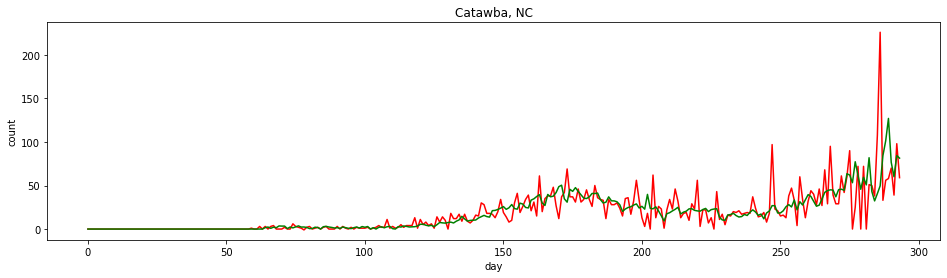

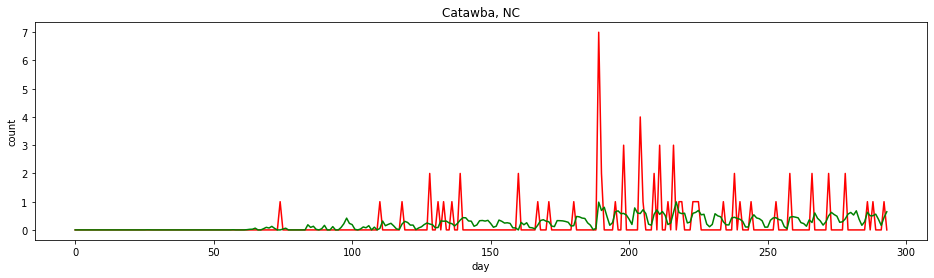

 33%|███▎      | 20/60 [00:38<01:17,  1.94s/it]

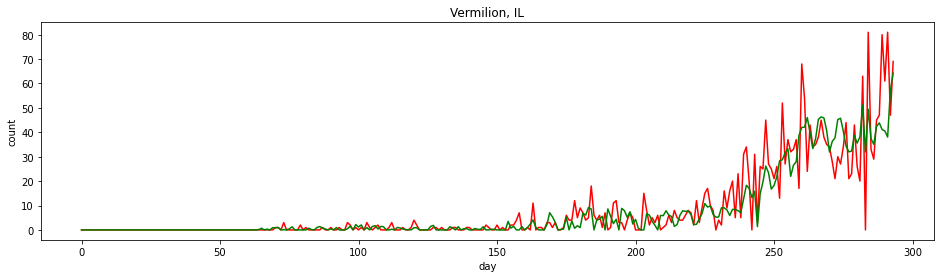

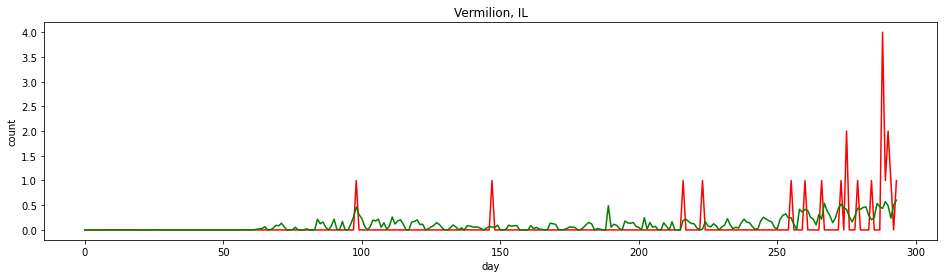

 35%|███▌      | 21/60 [00:40<01:15,  1.93s/it]

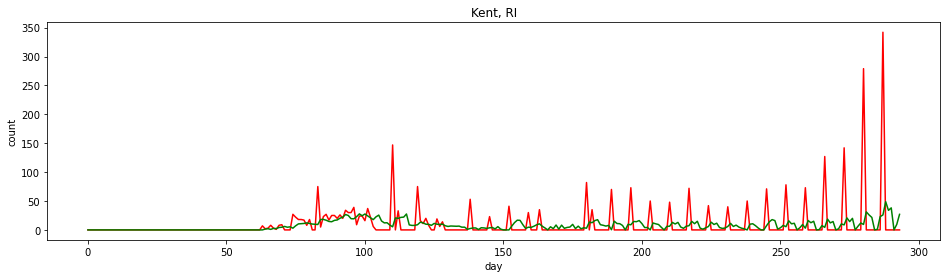

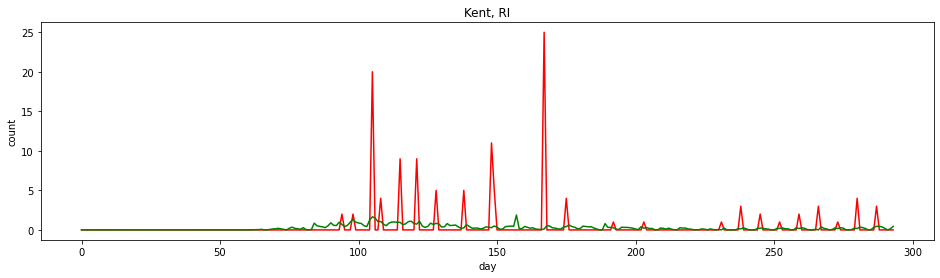

 37%|███▋      | 22/60 [00:42<01:12,  1.92s/it]

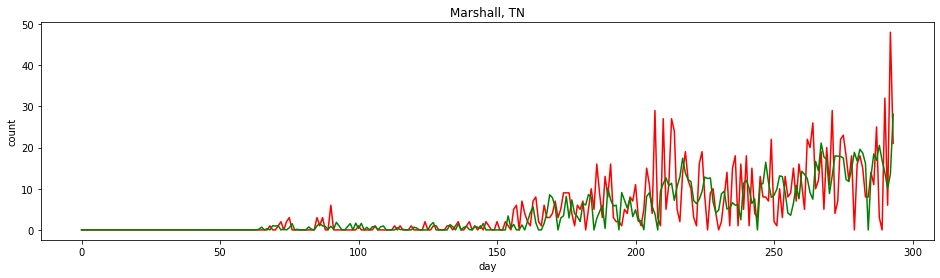

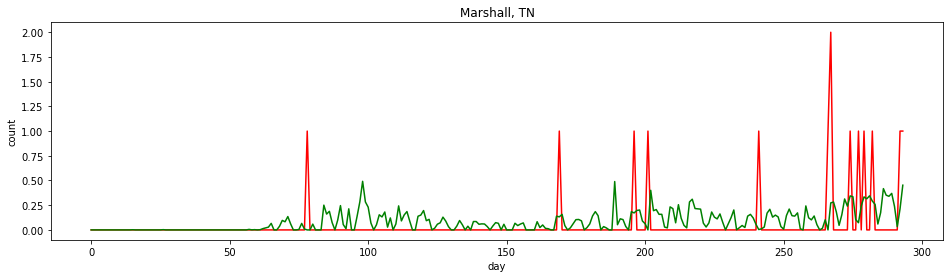

 38%|███▊      | 23/60 [00:44<01:10,  1.91s/it]

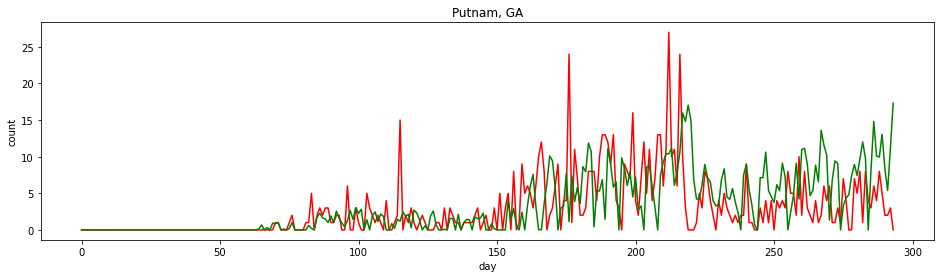

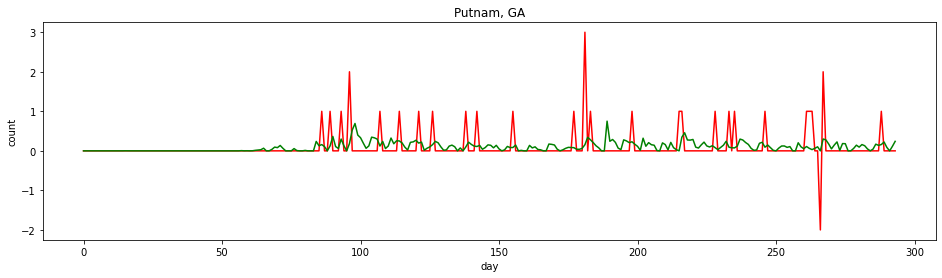

 40%|████      | 24/60 [00:46<01:08,  1.90s/it]

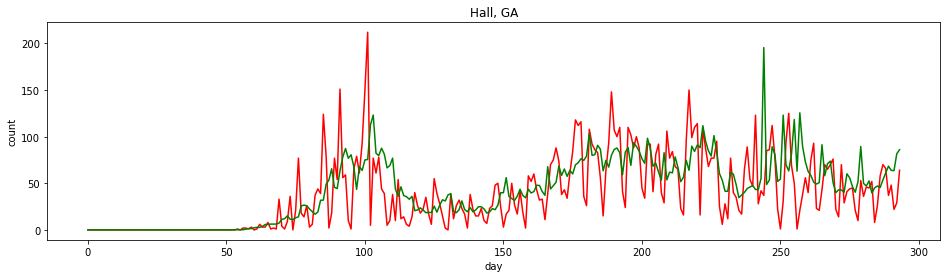

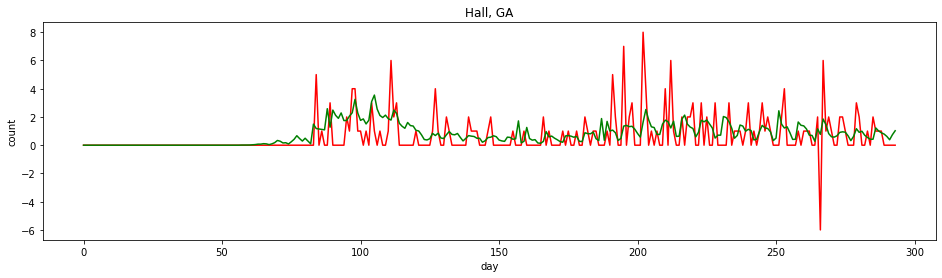

 42%|████▏     | 25/60 [00:48<01:07,  1.92s/it]

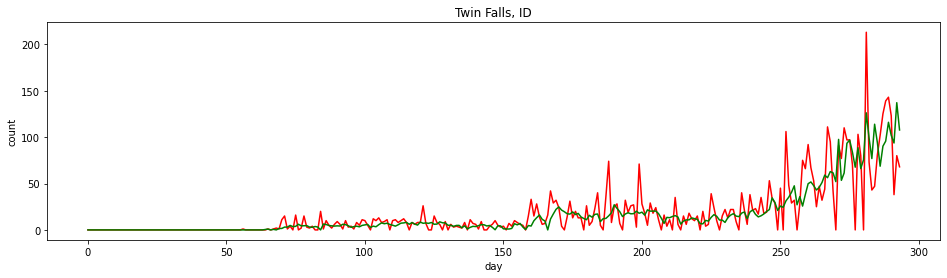

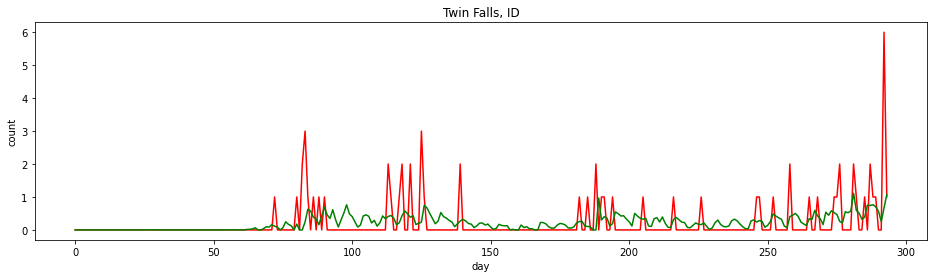

 43%|████▎     | 26/60 [00:50<01:05,  1.93s/it]

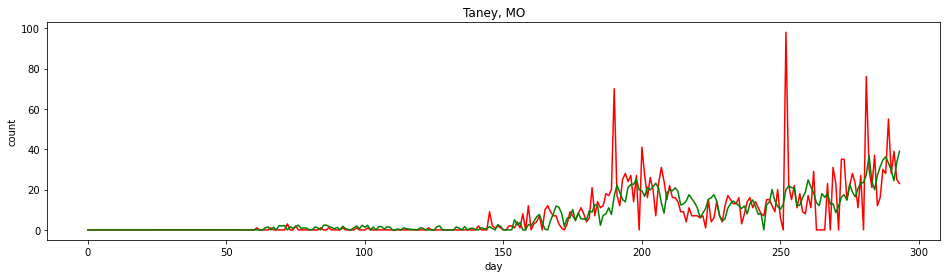

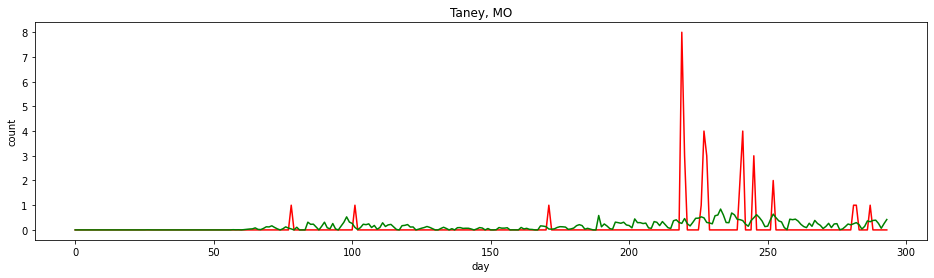

 45%|████▌     | 27/60 [00:52<01:04,  1.94s/it]

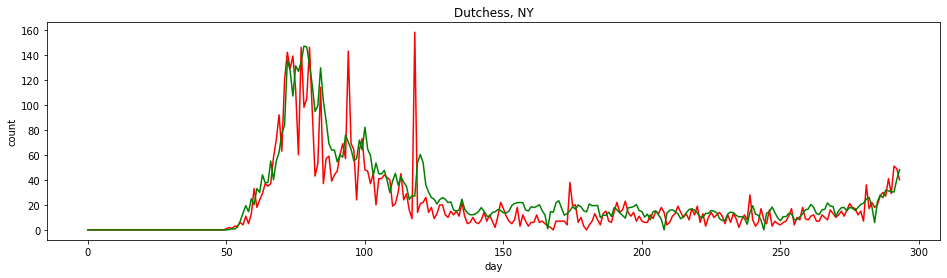

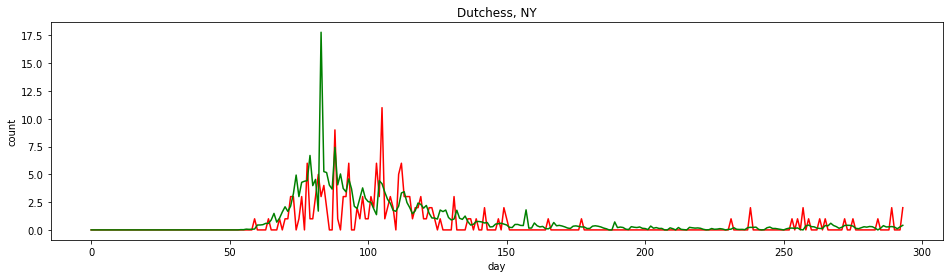

 47%|████▋     | 28/60 [00:54<01:00,  1.90s/it]

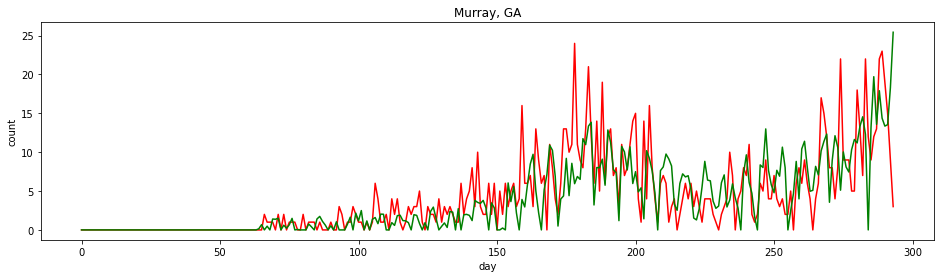

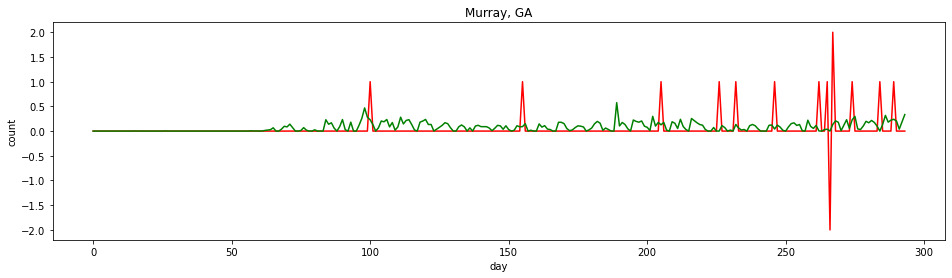

 48%|████▊     | 29/60 [00:56<01:00,  1.94s/it]

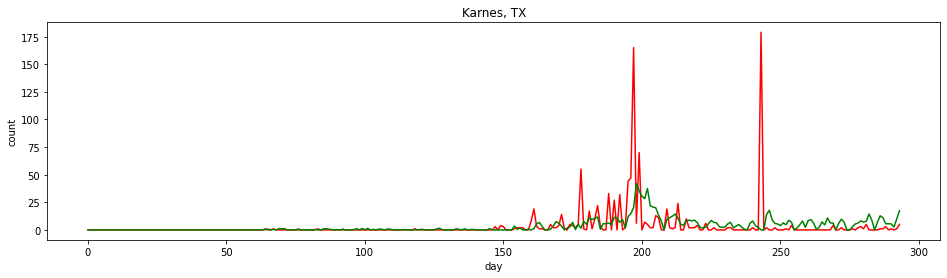

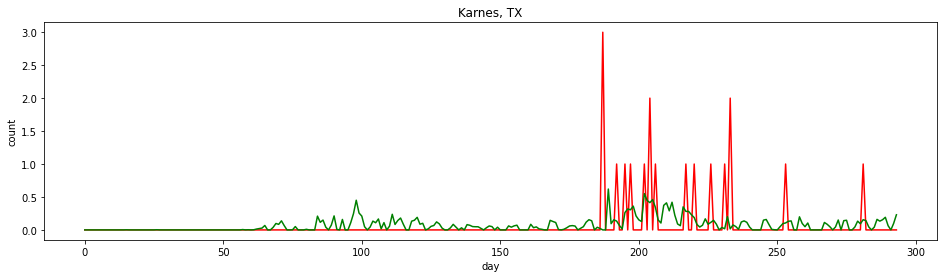

 50%|█████     | 30/60 [00:58<00:59,  2.00s/it]

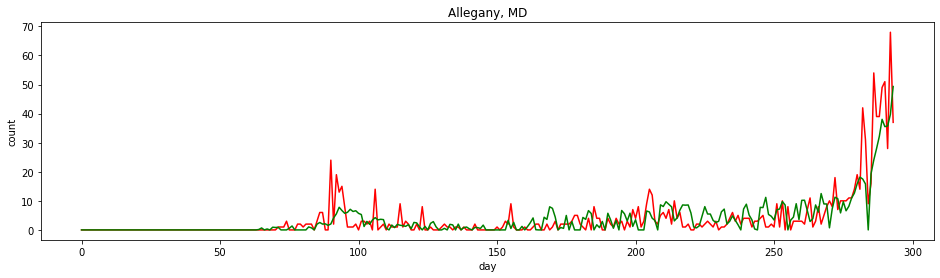

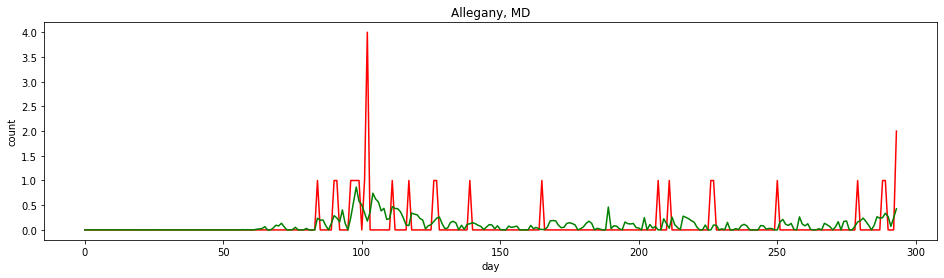

 52%|█████▏    | 31/60 [01:00<00:57,  1.99s/it]

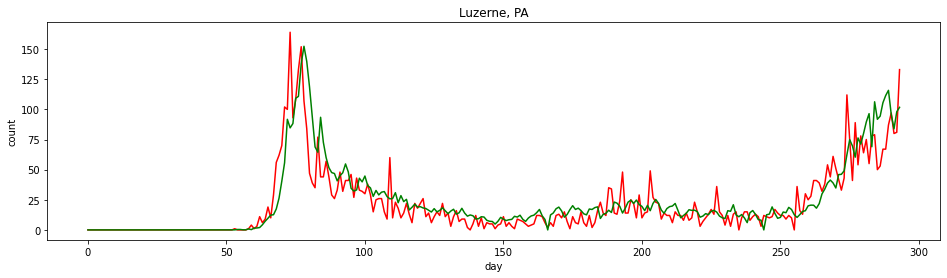

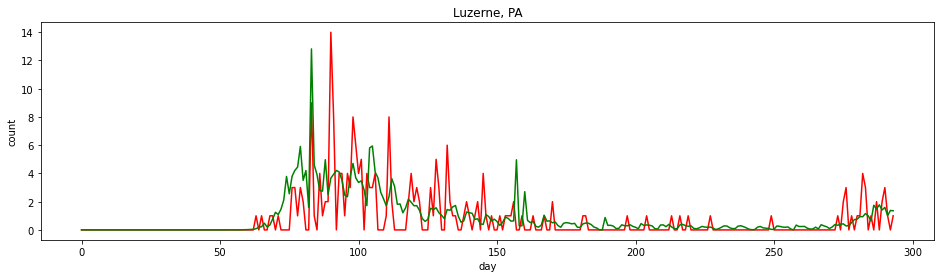

 53%|█████▎    | 32/60 [01:02<00:56,  2.00s/it]

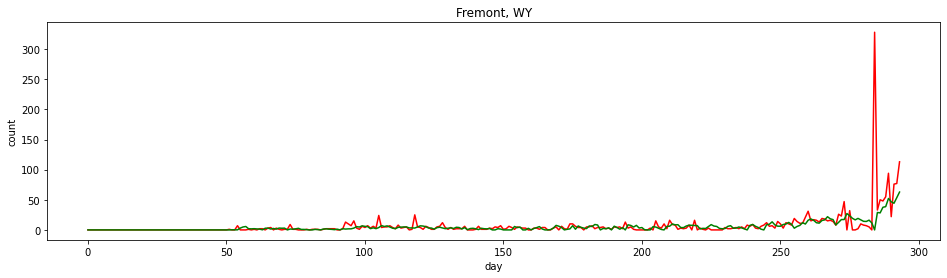

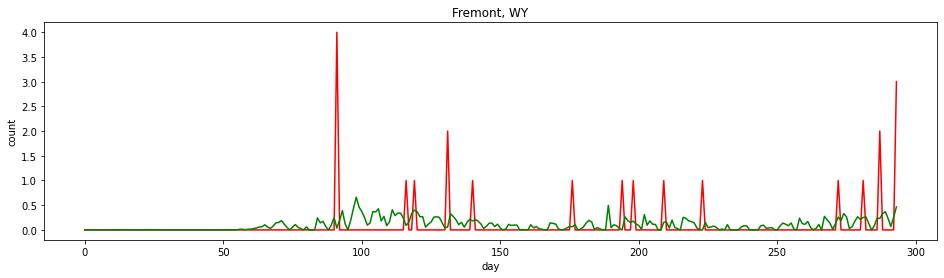

 55%|█████▌    | 33/60 [01:04<00:53,  1.99s/it]

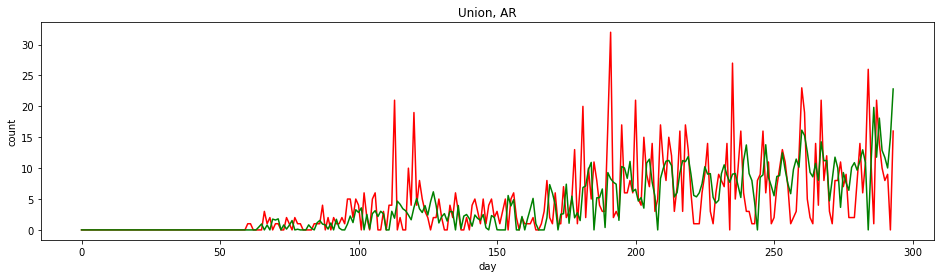

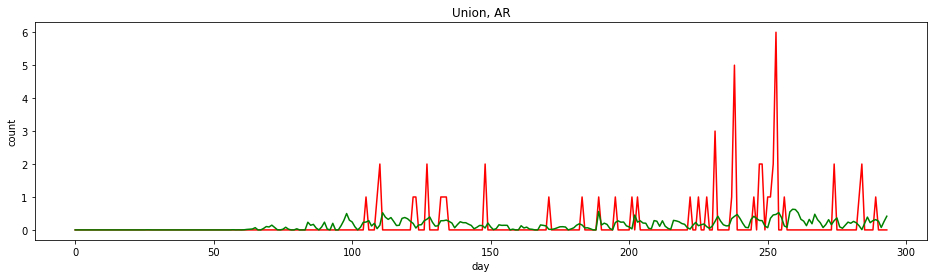

 57%|█████▋    | 34/60 [01:06<00:51,  1.98s/it]

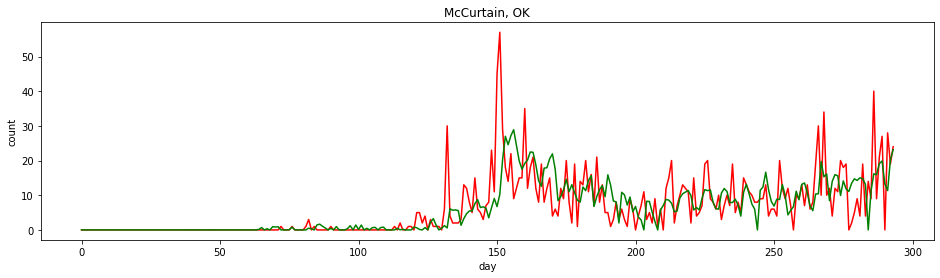

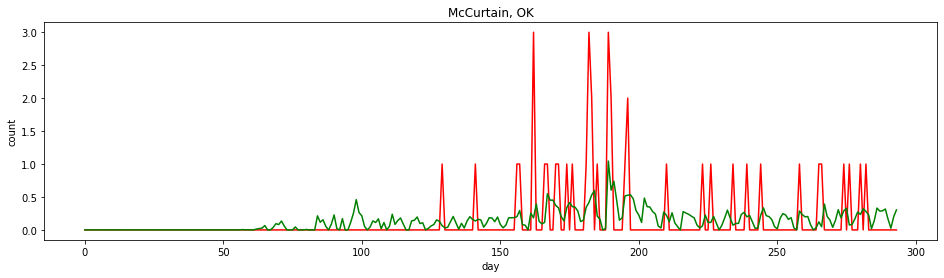

 58%|█████▊    | 35/60 [01:08<00:49,  1.98s/it]

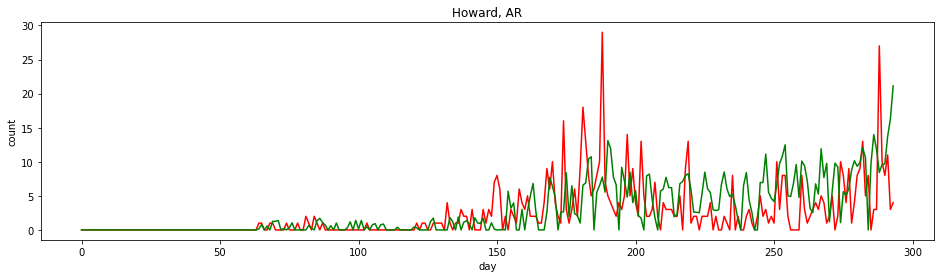

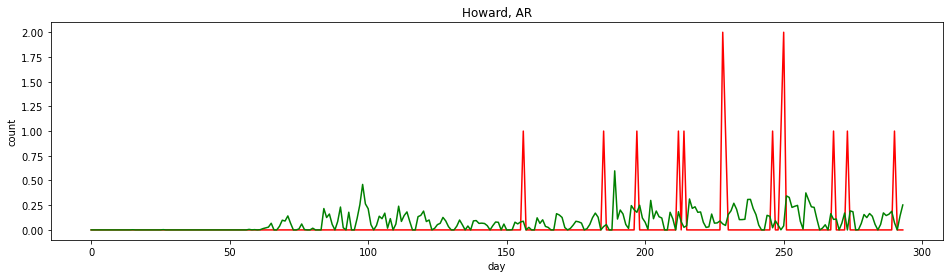

 60%|██████    | 36/60 [01:10<00:47,  1.97s/it]

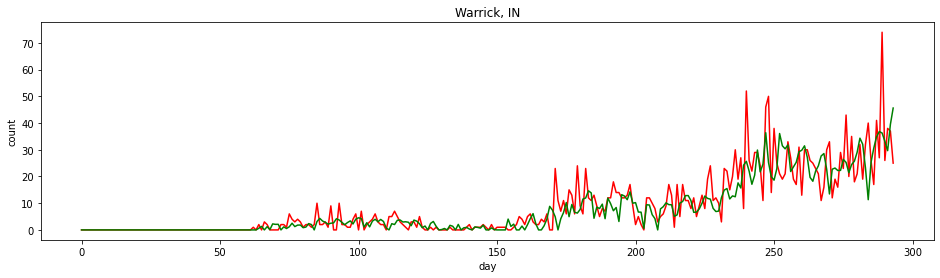

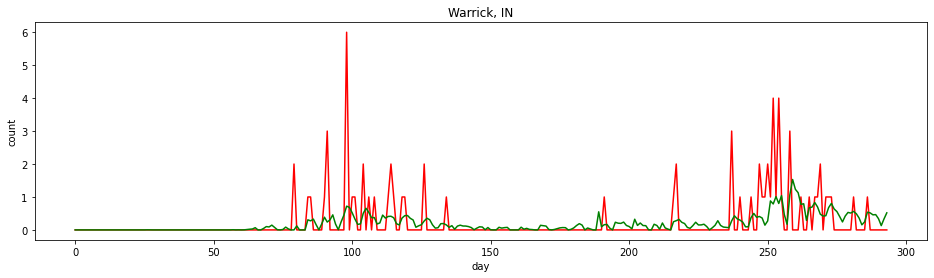

 62%|██████▏   | 37/60 [01:12<00:45,  1.98s/it]

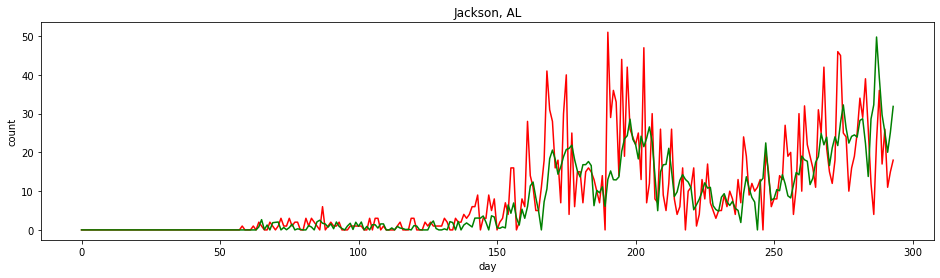

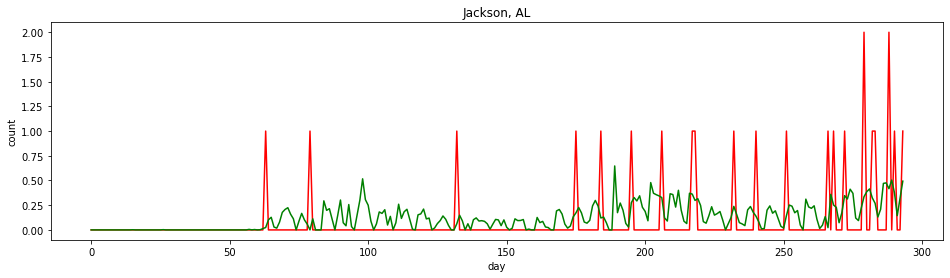

 63%|██████▎   | 38/60 [01:14<00:43,  1.97s/it]

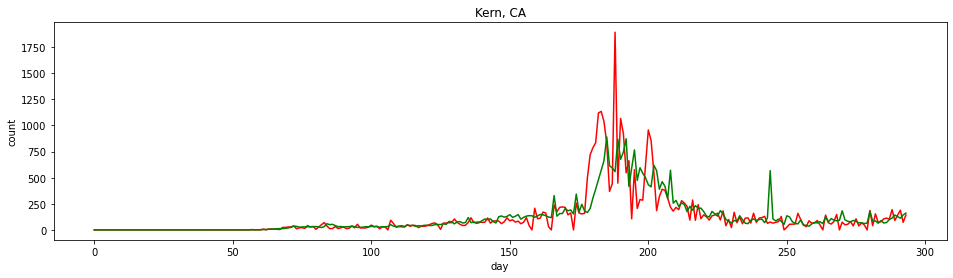

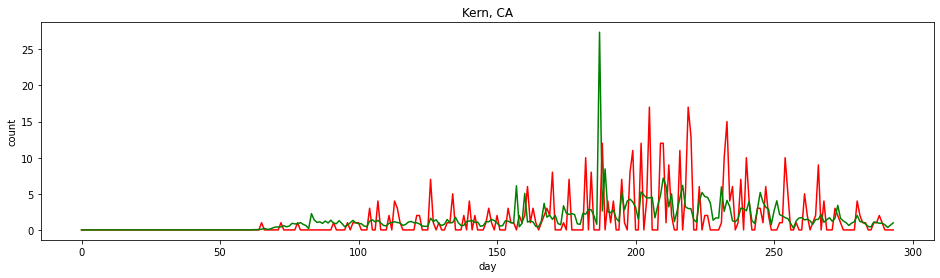

 65%|██████▌   | 39/60 [01:16<00:42,  2.00s/it]

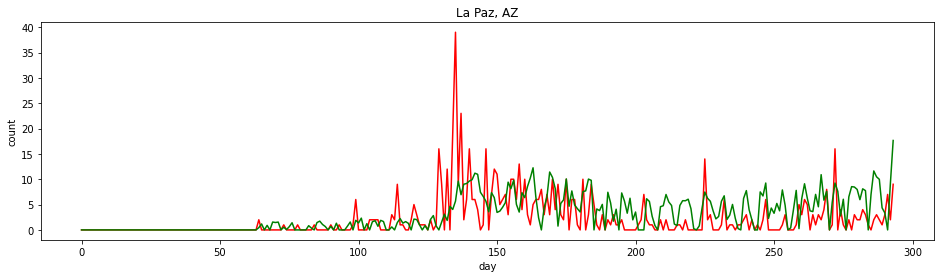

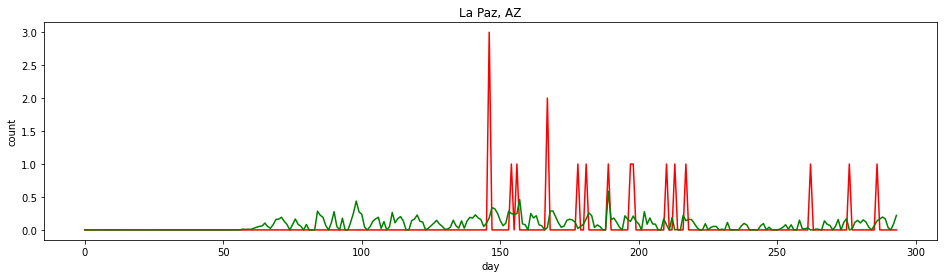

 67%|██████▋   | 40/60 [01:18<00:40,  2.00s/it]

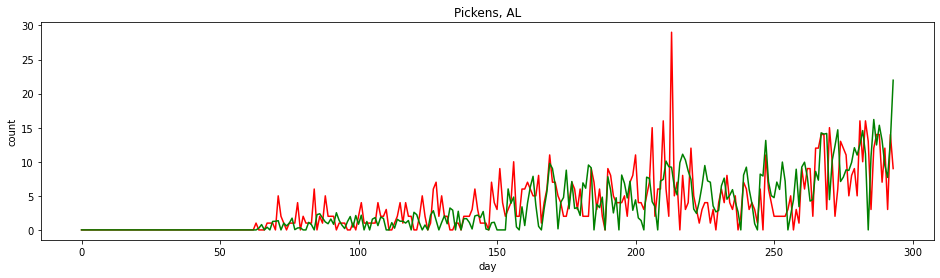

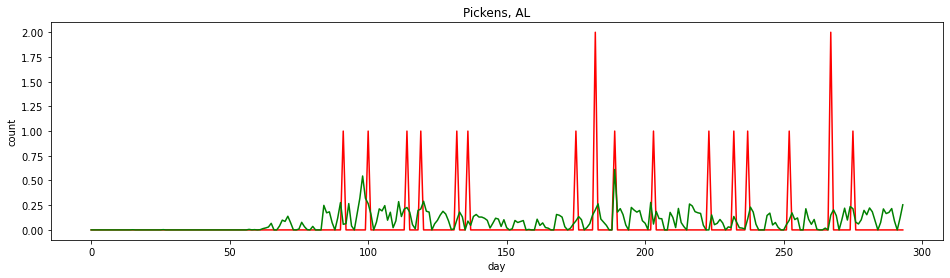

 68%|██████▊   | 41/60 [01:20<00:37,  1.98s/it]

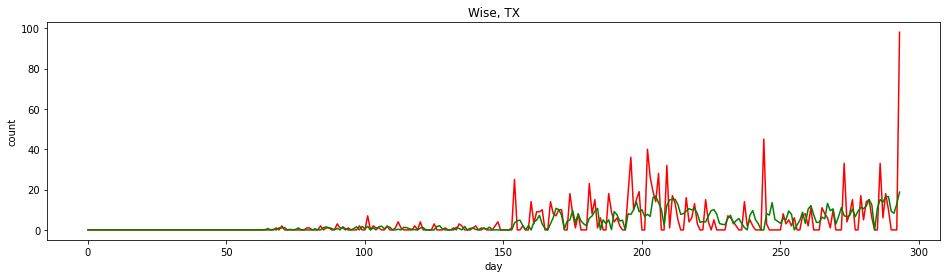

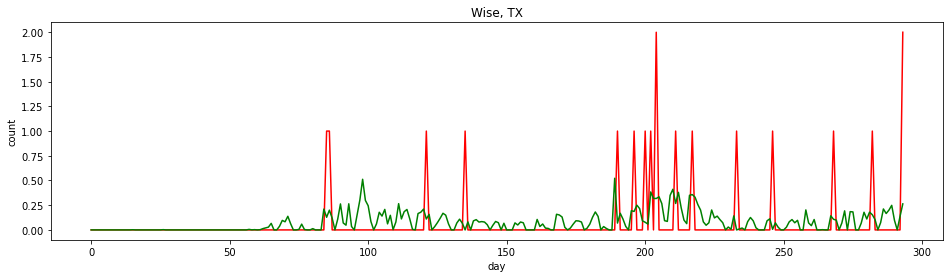

 70%|███████   | 42/60 [01:21<00:35,  1.96s/it]

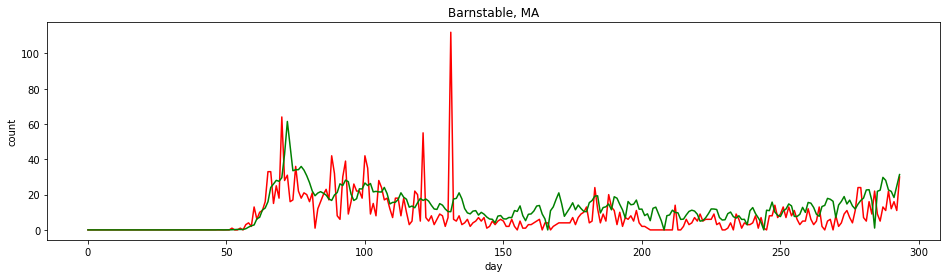

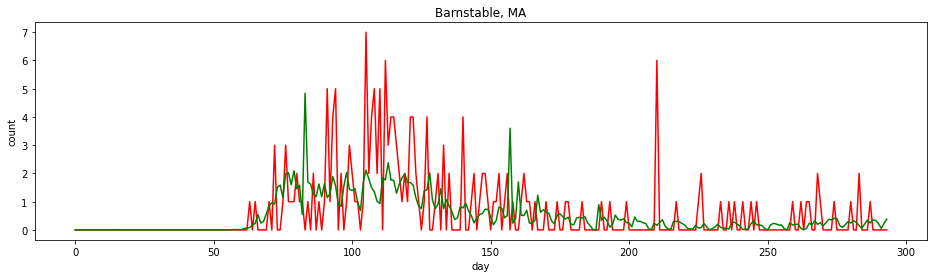

 72%|███████▏  | 43/60 [01:23<00:32,  1.94s/it]

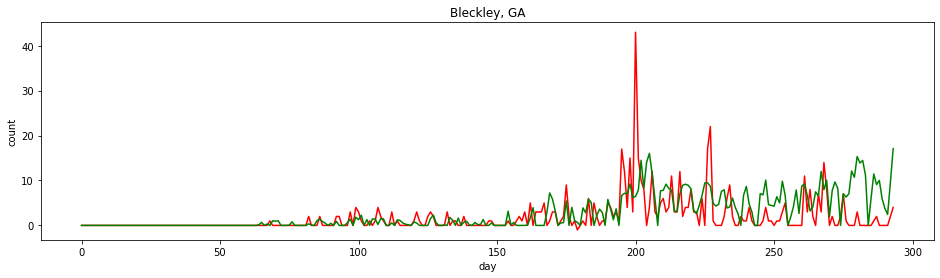

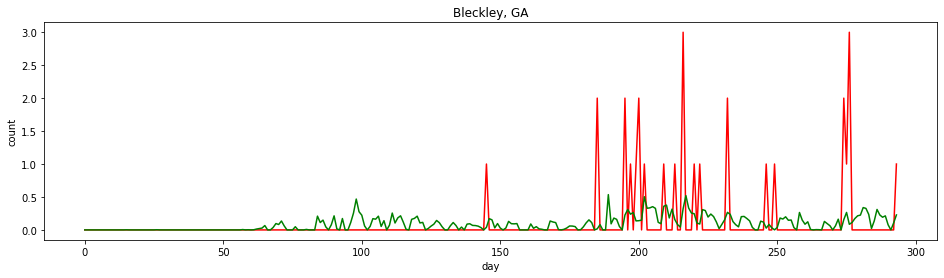

 73%|███████▎  | 44/60 [01:25<00:31,  1.99s/it]

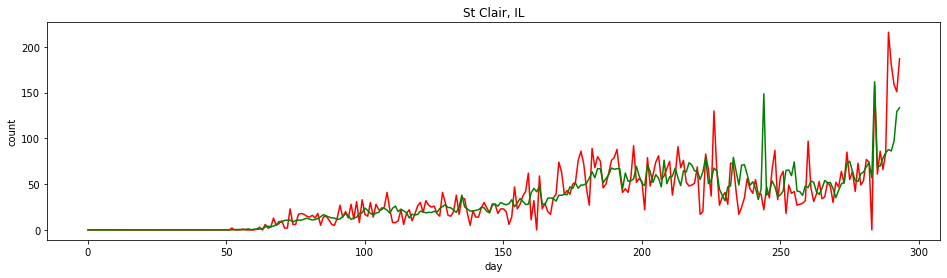

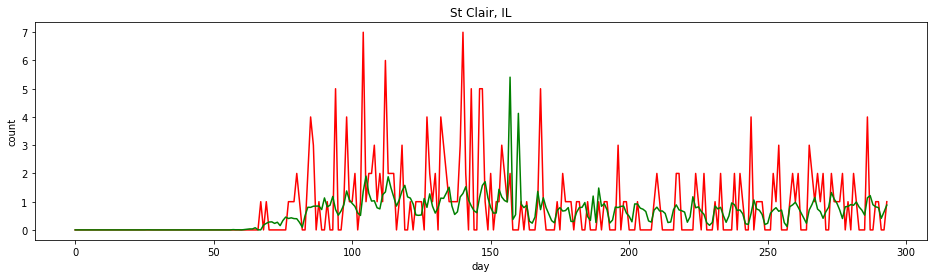

 75%|███████▌  | 45/60 [01:27<00:29,  1.96s/it]

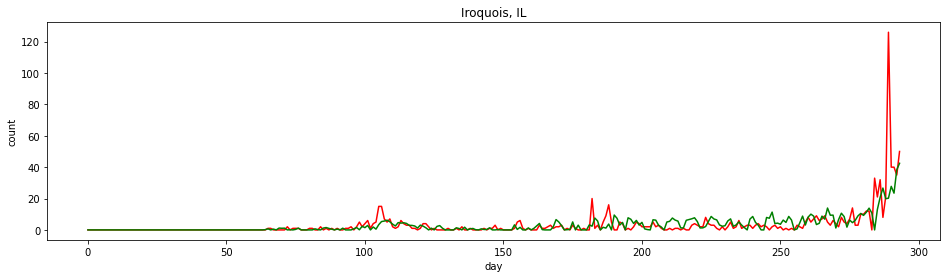

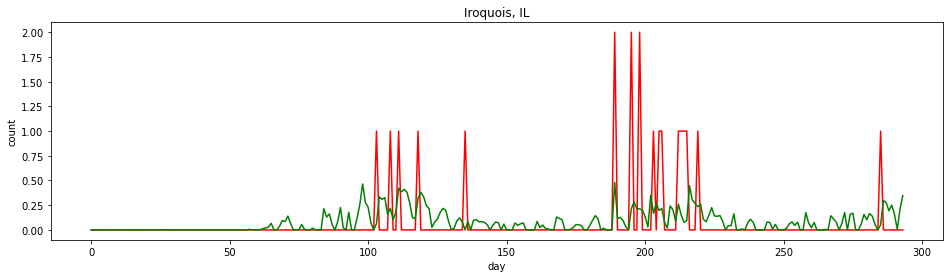

 77%|███████▋  | 46/60 [01:30<00:29,  2.08s/it]

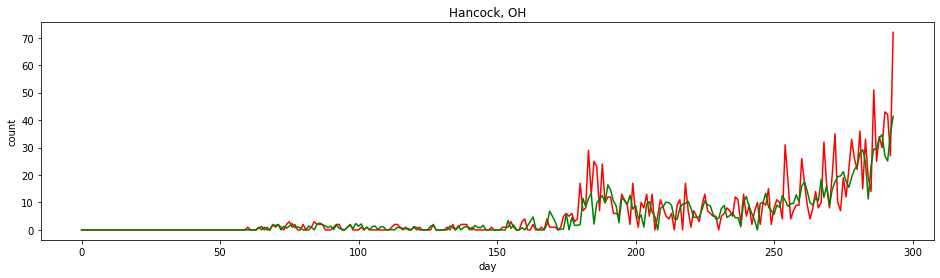

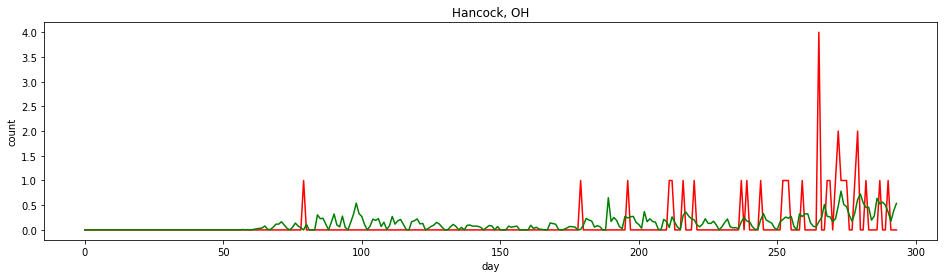

 78%|███████▊  | 47/60 [01:32<00:26,  2.04s/it]

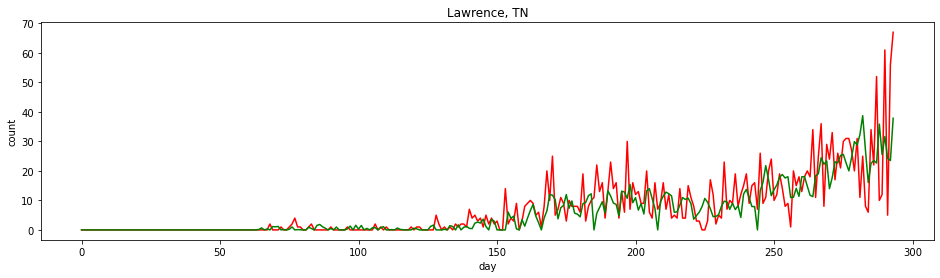

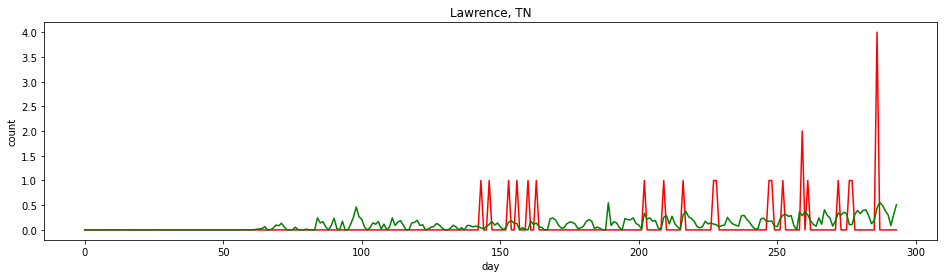

 80%|████████  | 48/60 [01:34<00:24,  2.04s/it]

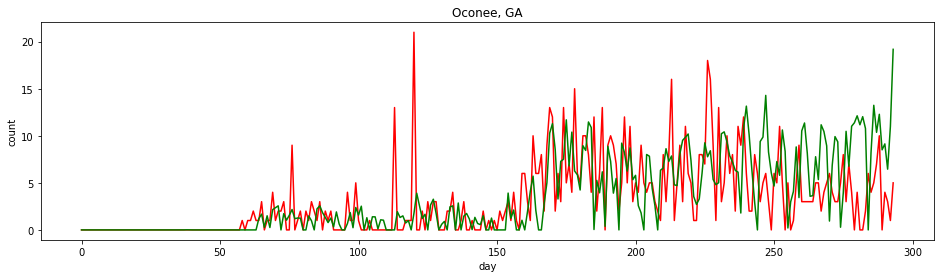

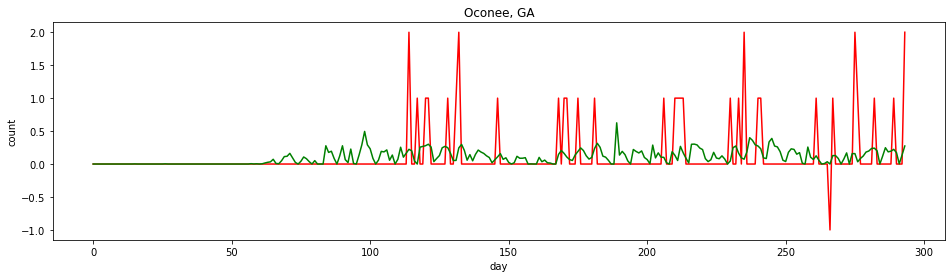

 82%|████████▏ | 49/60 [01:36<00:22,  2.05s/it]

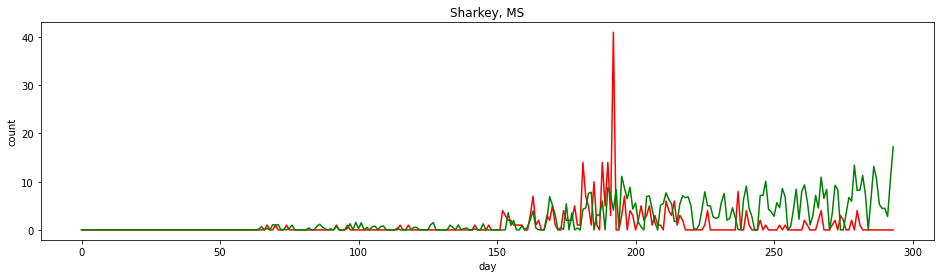

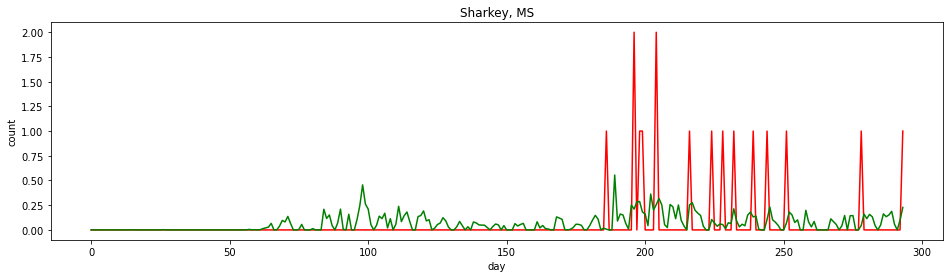

 83%|████████▎ | 50/60 [01:38<00:20,  2.02s/it]

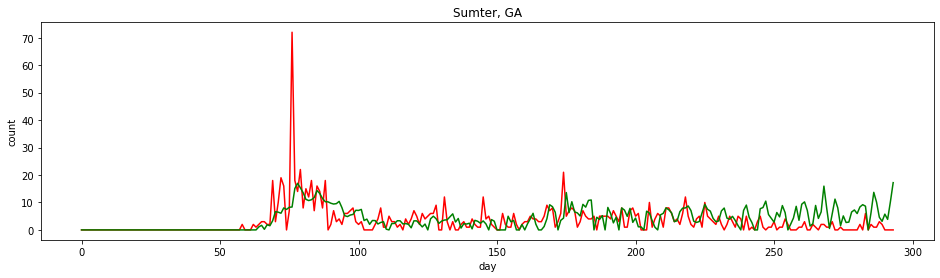

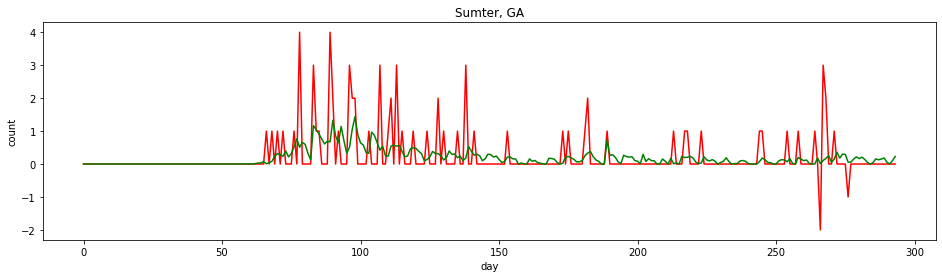

 85%|████████▌ | 51/60 [01:40<00:18,  2.02s/it]

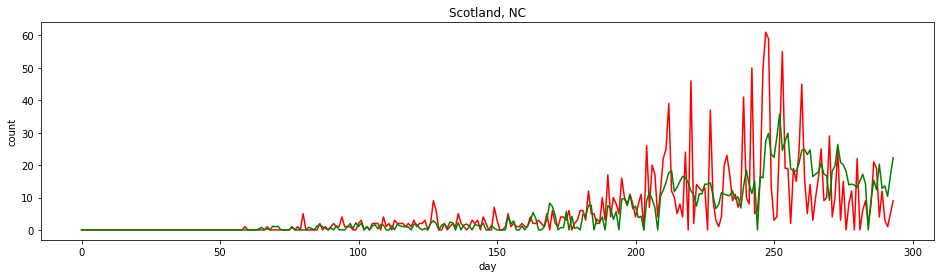

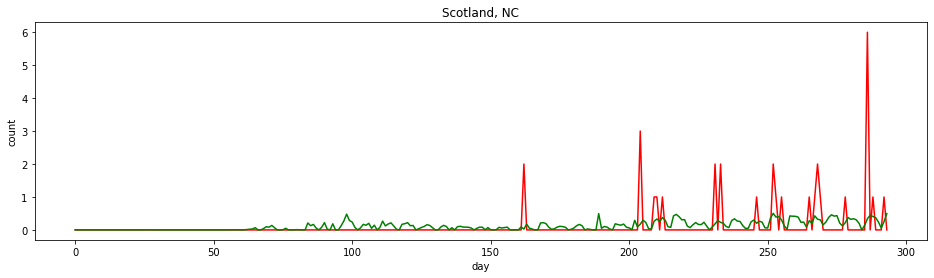

 87%|████████▋ | 52/60 [01:42<00:16,  2.02s/it]

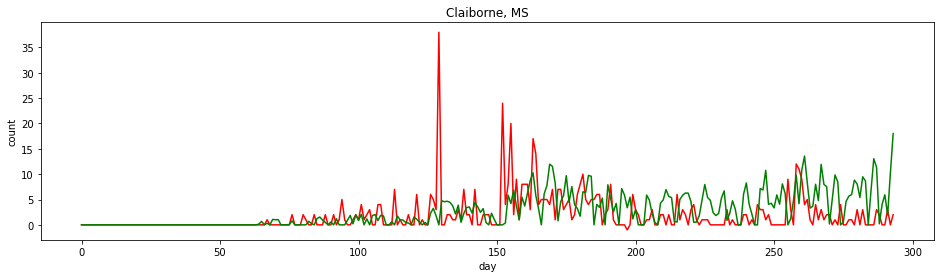

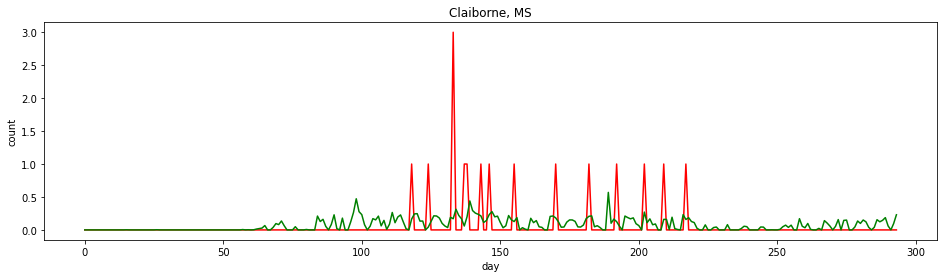

 88%|████████▊ | 53/60 [01:44<00:14,  2.04s/it]

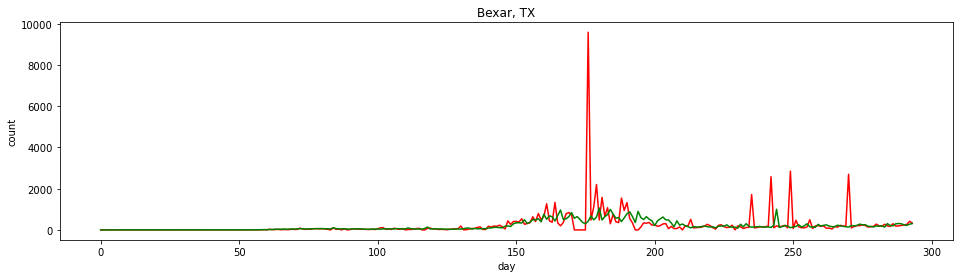

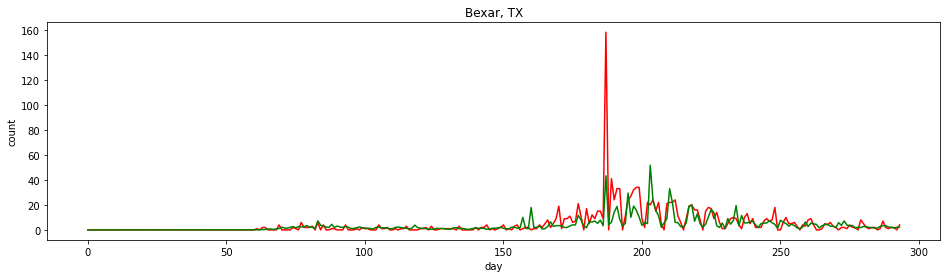

 90%|█████████ | 54/60 [01:46<00:12,  2.04s/it]

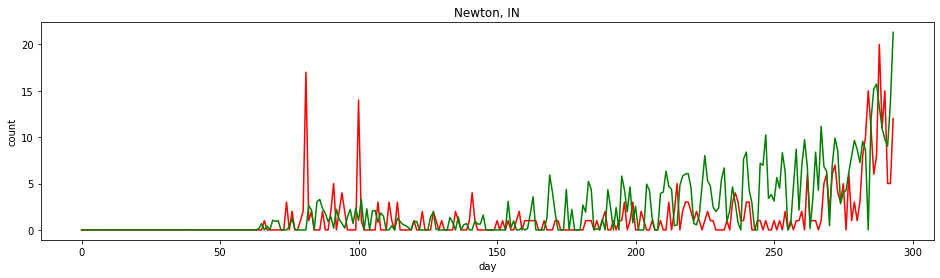

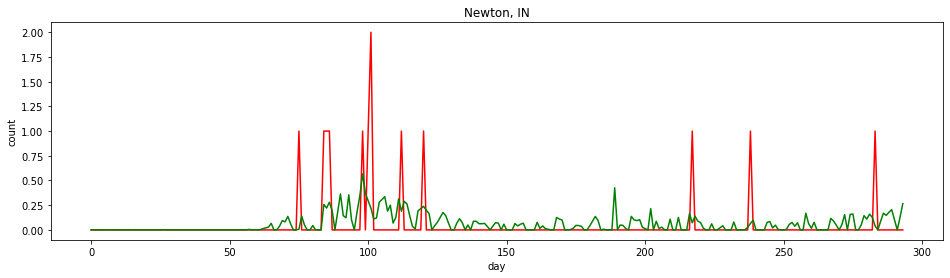

 92%|█████████▏| 55/60 [01:48<00:10,  2.03s/it]

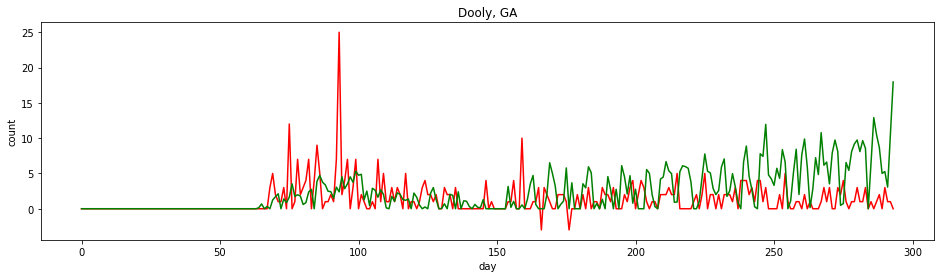

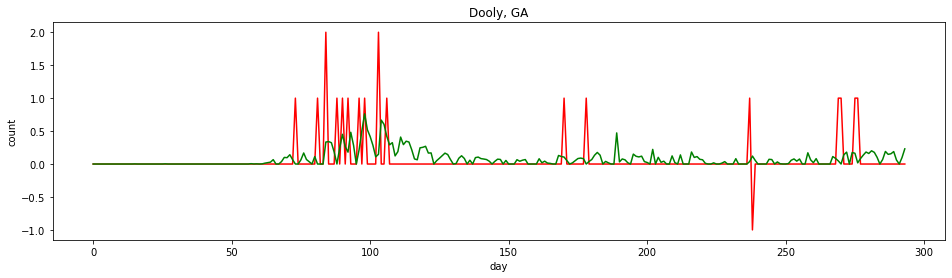

 93%|█████████▎| 56/60 [01:50<00:08,  2.02s/it]

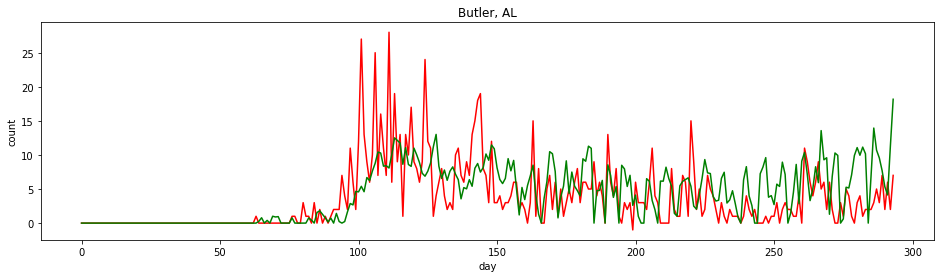

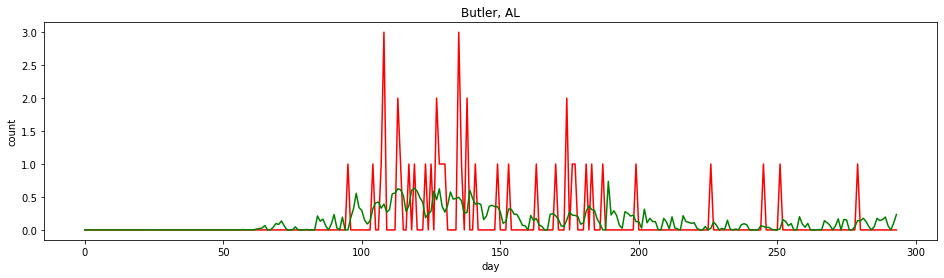

 95%|█████████▌| 57/60 [01:52<00:06,  2.05s/it]

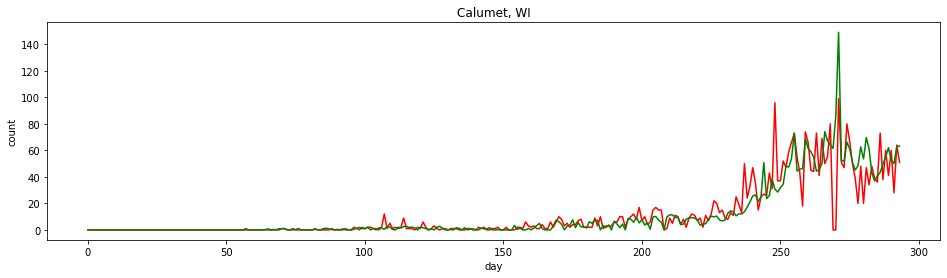

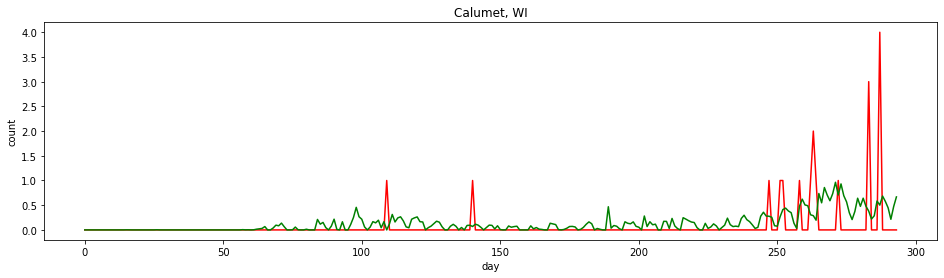

 97%|█████████▋| 58/60 [01:54<00:04,  2.07s/it]

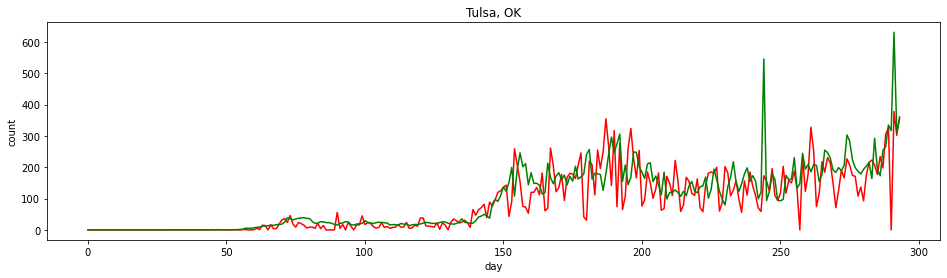

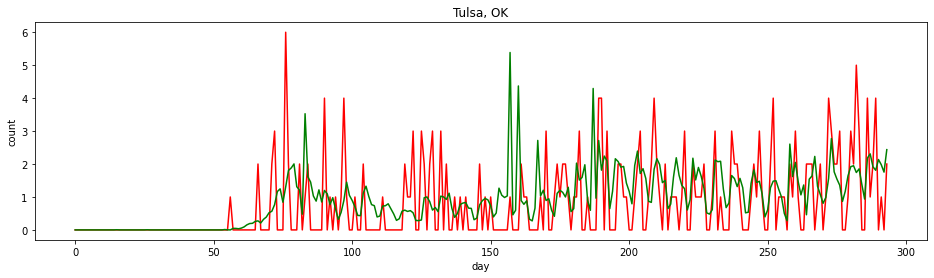

 98%|█████████▊| 59/60 [01:56<00:02,  2.08s/it]

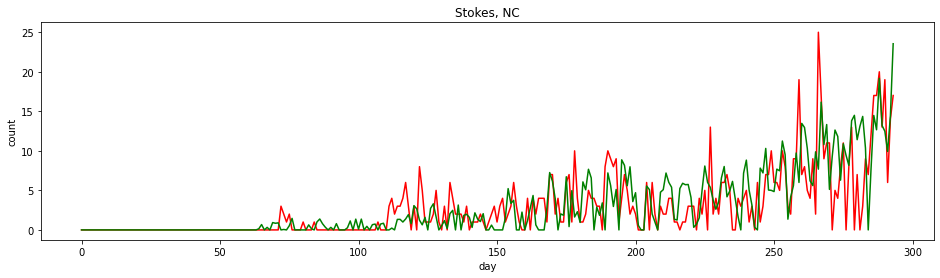

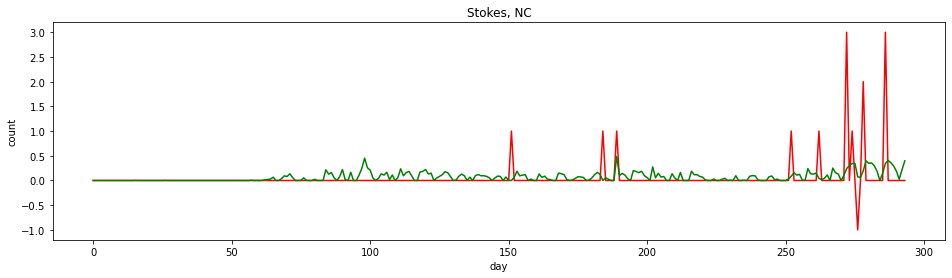

100%|██████████| 60/60 [01:58<00:00,  1.98s/it]


In [82]:
testcasesmse, testdeathsmse = evaluate(lstm, range(1550, 1610), plot=True)

In [83]:
np.mean(testcasesmse), np.mean(testdeathsmse)

(7543.365567231123, 2.1038159348256467)

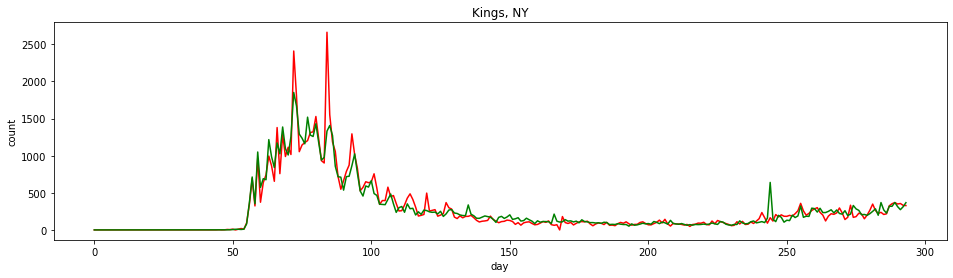

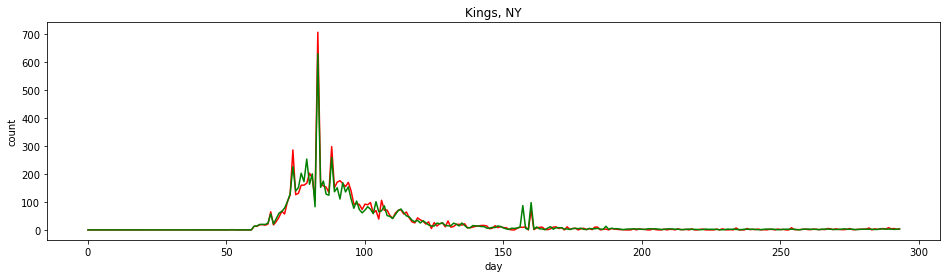

(13402.086734693878, 160.63566911139455)

In [81]:
plotPrediction(lstm, 'Kings', 'NY')

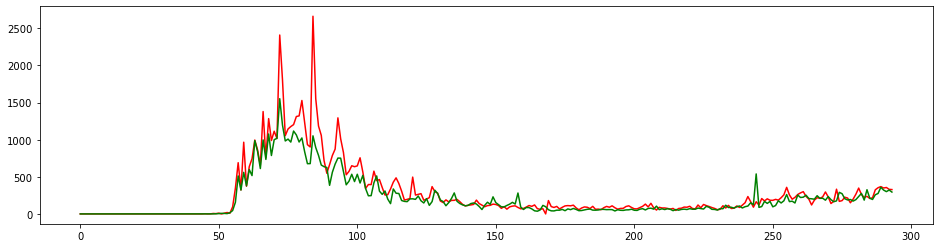

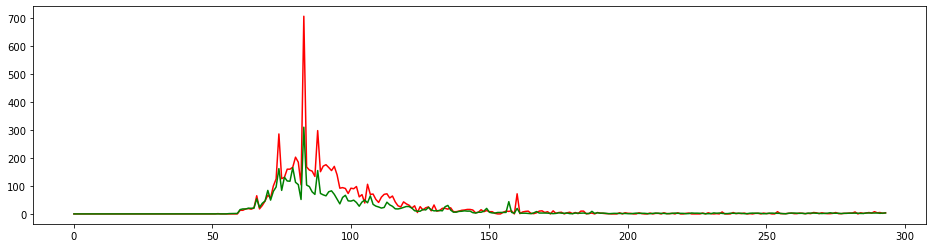

(25665.841836734693, 1123.7441539115646)

In [52]:
plotPrediction(lstm, 'Kings', 'NY')

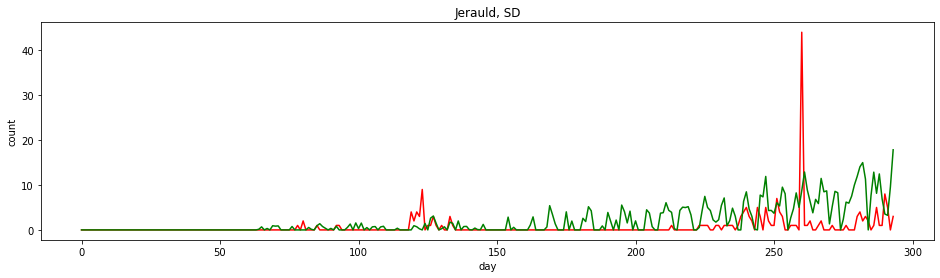

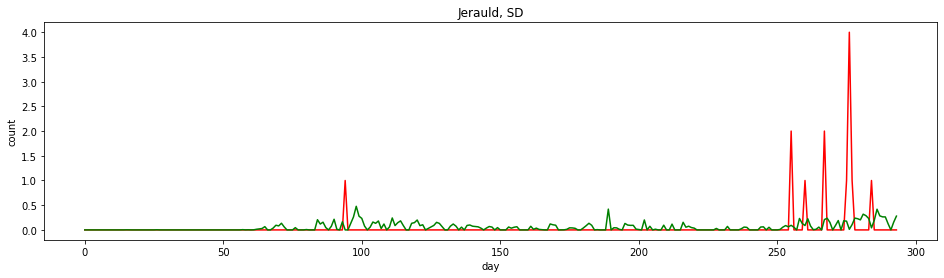

(15.381256311118197, 0.10126647170709104)

In [84]:
plotPrediction(lstm, 'Jerauld', 'SD')

In [40]:
df.iloc[1562]

countyFIPS                                                     46073
STATEFP                                                           46
COUNTYFP                                                          73
CountyName                                                   Jerauld
StateName                                                         SD
                                         ...                        
cases              [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...
tot_deaths                                                        13
tot_cases                                                        197
neighbor_deaths    [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
neighbor_cases     [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
Name: 2389, Length: 683, dtype: object

In [62]:
def evaluate(model, rangelist, plot=False):
    msecases =[]
    msedeaths=[]
    for i in tqdm.tqdm(rangelist):
        county_name = df.iloc[i]['CountyName']
        state_name = df.iloc[i]['StateName']
        msecasei, msedeathi = plotPrediction(model, county_name, state_name, plot=plot)
        msecases.append(msecasei)
        msedeaths.append(msedeathi)
    return [msecases, msedeaths]

  0%|          | 0/60 [00:00<?, ?it/s]

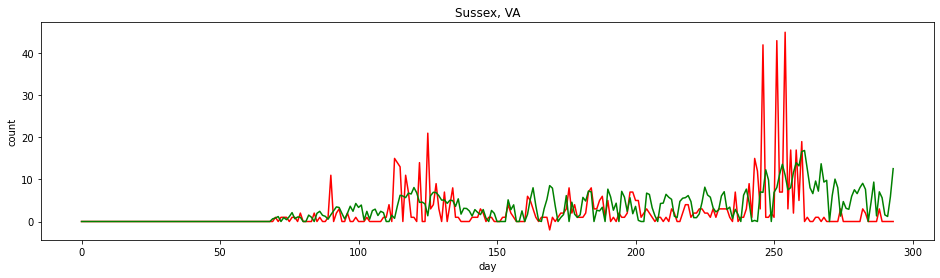

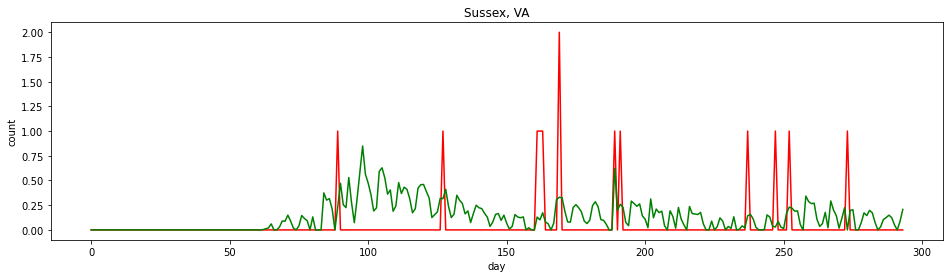

  2%|▏         | 1/60 [00:01<01:55,  1.96s/it]

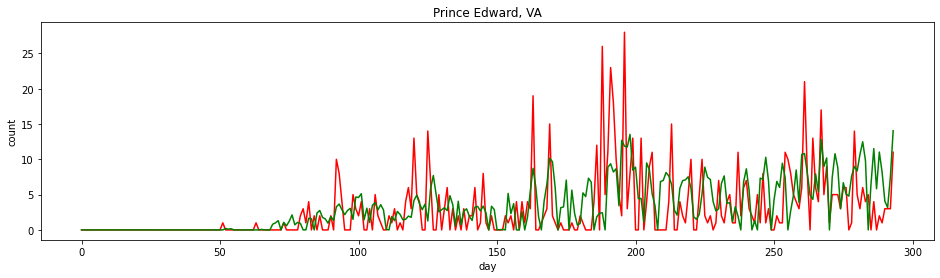

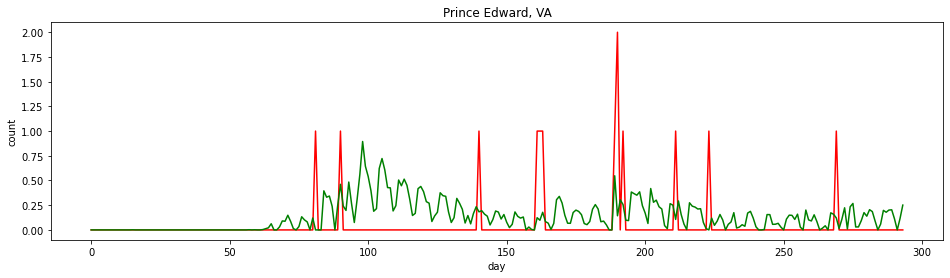

  3%|▎         | 2/60 [00:03<01:53,  1.96s/it]

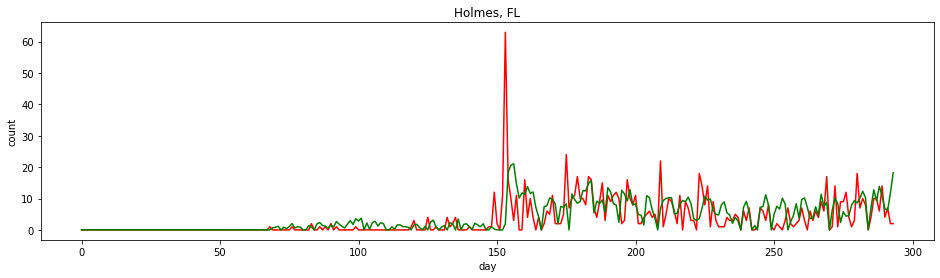

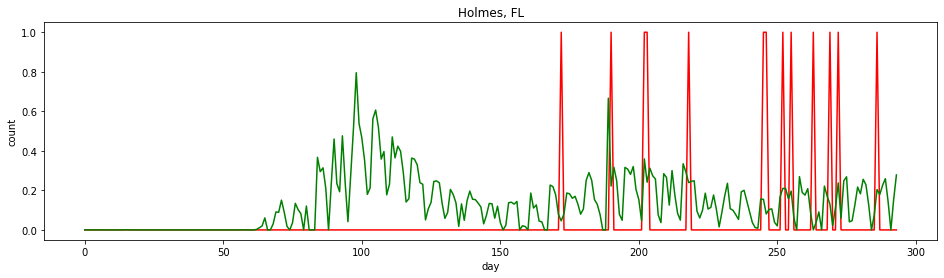

  5%|▌         | 3/60 [00:05<01:50,  1.95s/it]

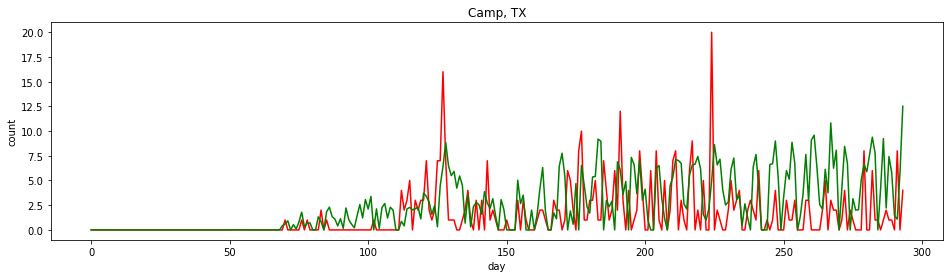

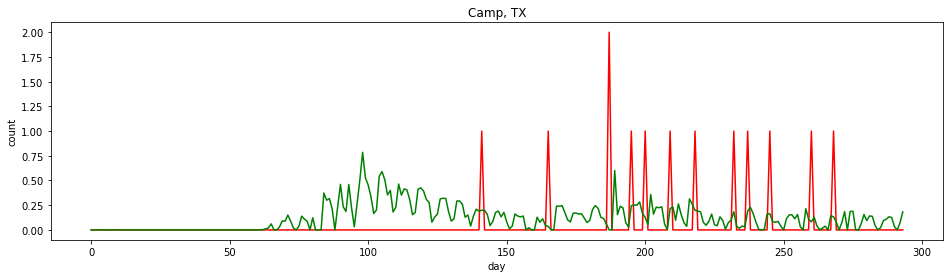

  7%|▋         | 4/60 [00:07<01:48,  1.93s/it]

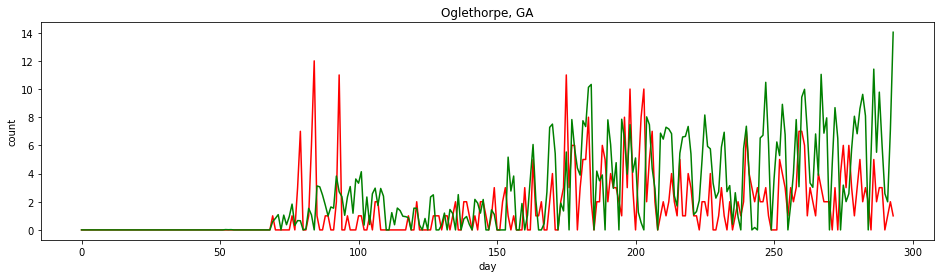

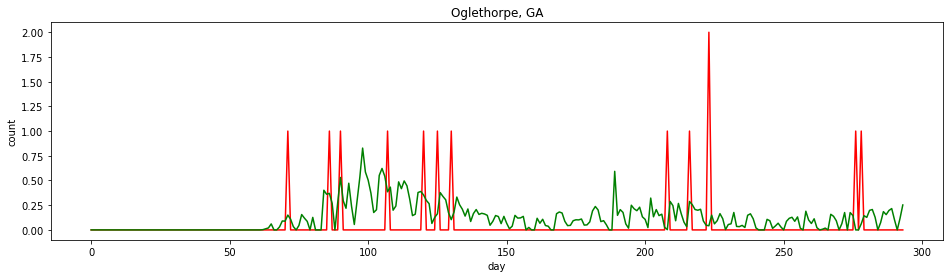

  8%|▊         | 5/60 [00:09<01:46,  1.94s/it]

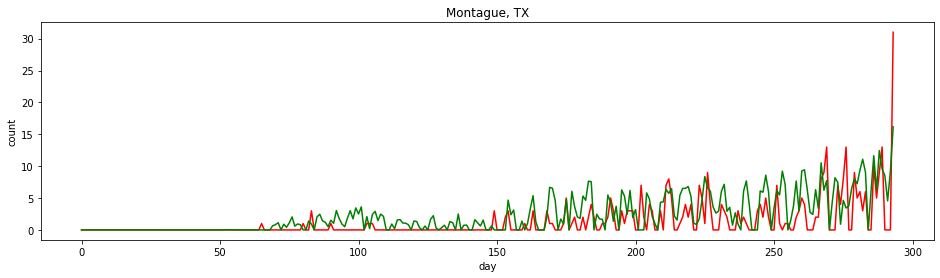

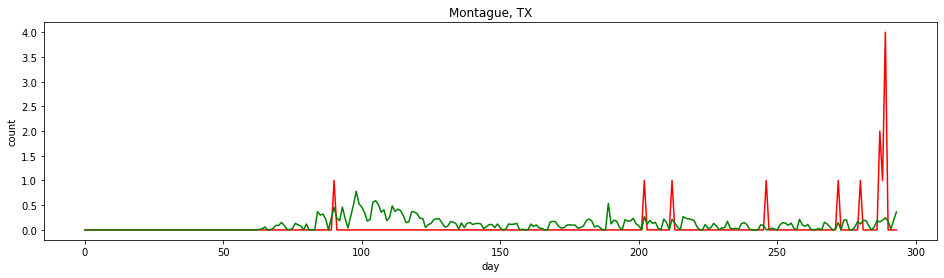

 10%|█         | 6/60 [00:11<01:45,  1.95s/it]

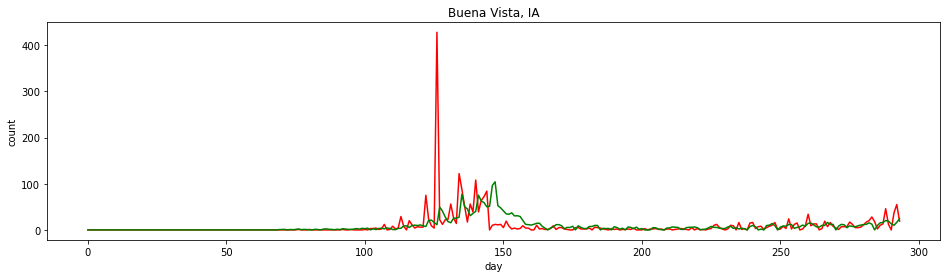

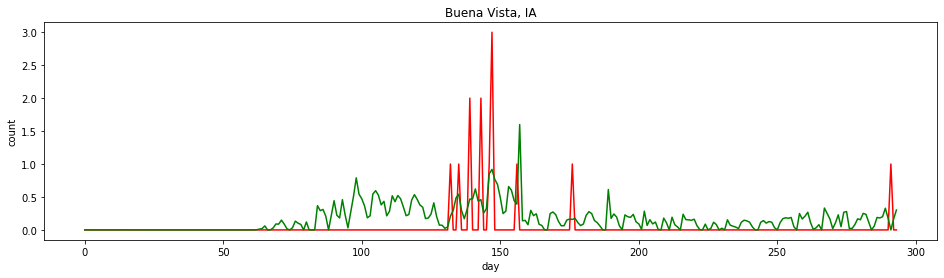

 12%|█▏        | 7/60 [00:13<01:42,  1.93s/it]

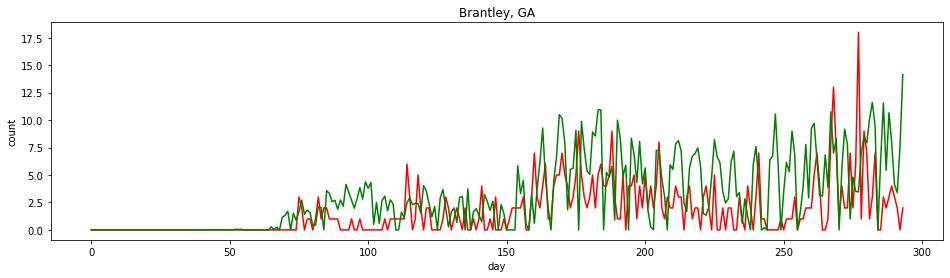

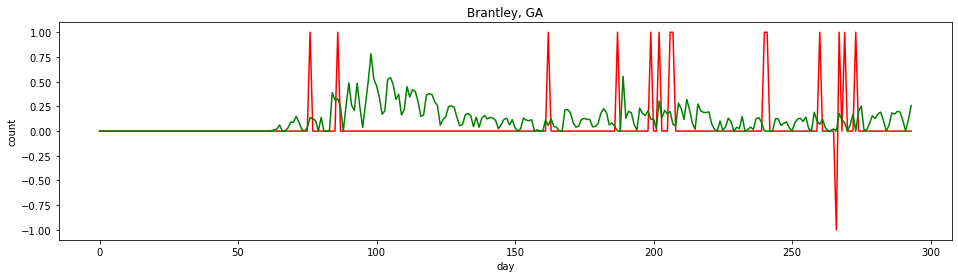

 13%|█▎        | 8/60 [00:15<01:40,  1.93s/it]

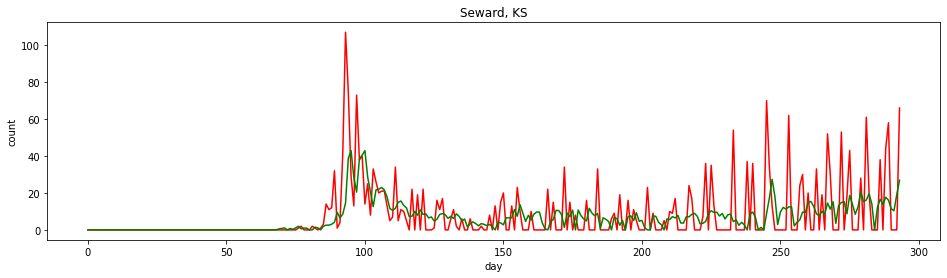

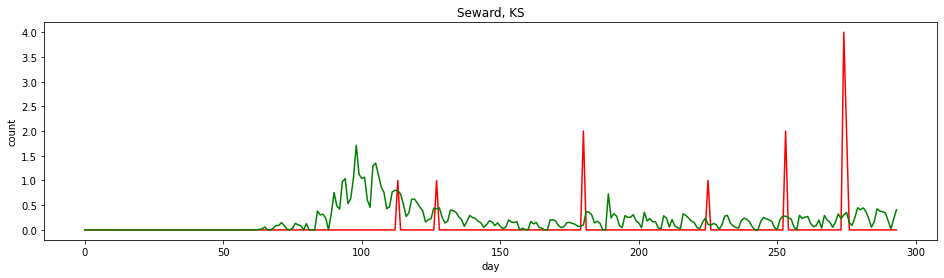

 15%|█▌        | 9/60 [00:17<01:39,  1.94s/it]

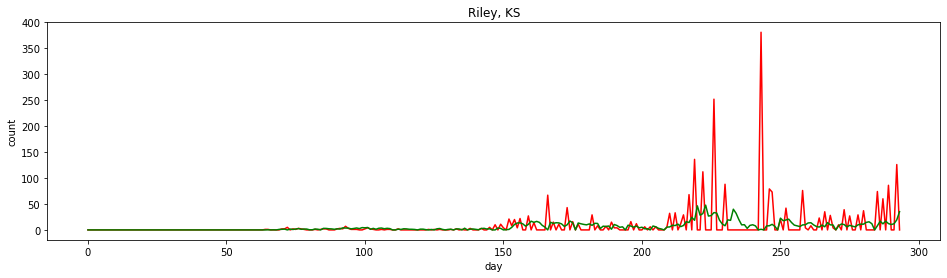

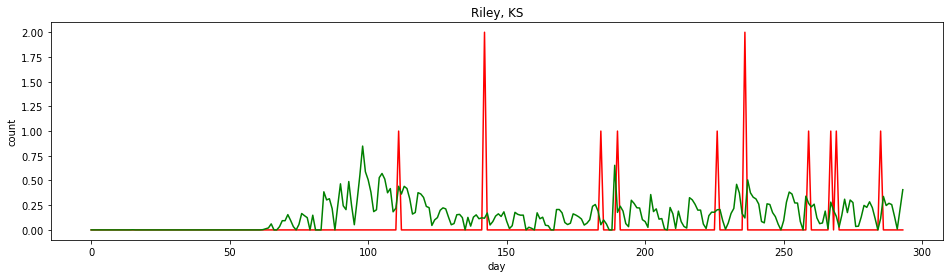

 17%|█▋        | 10/60 [00:19<01:37,  1.94s/it]

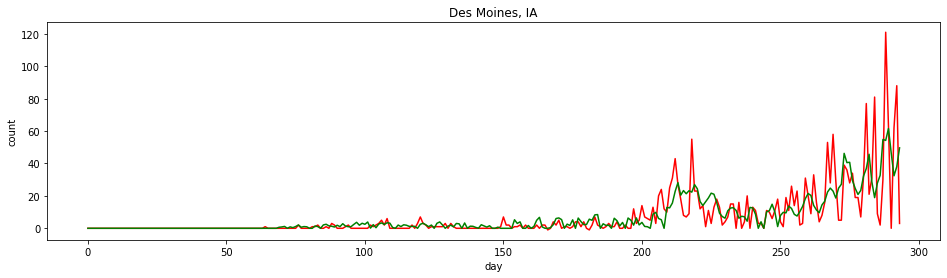

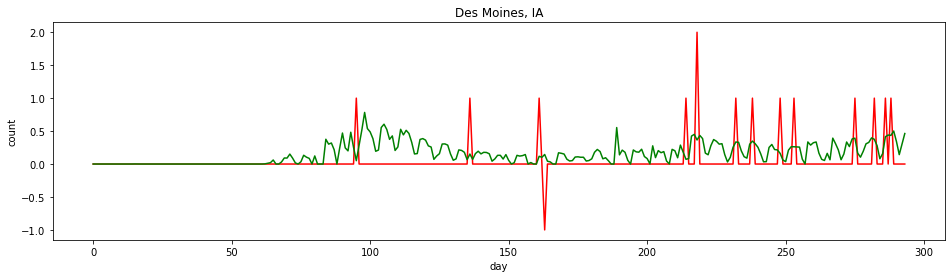

 18%|█▊        | 11/60 [00:21<01:34,  1.92s/it]

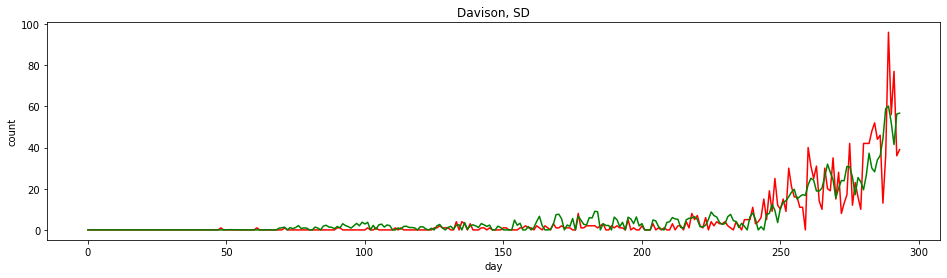

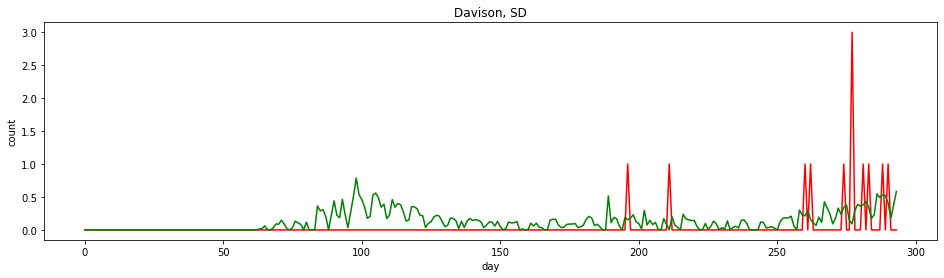

 20%|██        | 12/60 [00:23<01:32,  1.93s/it]

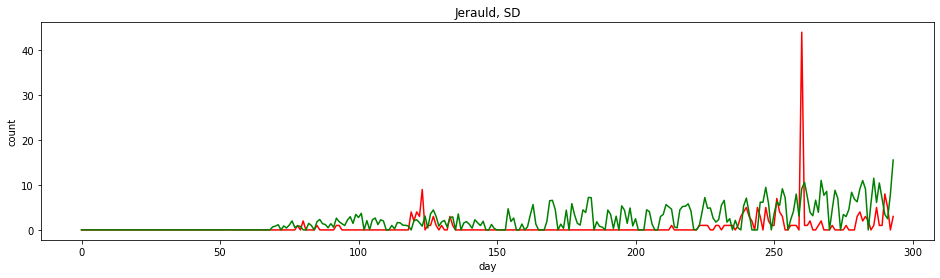

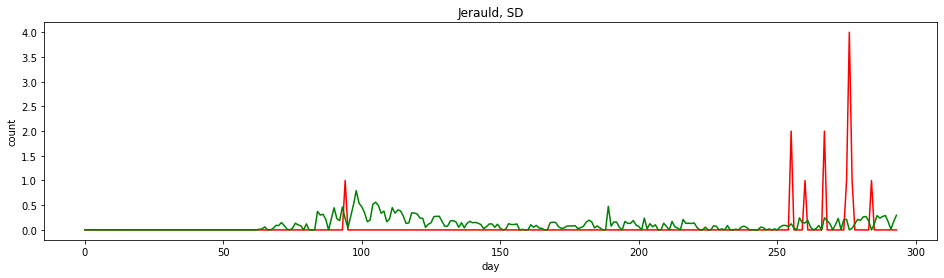

 22%|██▏       | 13/60 [00:24<01:28,  1.88s/it]

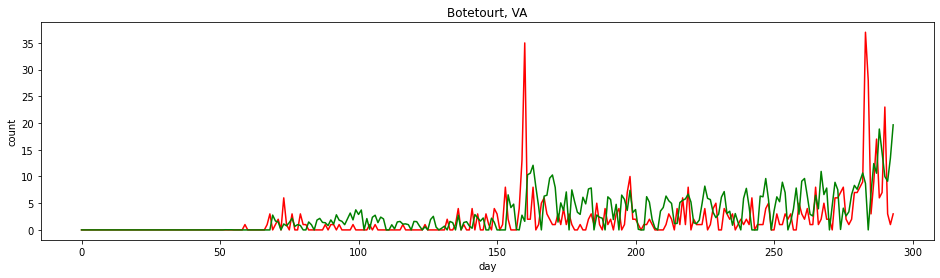

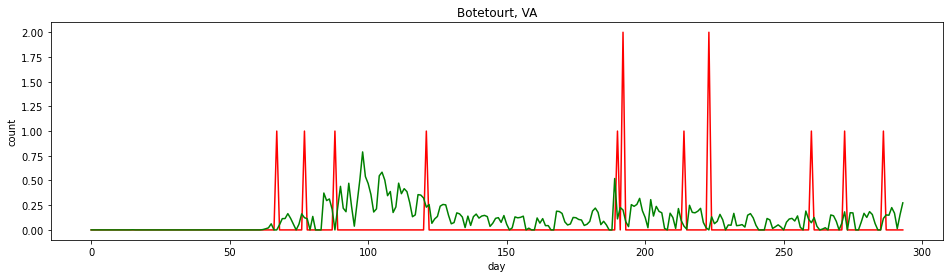

 23%|██▎       | 14/60 [00:26<01:26,  1.88s/it]

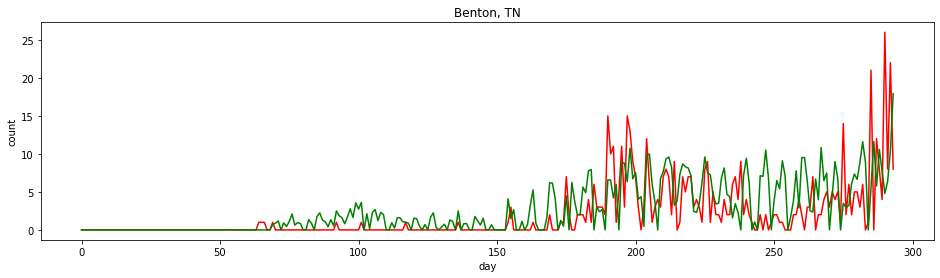

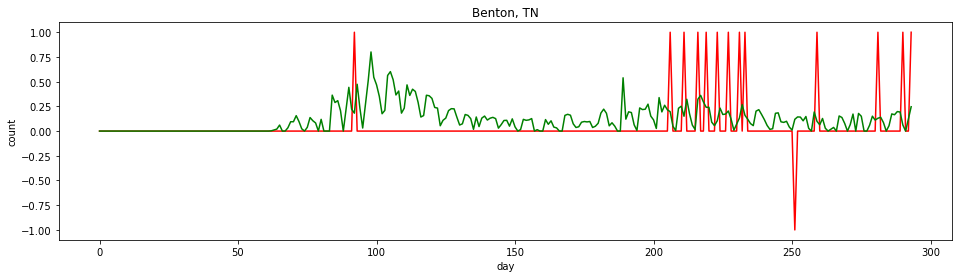

 25%|██▌       | 15/60 [00:28<01:26,  1.92s/it]

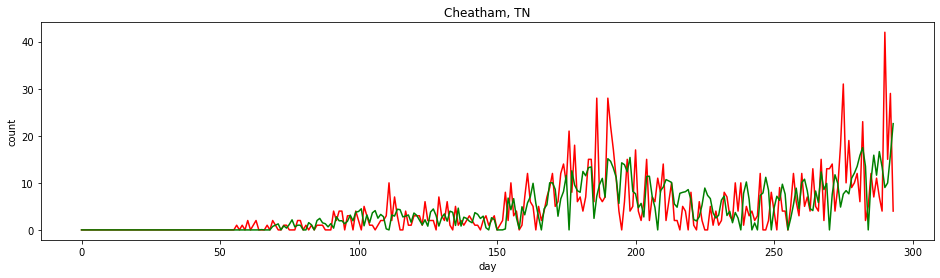

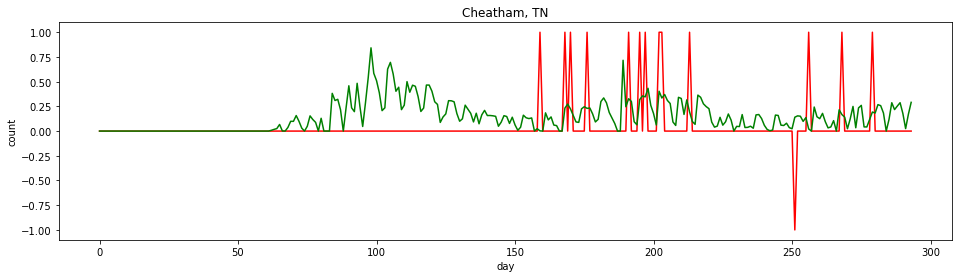

 27%|██▋       | 16/60 [00:30<01:26,  1.96s/it]

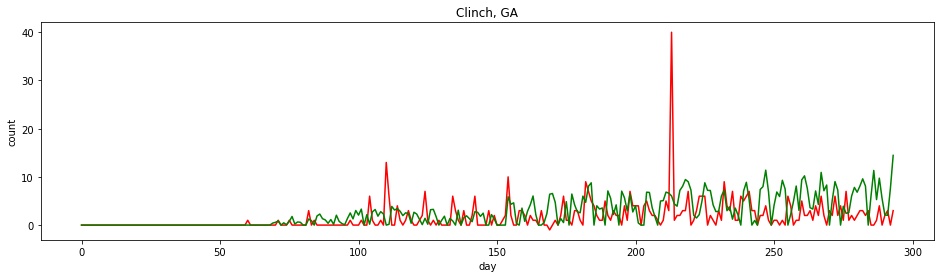

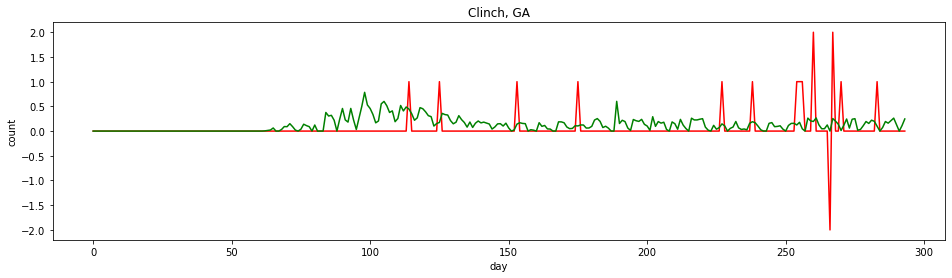

 28%|██▊       | 17/60 [00:33<01:26,  2.01s/it]

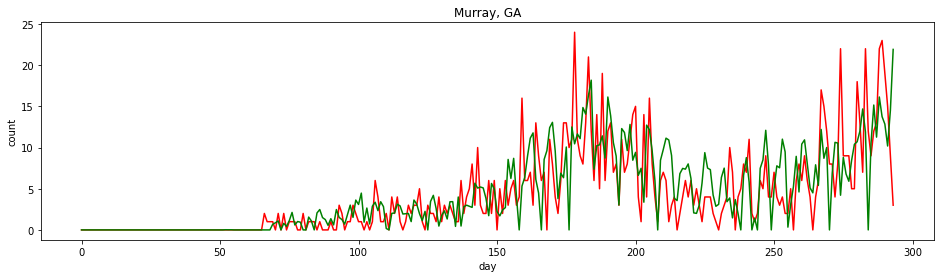

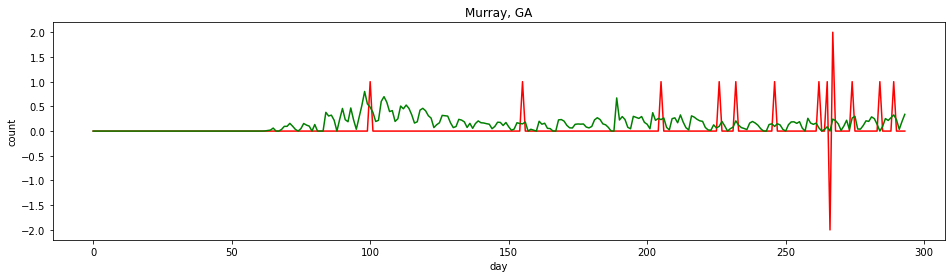

 30%|███       | 18/60 [00:34<01:21,  1.95s/it]

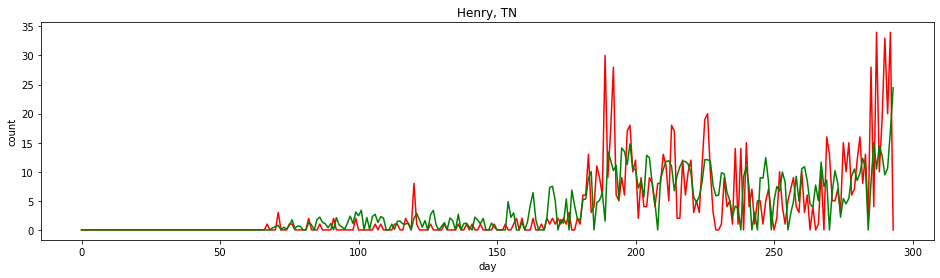

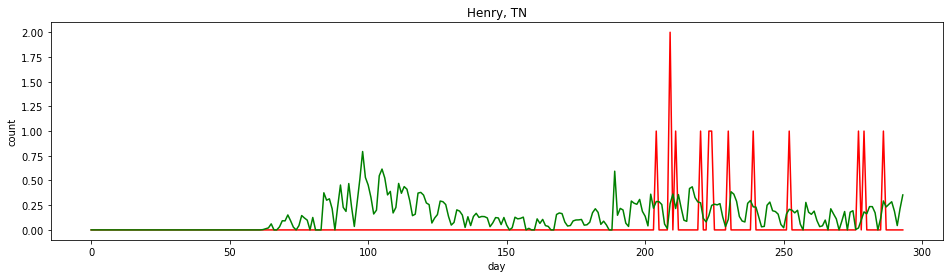

 32%|███▏      | 19/60 [00:36<01:18,  1.92s/it]

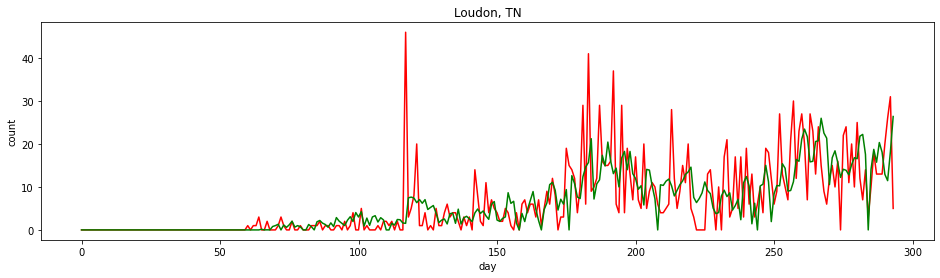

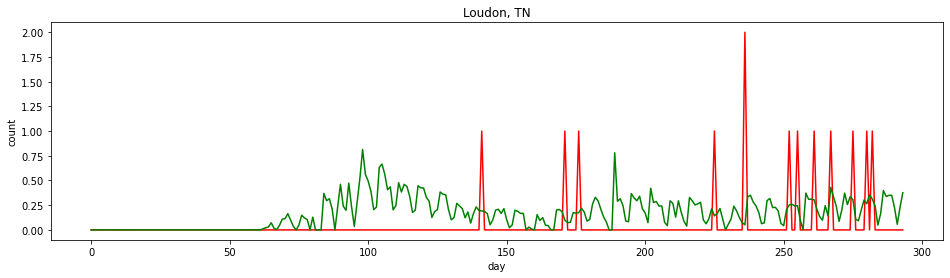

 33%|███▎      | 20/60 [00:38<01:17,  1.93s/it]

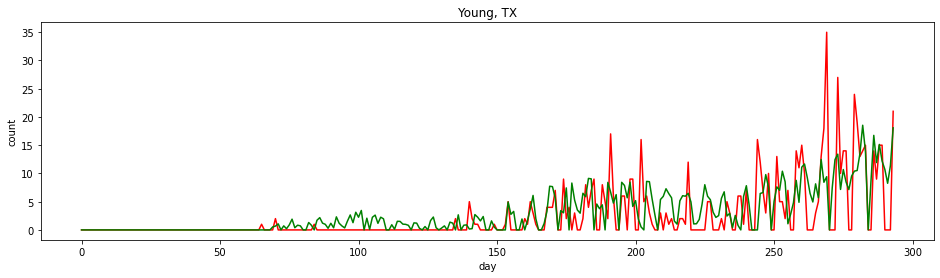

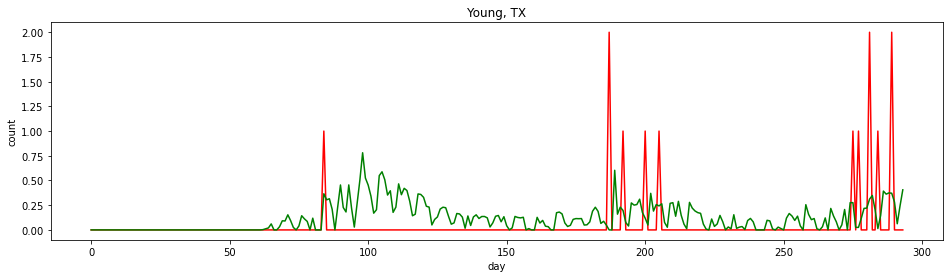

 35%|███▌      | 21/60 [00:40<01:16,  1.96s/it]

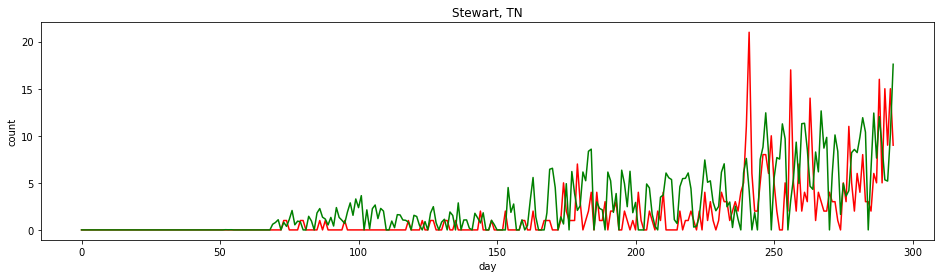

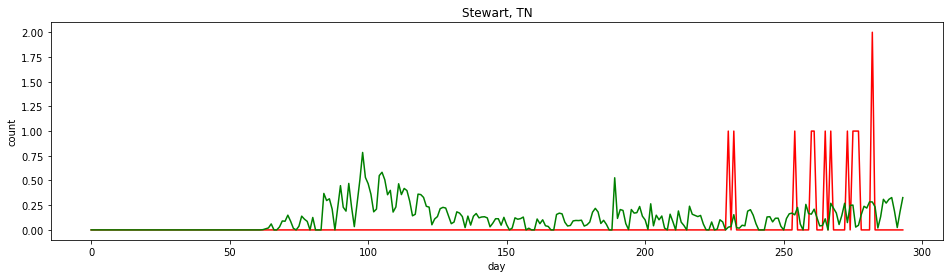

 37%|███▋      | 22/60 [00:42<01:15,  1.98s/it]

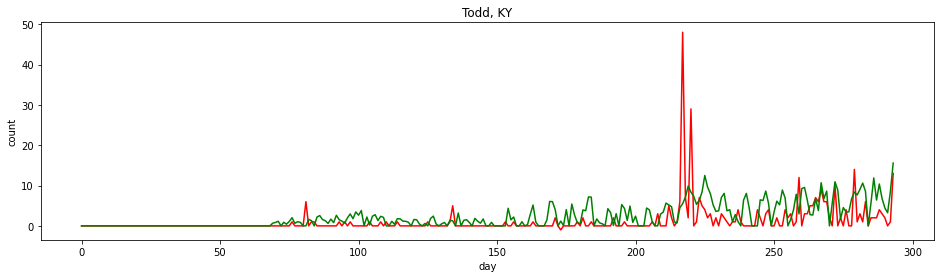

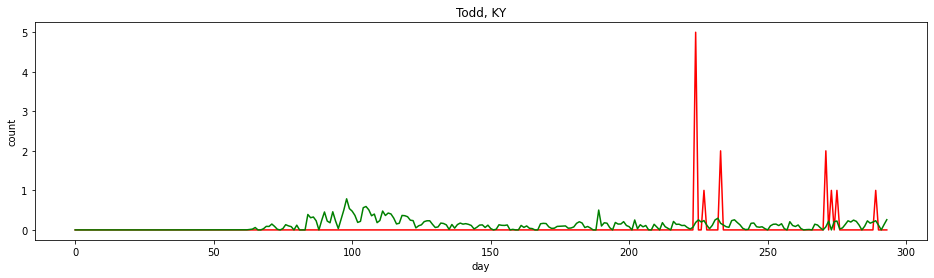

 38%|███▊      | 23/60 [00:44<01:12,  1.95s/it]

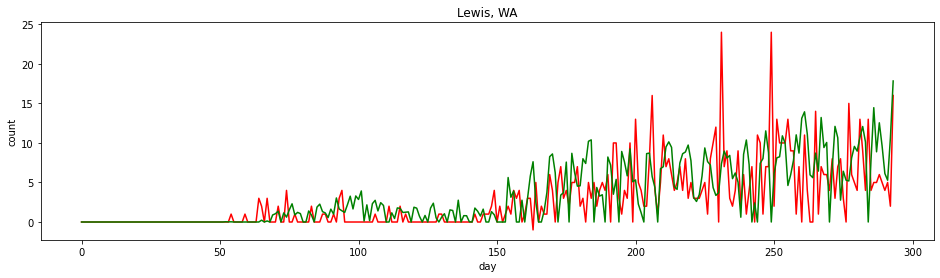

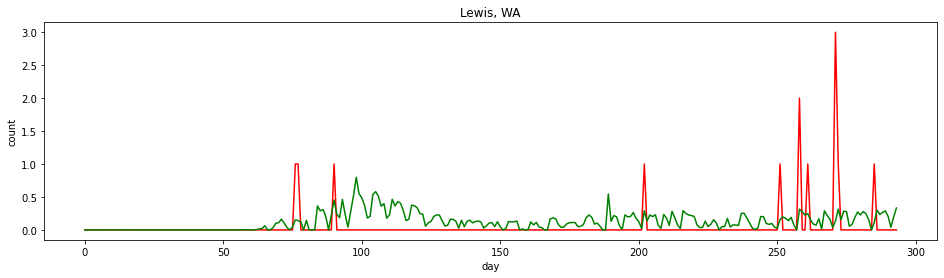

 40%|████      | 24/60 [00:46<01:09,  1.93s/it]

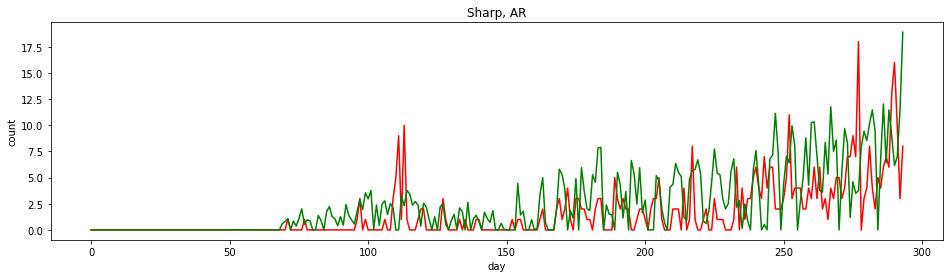

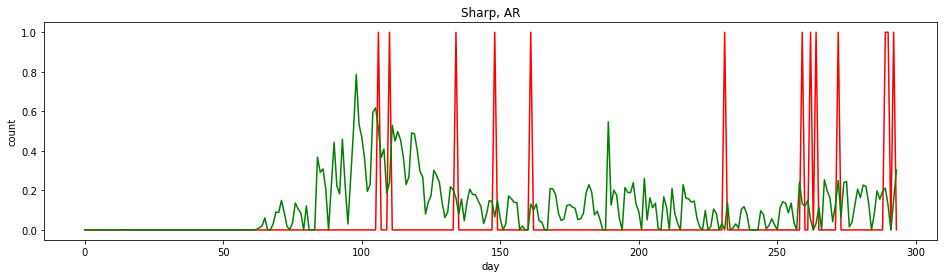

 42%|████▏     | 25/60 [00:48<01:08,  1.95s/it]

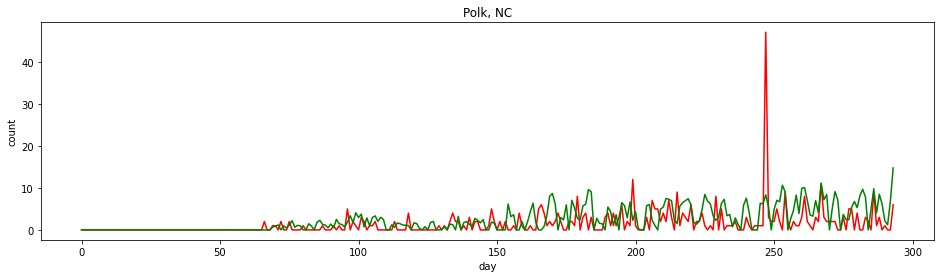

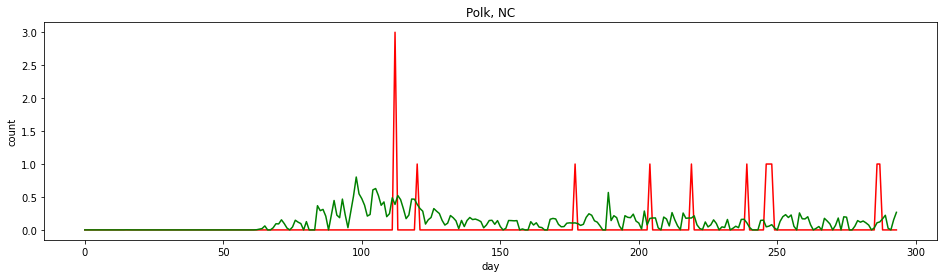

 43%|████▎     | 26/60 [00:50<01:05,  1.94s/it]

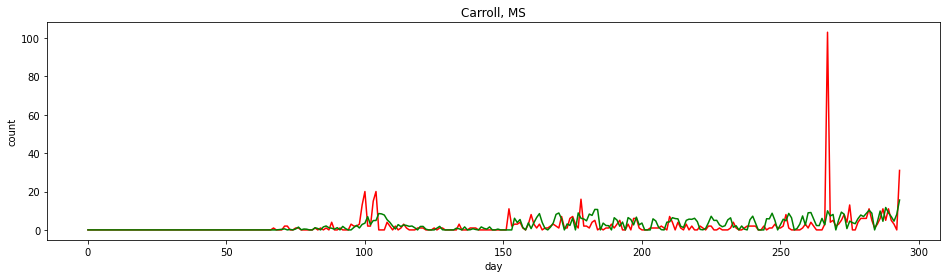

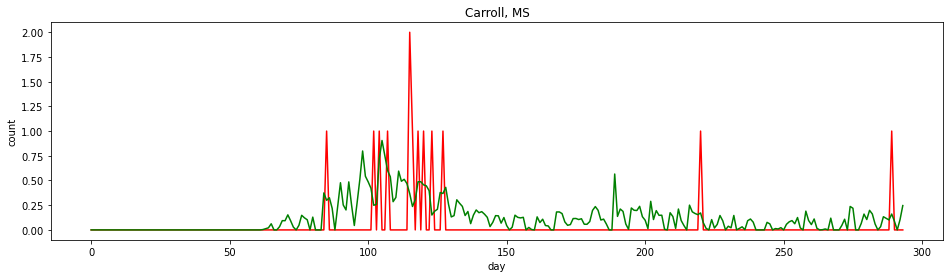

 45%|████▌     | 27/60 [00:52<01:03,  1.94s/it]

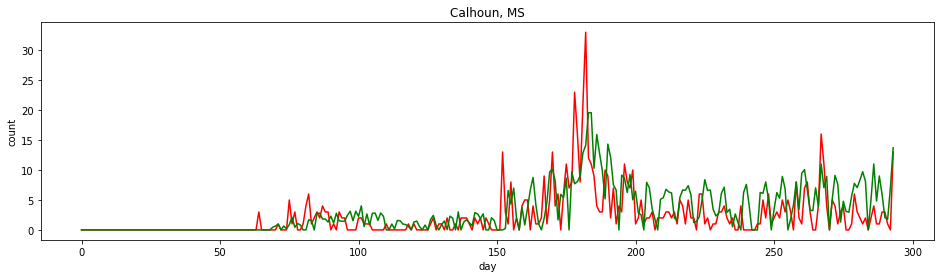

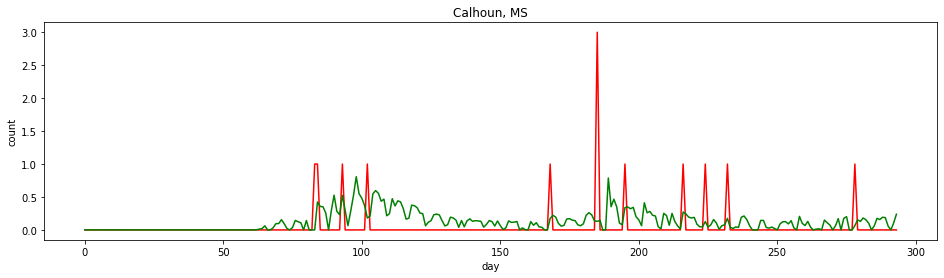

 47%|████▋     | 28/60 [00:54<01:02,  1.94s/it]

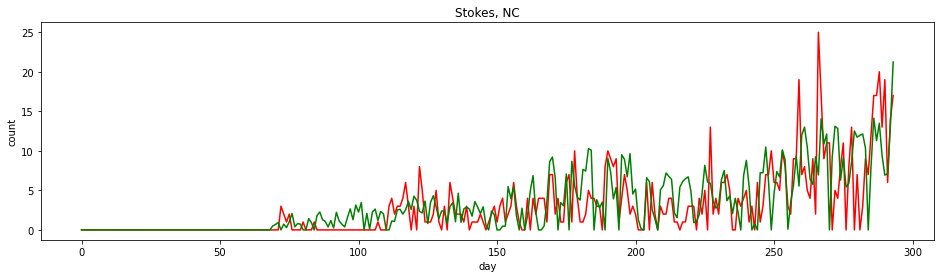

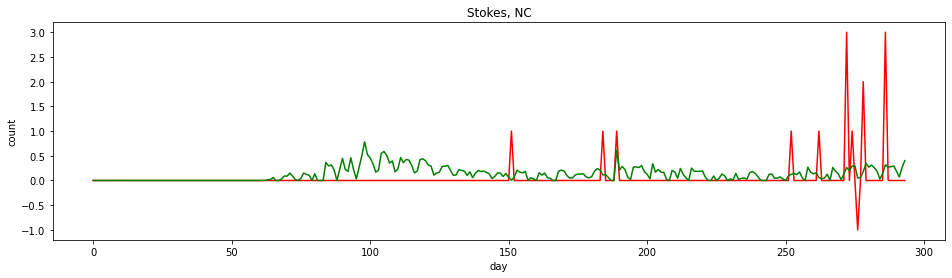

 48%|████▊     | 29/60 [00:56<01:01,  1.99s/it]

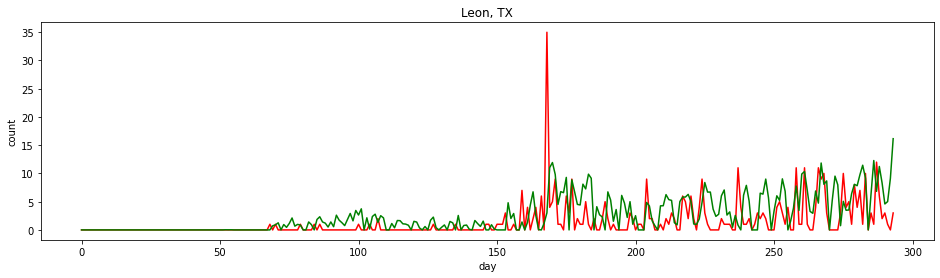

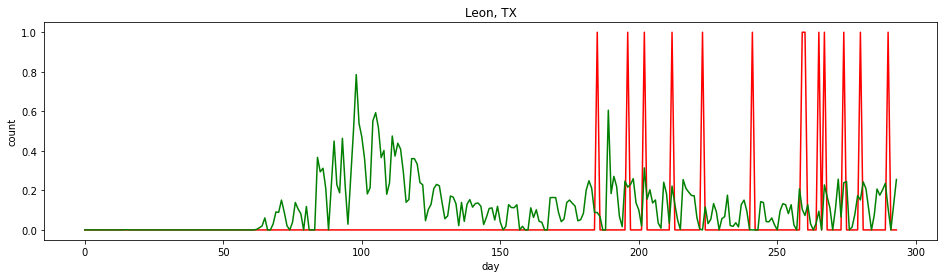

 50%|█████     | 30/60 [00:58<01:00,  2.01s/it]

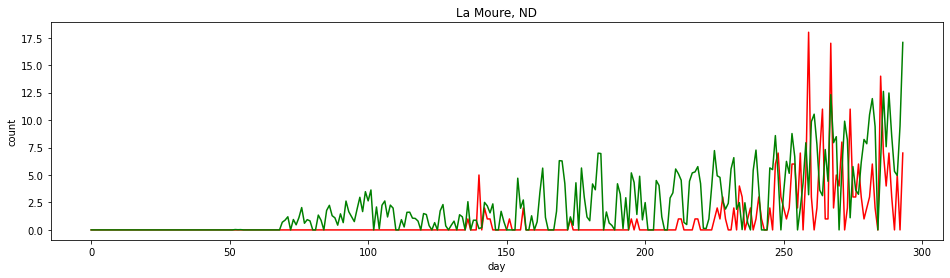

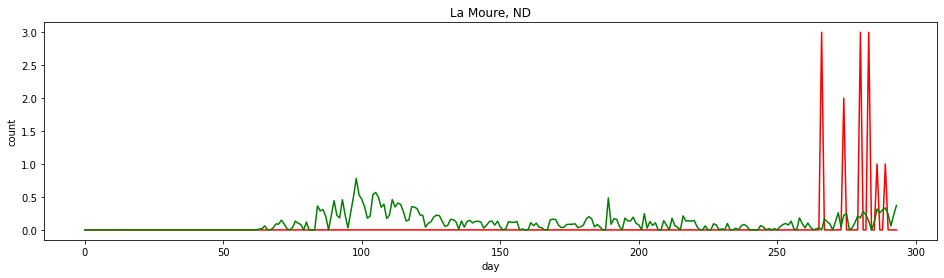

 52%|█████▏    | 31/60 [01:00<00:57,  1.98s/it]

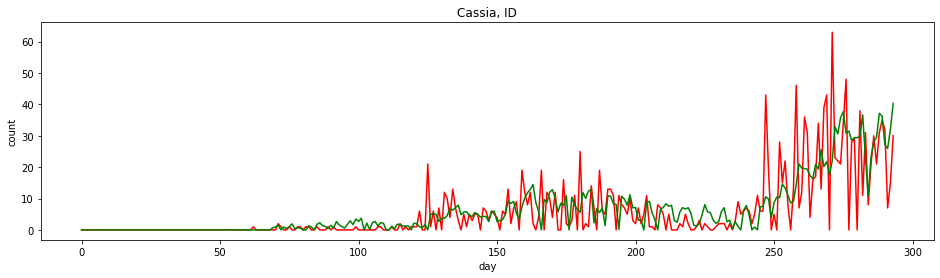

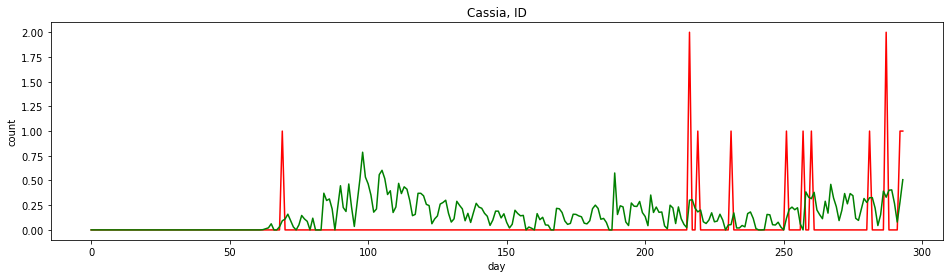

 53%|█████▎    | 32/60 [01:02<00:55,  1.97s/it]

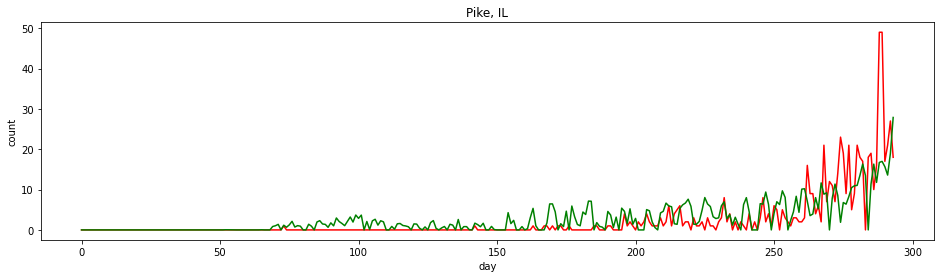

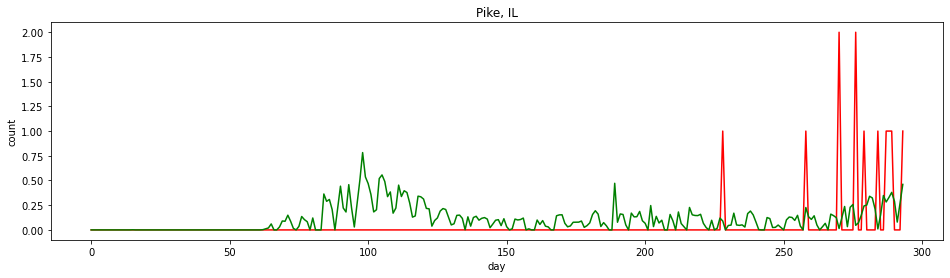

 55%|█████▌    | 33/60 [01:04<00:53,  1.98s/it]

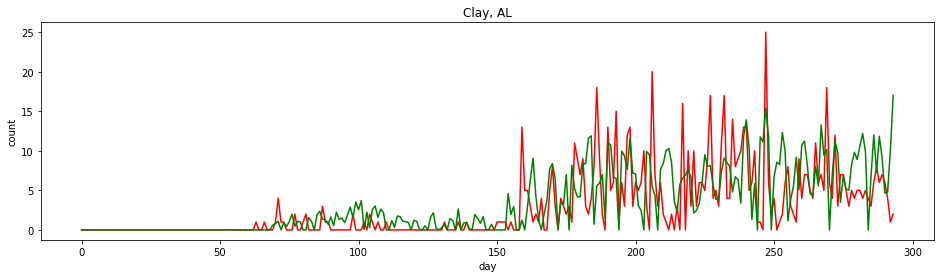

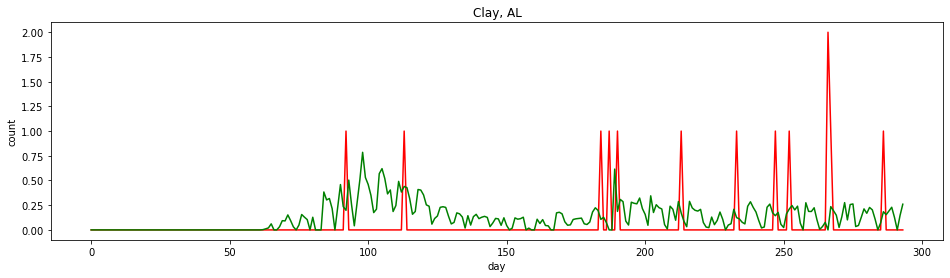

 57%|█████▋    | 34/60 [01:06<00:51,  2.00s/it]

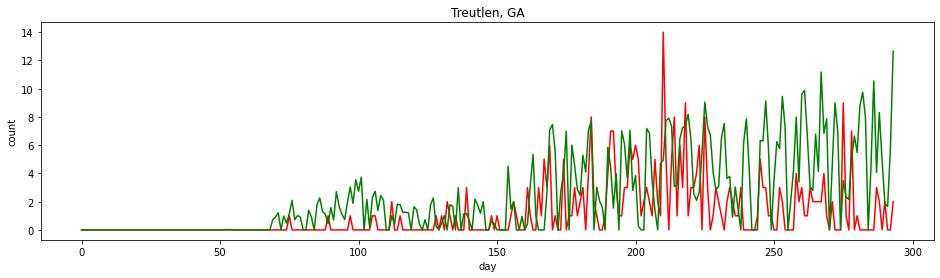

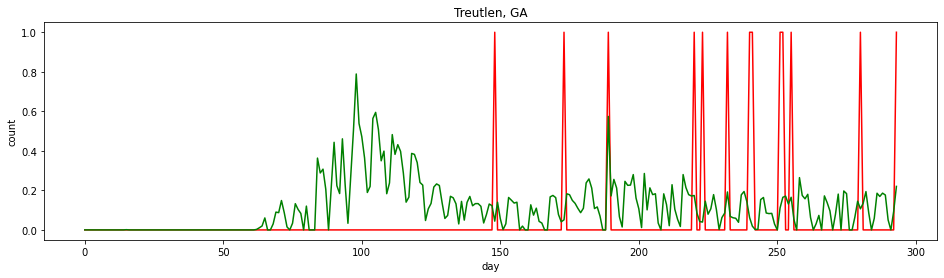

 58%|█████▊    | 35/60 [01:08<00:50,  2.03s/it]

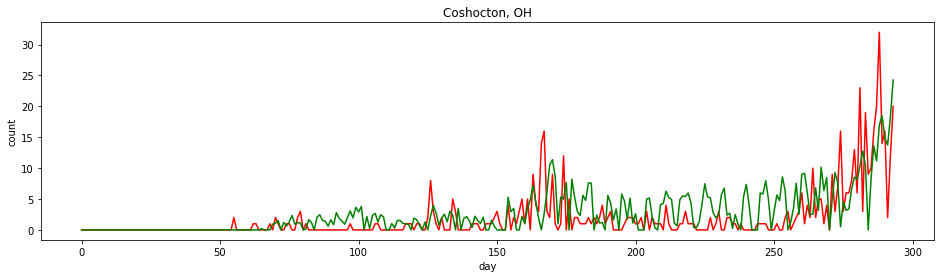

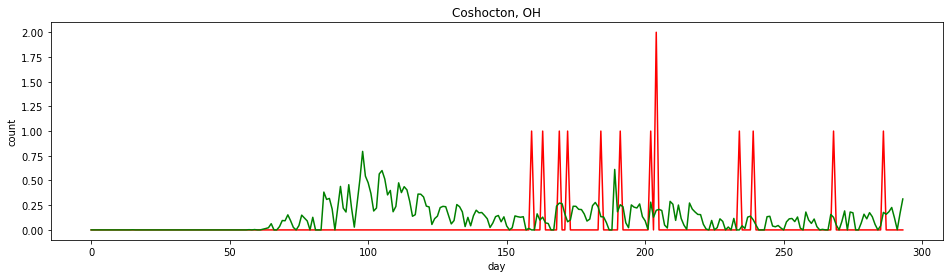

 60%|██████    | 36/60 [01:10<00:50,  2.11s/it]

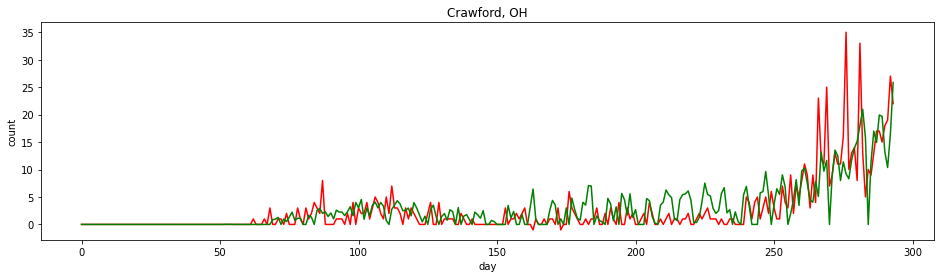

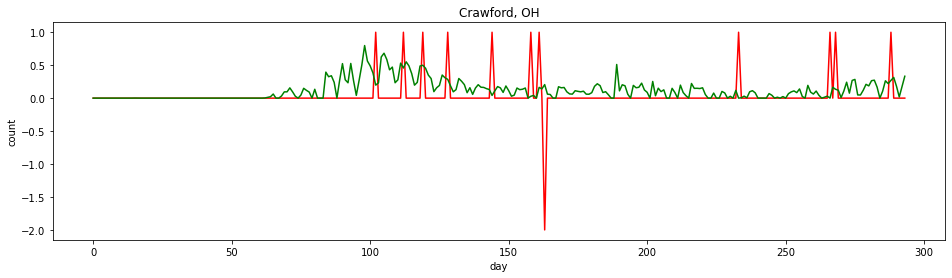

 62%|██████▏   | 37/60 [01:12<00:47,  2.08s/it]

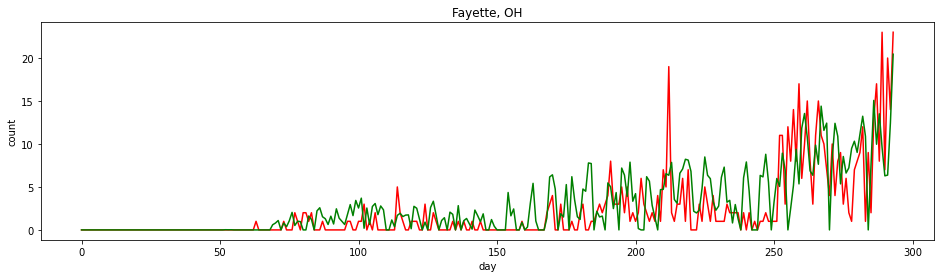

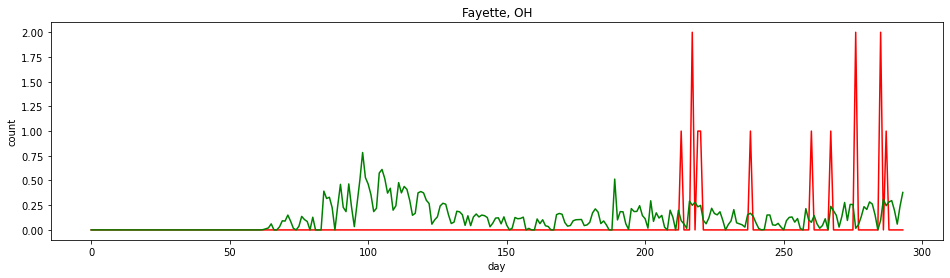

 63%|██████▎   | 38/60 [01:14<00:45,  2.06s/it]

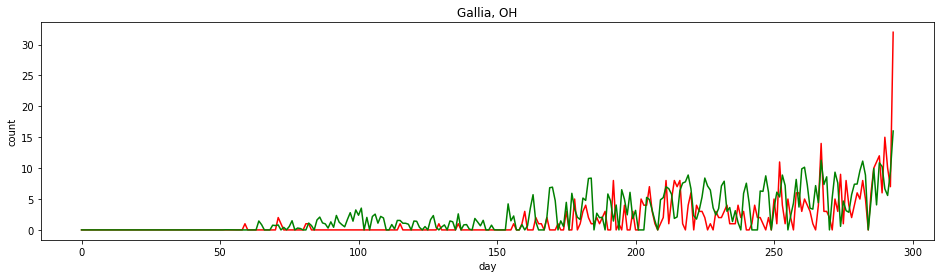

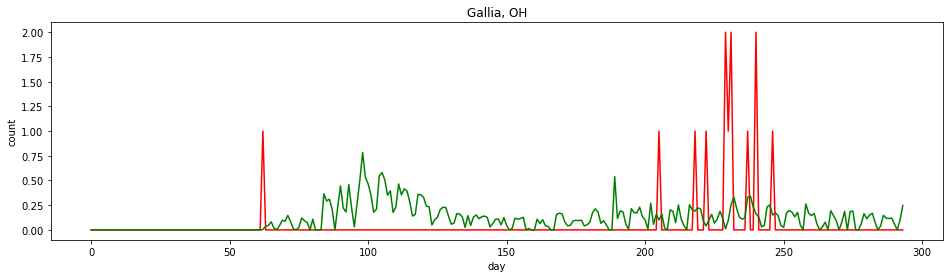

 65%|██████▌   | 39/60 [01:16<00:43,  2.06s/it]

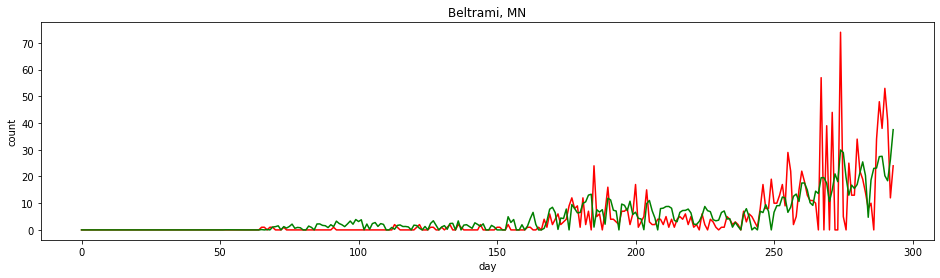

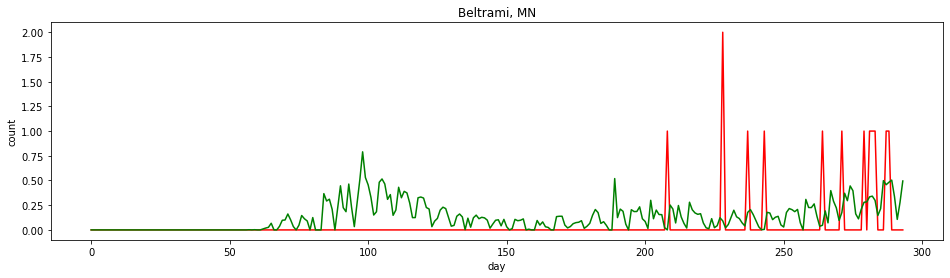

 67%|██████▋   | 40/60 [01:18<00:40,  2.05s/it]

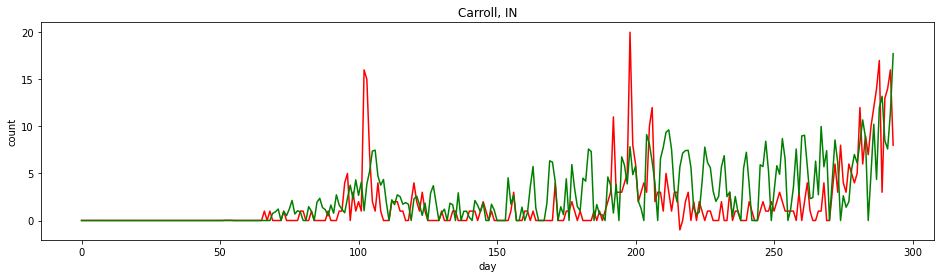

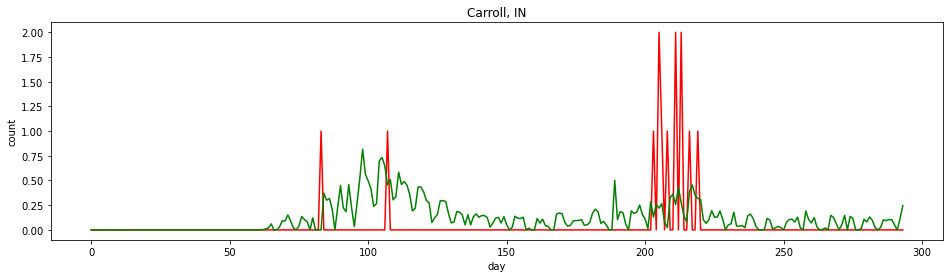

 68%|██████▊   | 41/60 [01:20<00:38,  2.01s/it]

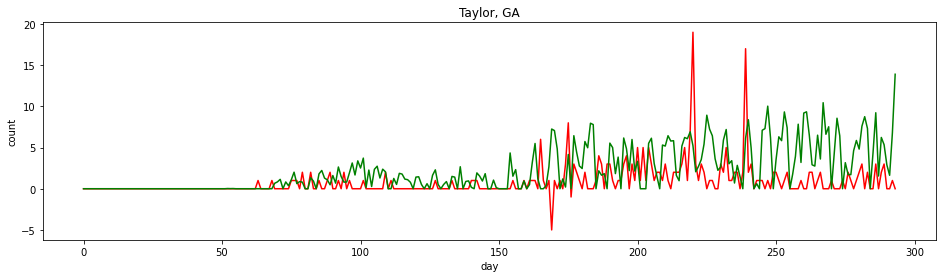

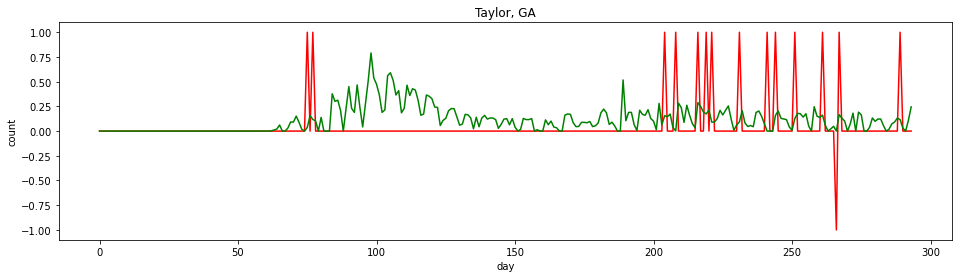

 70%|███████   | 42/60 [01:22<00:35,  1.99s/it]

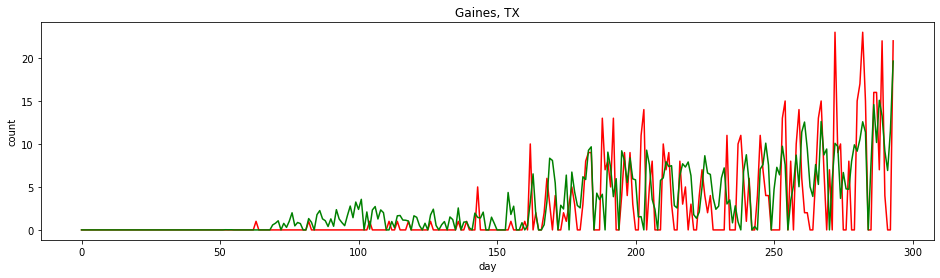

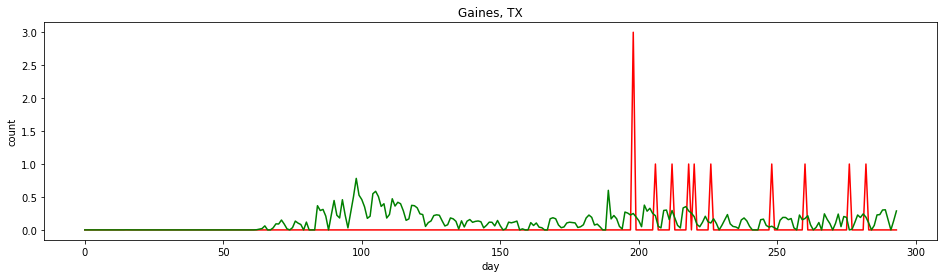

 72%|███████▏  | 43/60 [01:24<00:33,  1.99s/it]

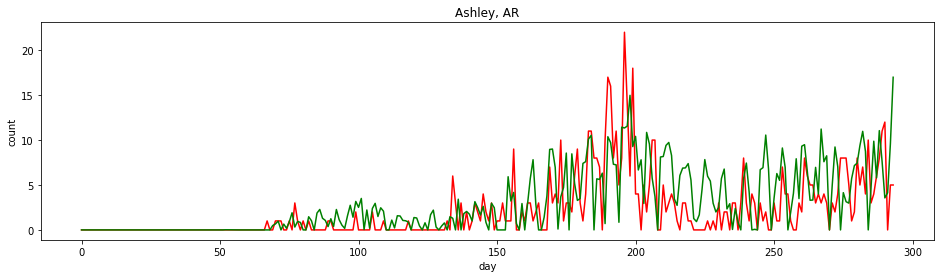

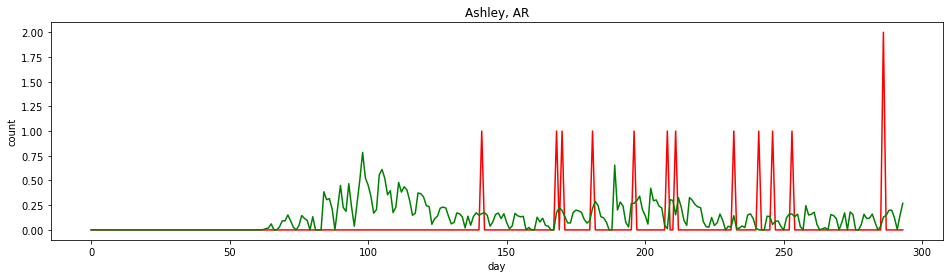

 73%|███████▎  | 44/60 [01:26<00:31,  1.99s/it]

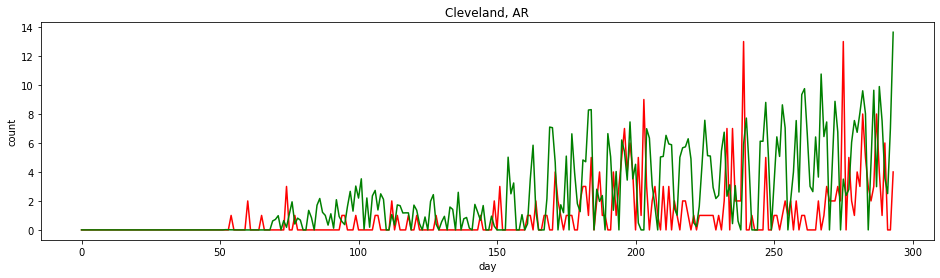

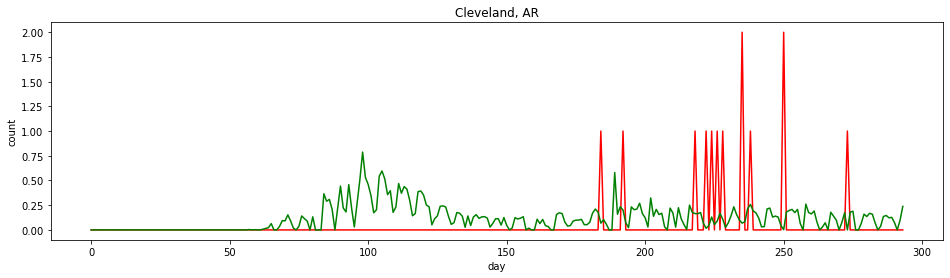

 75%|███████▌  | 45/60 [01:28<00:30,  2.02s/it]

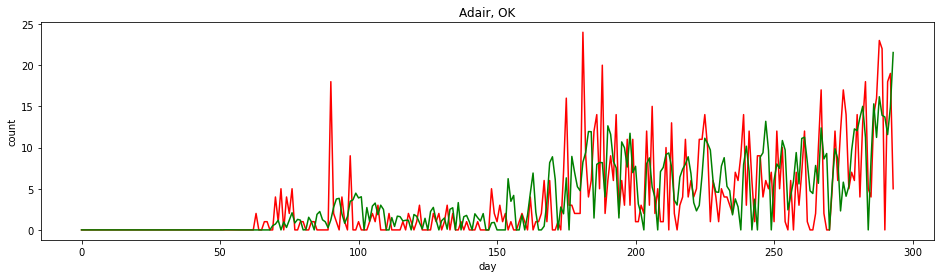

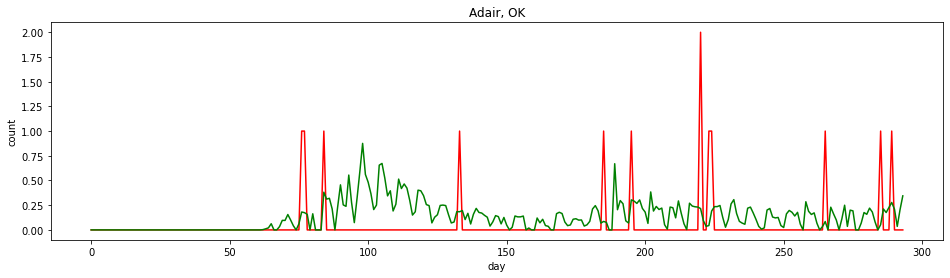

 77%|███████▋  | 46/60 [01:30<00:28,  2.01s/it]

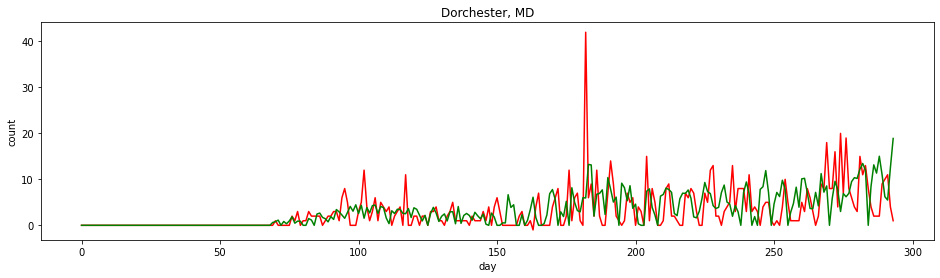

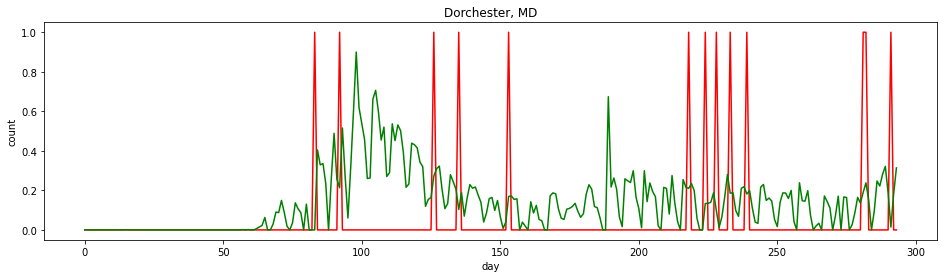

 78%|███████▊  | 47/60 [01:32<00:26,  2.03s/it]

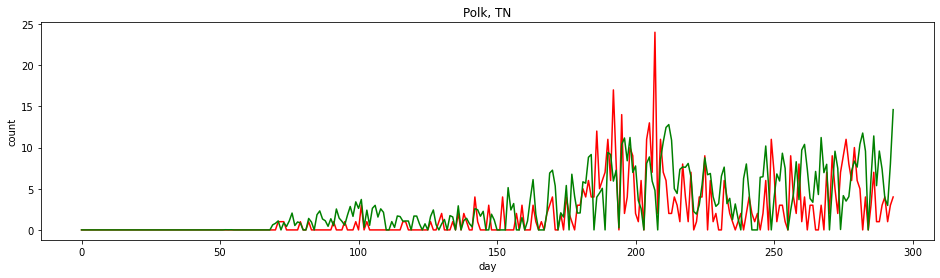

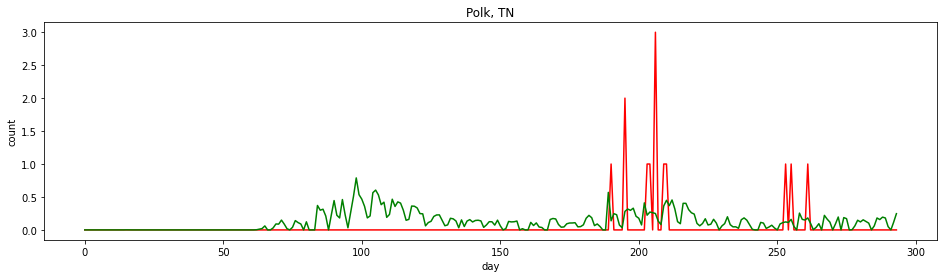

 80%|████████  | 48/60 [01:34<00:24,  2.04s/it]

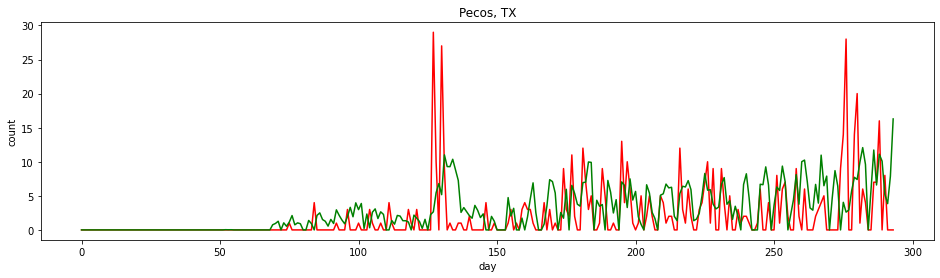

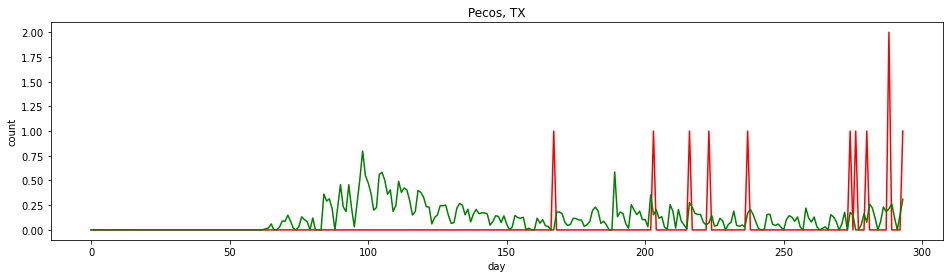

 82%|████████▏ | 49/60 [01:36<00:22,  2.04s/it]

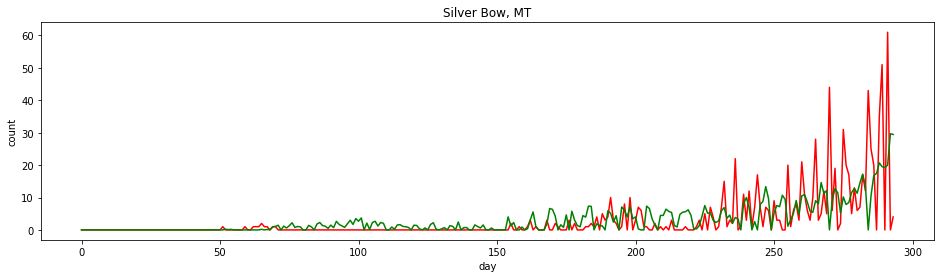

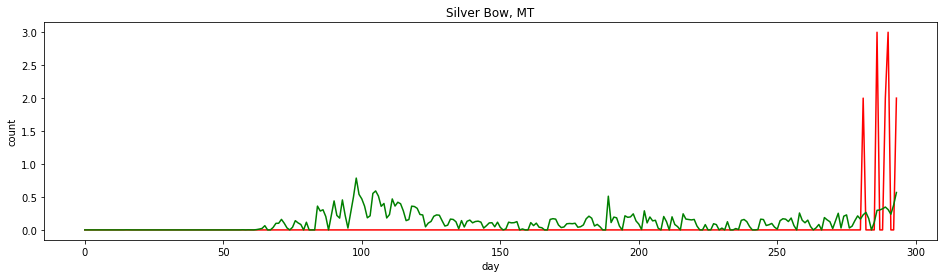

 83%|████████▎ | 50/60 [01:39<00:20,  2.05s/it]

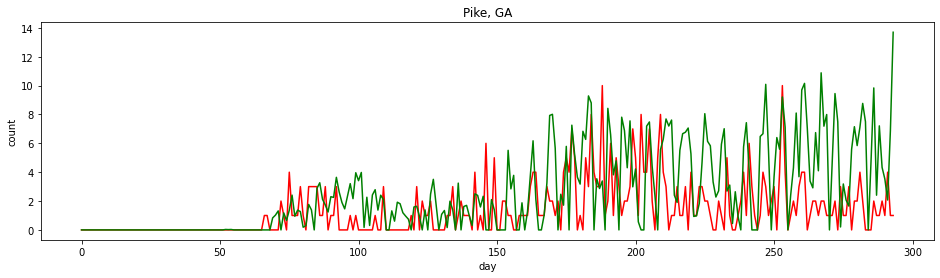

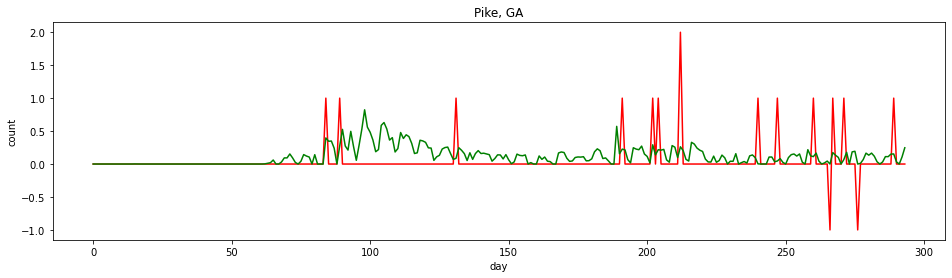

 85%|████████▌ | 51/60 [01:41<00:18,  2.07s/it]

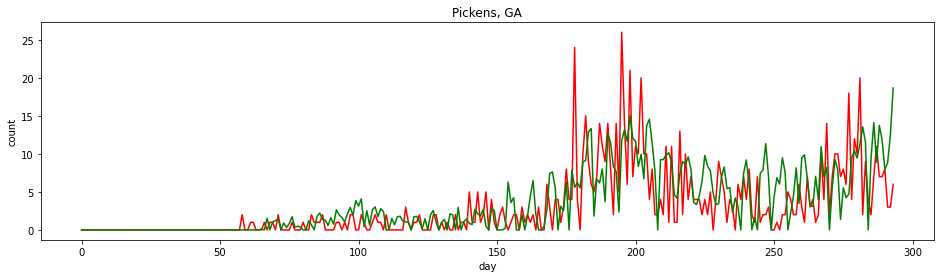

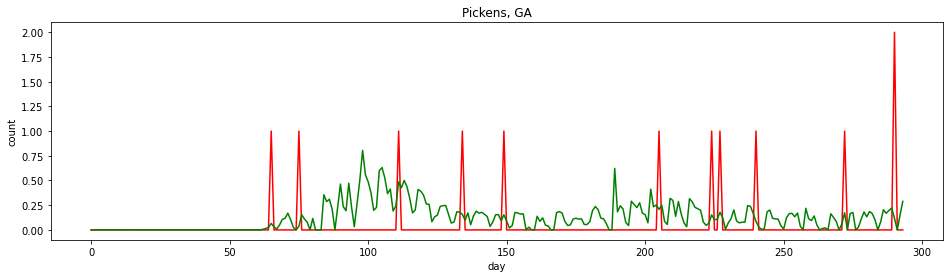

 87%|████████▋ | 52/60 [01:43<00:16,  2.09s/it]

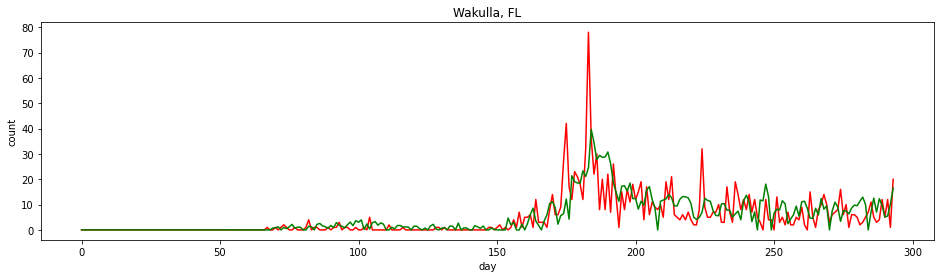

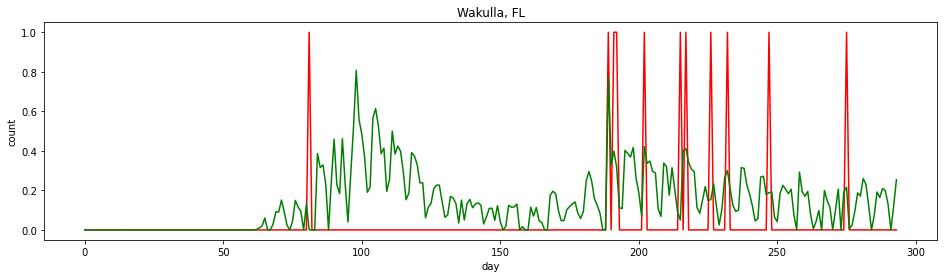

 88%|████████▊ | 53/60 [01:45<00:14,  2.12s/it]

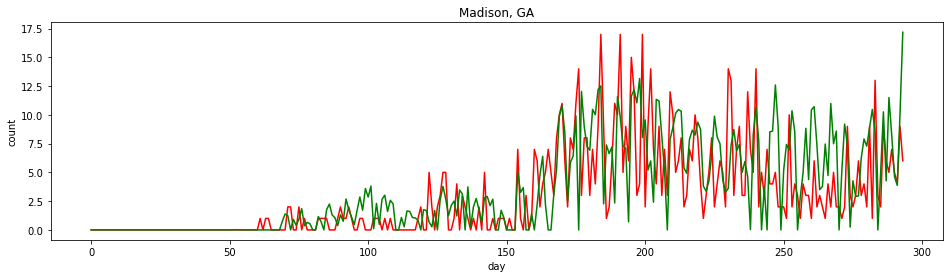

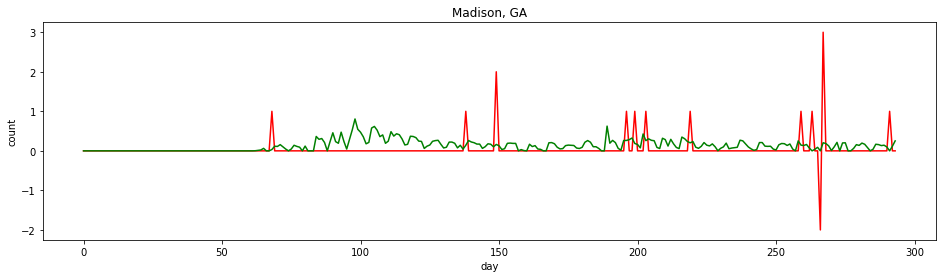

 90%|█████████ | 54/60 [01:47<00:12,  2.16s/it]

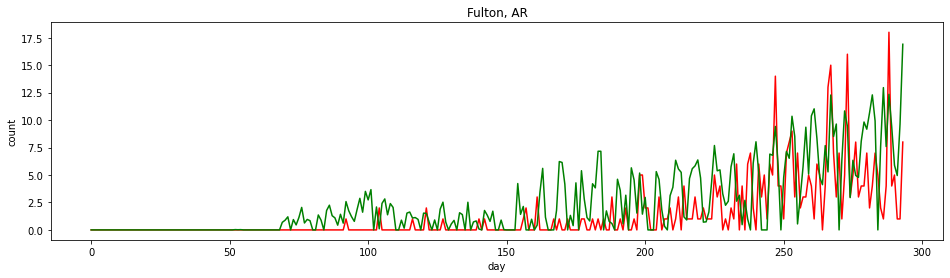

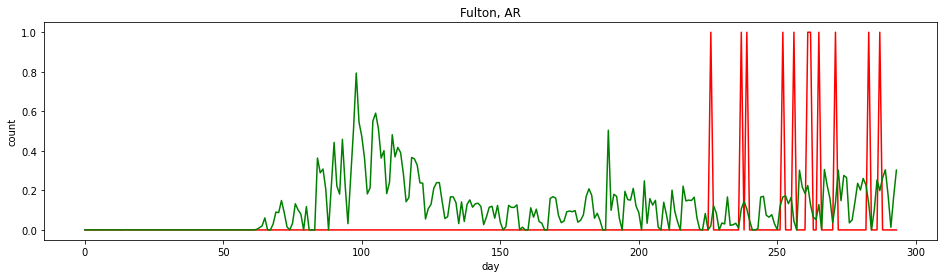

 92%|█████████▏| 55/60 [01:49<00:10,  2.13s/it]

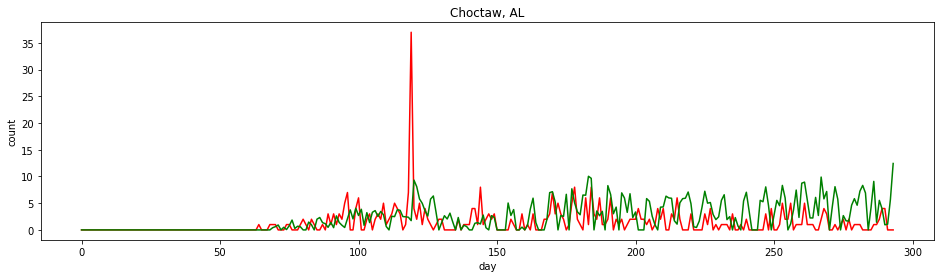

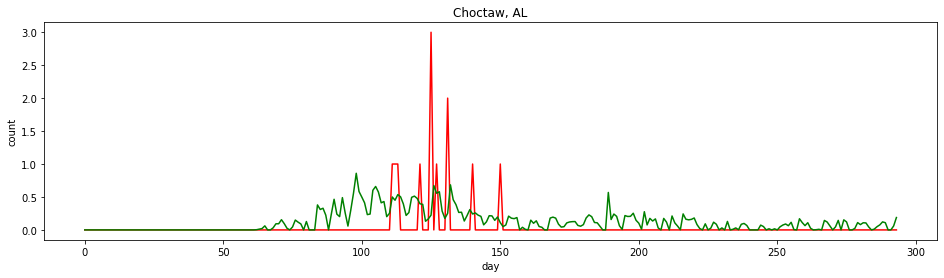

 93%|█████████▎| 56/60 [01:51<00:08,  2.12s/it]

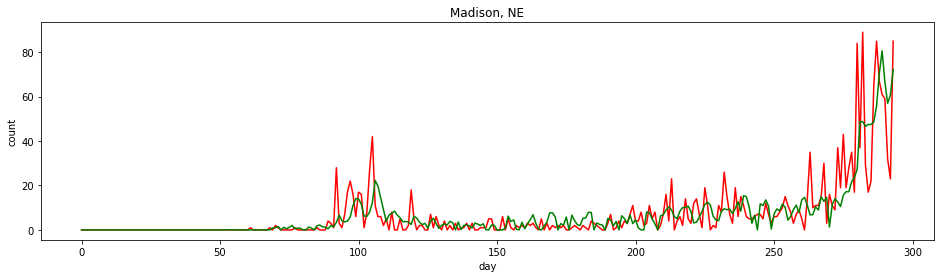

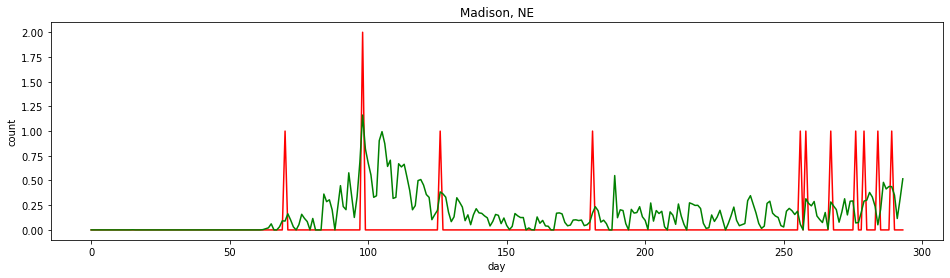

 95%|█████████▌| 57/60 [01:53<00:06,  2.08s/it]

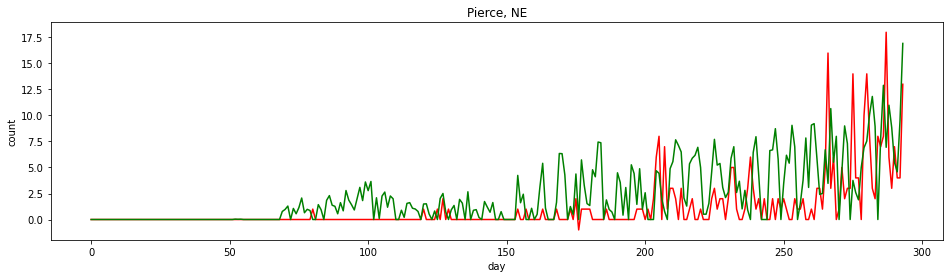

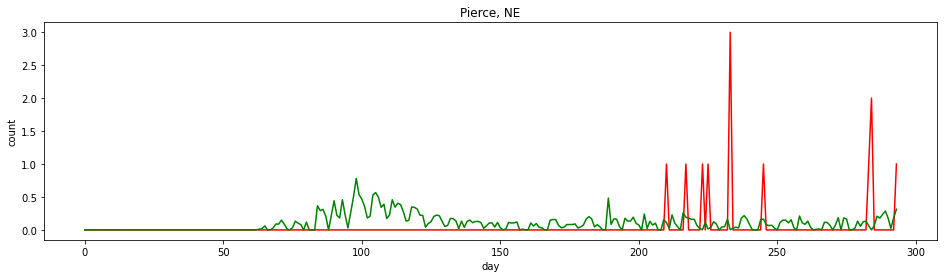

 97%|█████████▋| 58/60 [01:55<00:04,  2.08s/it]

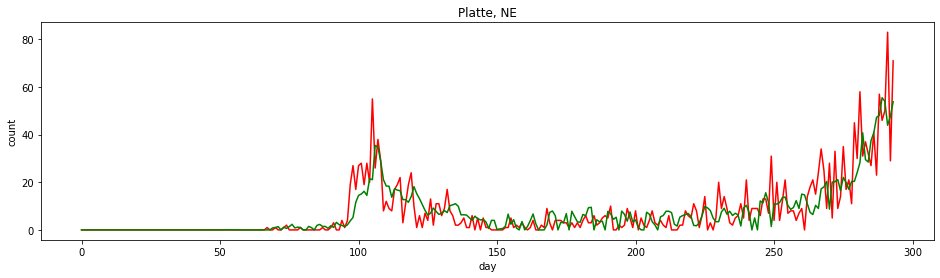

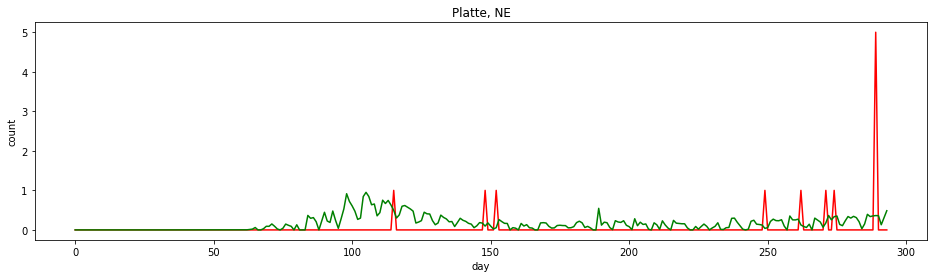

 98%|█████████▊| 59/60 [01:57<00:02,  2.06s/it]

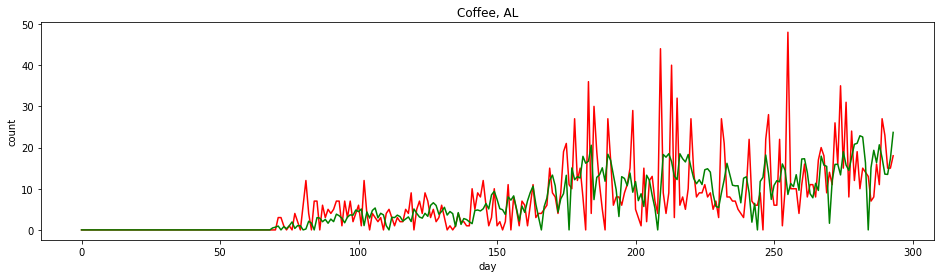

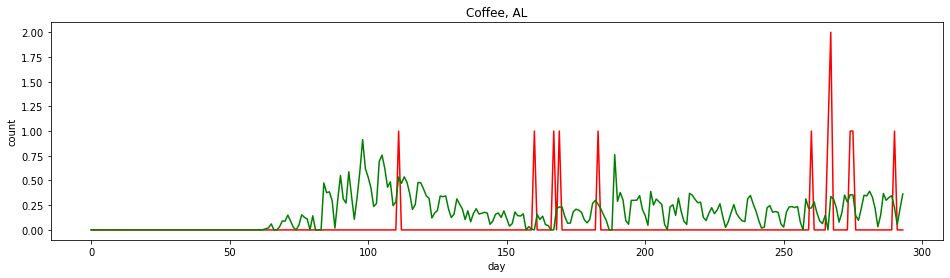

100%|██████████| 60/60 [02:00<00:00,  2.00s/it]


In [67]:
testcasesmse, testdeathsmse = evaluate(lstm, range(1550, 1610), plot=True)

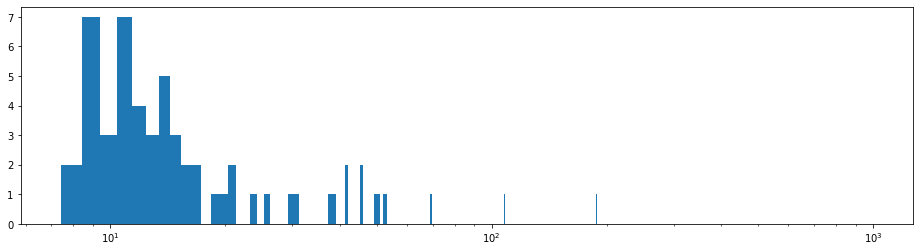

In [68]:
plt.figure(figsize=(16,4))
plt.gca().set_xscale('log')
plt.hist(testcasesmse, bins=1000)
plt.show()

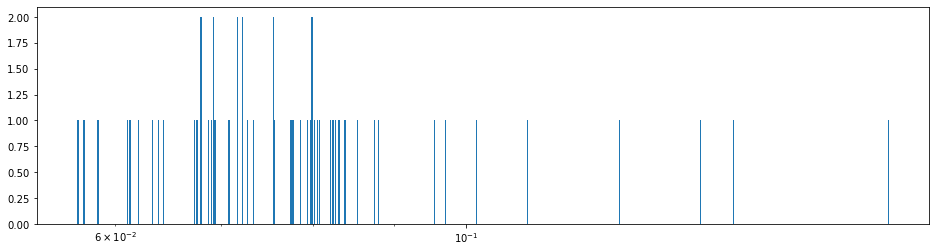

In [69]:
plt.figure(figsize=(16,4))
plt.gca().set_xscale('log')
plt.hist(testdeathsmse, bins=1000)
plt.show()

In [70]:
np.mean(testcasesmse)

53.527552639708226

In [72]:
np.mean(testdeathsmse)

0.08239233628962857

In [88]:
rnn=torch.load("./saved_models/rnn_predict_increase.model")

AttributeError: Can't get attribute 'RNN' on <module '__main__'>